# Chapter 12 - Multiple Objective Optimization


© 2021, 2022 Packt Publishing

Written by Alex Khan

In [1]:
# Enter the S3 bucket you created during onboarding in the code below
my_bucket = "amazon-braket-[your bucket]" # the name of the bucket
my_prefix = "[your folder]" # the name of the folder in the bucket
s3_folder = (my_bucket, my_prefix)

In [3]:
from braket.circuits import Circuit, Gate, Observable
from braket.devices import LocalSimulator
from braket.aws import AwsDevice, AwsQuantumTask
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
%matplotlib inline

In [4]:
import numpy as np
import pandas as pd


In [5]:
from scipy.optimize import minimize, curve_fit


In [6]:
# to check all gate operations refer to 
# https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

In [7]:
def available_devices():
    from braket.aws import AwsDevice
    device_list=AwsDevice.get_devices(statuses=['ONLINE'])
    device_name_list=[]
    for device in device_list:
        device_name_list.append(device.name)
    #print('Valid device names: ',device_name_list)
    return(device_name_list)

In [8]:
available_devices()

['Advantage_system4.1',
 'Advantage_system6.1',
 'Aspen-11',
 'Borealis',
 'DW_2000Q_6',
 'IonQ Device',
 'SV1',
 'TN1',
 'dm1']

In [9]:
def set_device(Name):
    device_list=AwsDevice.get_devices(names=Name)
    if len(device_list)==1:
        device=device_list[0]
        print(device)
        return(device)
    else:
        print('No device found')
        print('use name from list', available_devices())

In [10]:
### Please run available_devices() and correct any device names below

def estimate_cost(device,num_shots=1000):
    #device=set_device(Name)
    cost_per_task=0.30
    Name=device.name
    if Name in ['SV1','TN1','dm1']:
        price_per_min=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('simulator cost per ',unit,': $', price_per_min)
        print('total cost cannot be estimated')
    elif Name in['Advantage_system6.1','Advantage_system4.1','DW_2000Q_6','Aspen-M-1','Aspen-11','IonQ Device']:
        price_per_shot=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('device cost per ',unit,': $', price_per_shot)
        print('total cost for {} shots is ${:.2f}'.format(num_shots,cost_per_task+num_shots*price_per_shot))
    else:
        print('device not found')
        print('use name from list', available_devices())


In [11]:
# This function was modified with a return of num_shots
def estimate_cost_measured_qubits(device,measured_qubits):
    #device=set_device(Name)
    min_shots_per_variable=25
    max_shots=device.properties.service.shotsRange[1]
    print('max shots:', max_shots)
    num_shots=min_shots_per_variable*2**measured_qubits
    if num_shots>max_shots:
        num_shots=max_shots
        print('for {} measured qubits the maximum allowed shots: {:,}'.format(measured_qubits,num_shots))
    else:
        print('for {} measured qubits the number of shots recommended: {:,}'.format(measured_qubits,num_shots))
    estimate_cost(device,num_shots)
    return(num_shots)

In [12]:
def actual_simulator_cost(device, result):
        price_per_min=device.properties.service.deviceCost.price
        price_per_ms=price_per_min/60/1000
        unit=device.properties.service.deviceCost.unit
        duration_ms=result.additional_metadata.simulatorMetadata.executionDuration
        if unit=='minute':
            print('simulator cost per ',unit,': $', price_per_min)
            print('total execution time: ', duration_ms, "ms")
            print('total cost estimated: $',duration_ms*price_per_ms)

In [13]:
# this function has been updated from the function in past chapters
def run_circuit(circuit, shots, local=True, device_name='', s3_folder='', display_binary=False, disable_qubit_rewiring=False):
    import matplotlib.pyplot as plt
    %matplotlib inline
    if local==True:
        device = LocalSimulator()
        result = device.run(circuit, shots=shots).result()
    else:
        device=set_device(device_name)
        if shots==0:
            measured_qubits=len(circuit.qubits)
            num_reads=estimate_cost_measured_qubits(device,measured_qubits)
        else:
            num_reads=shots
        print('device', device)
        print('num reads', num_reads)
        if device_name=='Aspen-11' or device_name=='Aspen-M-1':
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder, disable_qubit_rewiring=disable_qubit_rewiring).result()
        else:
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder).result()
        if device_name in (['SV1','TN1']):
            actual_simulator_cost(device, result)
        else:
            estimate_cost(device, num_reads)
    counts = result.measurement_counts
    if display_binary==True:
        print(counts)
        plt.bar(int(counts.keys(),2), counts.values());
        plt.xlabel('states');
        plt.ylabel('counts');
    else:
        x_val=[]
        y_val=[]
        dec_counts={}
        for i in (counts.keys()):
            x_val.append(int(i,2))
        for i in (counts.values()):
            y_val.append(i)
        for i in range(len(x_val)):
            dec_counts[x_val[i]]=y_val[i]
        print(dec_counts)
        plt.bar(x_val, y_val)

        plt.xlabel('states');
        plt.ylabel('counts');
    
    return(result)

In [14]:
def draw_bloch(q, info=True):
    #©2021-2 Alex Khan
    
    import matplotlib.pyplot as plt
    import numpy as np

    if q.shape != (2,1):
        print('Matrix must be only for one qubit')
        print('Shape needed (2,1). Shape given ',q.shape)
        return
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_aspect("auto")
    if info==True:
        print('Matrix:')
        print(q)
    # draw Bloch Sphere
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x = np.cos(u)*np.sin(v)
    y = np.sin(u)*np.sin(v)
    z = np.cos(v)
    ax.plot_surface(x, y, z, color="y", alpha=0.2)

    u = np.linspace(0, 2* np.pi, 100)

    ax.plot(np.sin(u),np.cos(u),0*(u),color='y')
    ax.plot(0*(u),np.sin(u),np.cos(u),color='y')
    ax.plot(np.sin(u),0*(u),np.cos(u),color='y')

    # draw axes
    ax.plot([0,0],[1,-1],[0,0], color='y', linestyle='dotted')
    ax.plot([1,-1],[0,0],[0,0], color='y', linestyle='dotted')
    ax.plot([0,0],[0,0],[1,-1], color='y', linestyle='dotted')

    # draw state labels
    ax.annotate("|0>", xy=(0.0, 0.04), xytext=(0.0, 0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|1>", xy=(0.0, -0.04), xytext=(0.0, -0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|+>", xy=(-0.025, -0.022), xytext=(-0.06, -0.04), arrowprops=dict(arrowstyle="->"), color='y')

    # calculate vector
    
    r0=((q[0].real)**2+(q[0].imag)**2)**0.5
    #print('r0=',r0)
    if r0==0:
        phi0=0
    else:
    
        phi0=np.arccos(q[0].real/r0)
    
    r1=((q[1].real)**2+(q[1].imag)**2)**0.5
    #print('r1=',r1)
    if r1==0:
        phi1=0
    else:
    
        phi1=np.arccos(q[1].real/r1)
    r=(r0**2+r1**2)**0.5
    
    if(r<0.999 or r>1.0001):
        print('vector is  not normalized.  Cannot draw')
        return
    
    if np.sin(q[1].imag)<0:
        s1=-1
    else:
        s1=+1#

    if np.sin(q[0].imag)<0:
        s0=-1
    else:
        s0=+1
    

    #print('phi1',phi1,'phi0', phi0)
    phi=s1*phi1-s0*phi0   


    theta=2*np.arccos((q[0].real**2+q[0].imag**2)**0.5)
    
    v_x = np.cos(phi)*np.sin(theta)
    v_y = np.sin(phi)*np.sin(theta)


    v_z = np.cos(theta)
    v_z2= np.sin(theta)
    #print('theta',theta, 'phi',phi)

    #print('vx=cos(phi)',np.cos(phi), 'x sin(theta)', np.sin(theta),'= ',v_x)
    #print('vy=sin(phi)',np.sin(phi), 'x sin(theta)', np.sin(theta),'= ',v_y )
    #print('vz=cos(theta)', v_z)
    
    # print state
    if info==True:
        print(' ')
        print('State Vector: |psi> = sqrt(', q[0].real**2+q[0].imag**2, ') |0> + ( sqrt(', q[1].real**2+q[1].imag**2,')) e^i', phi/np.pi,'pi |1>')
        print(' ')
    # draw vector
    ax.quiver(0,0,0,v_y, -v_x, v_z, color='r')
    #print('cartesian coordinates on Bloch Sphere')
    #print(v_x, v_y, v_z)
    plt.axis('off')
    fig.set_size_inches(7, 7)
    #ax.view_init(10, 10, 10)
    #print('Bloch Sphere:')
    plt.show()
    return(q)

In [15]:
def draw_circuit(circ, info=True):
    # this function is only for one qubit and draws the Bloch sphere
    circ=circ.state_vector()
    if info==True:
        print(circ)
    device = LocalSimulator()
    result = device.run(circ).result()
    arr_r=np.array([[result.values[0][0]],[result.values[0][1]]])
    draw_bloch(arr_r, info)

In [16]:
def qft_gate(qc,qubits_needed):
    
    power=0

    for target in range(qubits_needed-1,-1,-1):
        qc.h(target)
        for control in range(target-1,-1,-1):
 
            power=target-control

            qc.cphaseshift(control, target, (np.pi/(2**(power))))


    #reverse qubits

    #for i in range (int(qubits_needed/2)):
        
        #qc.swap(i,qubits_needed-i-1)
    return(qc)

In [17]:
def qft_inv_gate(qc, qubits_needed, q_start=0):
    
    power=0

    for target in range(0,qubits_needed):
        
        for control in range(0,target):

            power=target-control

            qc.cphaseshift(control+q_start, target+q_start, -(np.pi/(2**(power))))
        
        qc.h(target+q_start)
    
    for i in range (int(qubits_needed/2)-1,-1,-1):
        
        qc.swap(i+q_start,qubits_needed-i-1+q_start)

    return(qc)

In [18]:
def draw_multi_qubit_phase(Qubits, Number, add_hadamard=True):

    b_Number=format(Number, '0'+str(Qubits)+'b')

    print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number)
    # qc builds the full circuit 
    # circ is only a qubit by qubit model for showing the bloch sphere
    qc=Circuit()
    for q in range(Qubits):
        print('qubit',q)
        circ=Circuit().h(0)
        
        if add_hadamard==True:
            qc=qc.h(q)
        p=0
        for i in range(Qubits-q-1,Qubits):

            if b_Number[i]=='1':
                circ.phaseshift(0,np.pi/(2**p))
                qc.phaseshift(q,np.pi/(2**p))

            p+=1
        # draw the bloch sphere for each qubit
        draw_circuit(circ, False) 
    return(qc)
        
        
    

In [19]:
def qc_num(num, qubits_needed):
    qubits_format='0'+str(qubits_needed)+'b'
    n_bin=format(num, qubits_format)

    qubits_needed=len(n_bin)

    qc=Circuit()
    for i in range(qubits_needed):
        if n_bin[i]=='1':
            #reverse number
            #qc.x(qubits_needed-i-1)
            qc.x(qubits_needed-i-1)


    return(qc)

In [20]:
def add_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,np.pi/(2**p))

            p+=1

    return(qc)

In [21]:
def subtract_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,-np.pi/(2**p))

            p+=1

    return(qc)

In [22]:
def matrix_to_polynomial(objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    #extra_qubits={}
    #r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    return(eq)

In [23]:
def multi_qubit_polynomial(Qubits, objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    extra_qubits={}
    r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    extra_qubits[(i,j)]=r2
                    r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    extra_qubits[(i,j)]=r2
                    r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    # starting qubit for register 2

    q_start=r2

    qc=Circuit()

    #qc=qc.x(1).x(0)
    qc=qc.h(np.arange(len_r1))


    for q in range(Qubits):
        qc=qc.h(q+q_start)


    for i in range (len_r1):
        if objective[i,i]<0:
            qc=subtract_coefficient(qc, q_start, Qubits, i, objective[i,i])
        elif objective[i,i]>0:
            qc=add_coefficient(qc, q_start, Qubits, i, objective[i,i])
    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:
                if objective[i,j]<0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=subtract_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])
                elif objective[i,j]>0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=add_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])

    qc=qft_inv_gate(qc, Qubits, q_start ) 

    
    return(qc, len_r1, q_start)

In [24]:
def plot_results_mc(counts):

    figure(figsize=(10, 6), dpi=100)

    len1=len(objective)
    print('valid values',-max_val/2,'to',max_val/2)
    x_val=[]
    y_val=[]
    cost=[]
    #print(len1,Qubits)
    for val in zip(counts.values(), counts.keys()):
        result=int(val[1][q_start:q_start+Qubits],2)
        #print(val[1], val[1][0:len1], result, val[0])
        if result <= max_val/2:


            x_val.append(str(val[1][0:len1])+'('+str(result)+')')
            y_val.append(val[0])
            cost.append(result)
        else:
            x_val.append(str(val[1][0:len1])+'('+str(result-max_val)+')')
            y_val.append(val[0])
            cost.append(result-max_val)        

    sort_index = np.argsort(cost)
    x_val = [x_val[i] for i in sort_index]
    y_val = [y_val[i] for i in sort_index]
    cost = [cost[i] for i in sort_index]

    print('from lowest to highest value')
    print('input (cost) count')
    print('-----  ----- -----')
    for i in range(len(x_val)):
        print(x_val[i], y_val[i])
    
    plt.bar(x_val, y_val)
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.xticks(rotation = 89) # Rotates X-Axis Ticks by 45-degrees
    plt.show()

In [25]:
def sum_energy(Q,array):
    vals=[]
    for i in range(len(array)):
        if array[int(i)]=='1':
            vals.append(i)
            
    sum=0
    #print(vals)
    for i in (vals):
        sum+=Q[int(i),int(i)]
    for i in (vals):
        for j in (vals):
            if i<j:
                sum+=Q[int(i),int(j)]
    return(sum)
            
    

In [26]:

def param_optimizer(param1, param2, Q, shots):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))


    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            qc=qc.x(range(len(Q))).h(range(len(Q)))
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            device = LocalSimulator()
            result = device.run(qc, shots=shots).result()
            counts = result.measurement_counts

            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    #sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    sns.heatmap(D, 
            annot=True, 
            xticklabels=[f'{x:.0}' for x in param2], 
            yticklabels=[f'{x:.0}' for x in param1],  
            linewidths=.5, 
            cmap="YlGnBu", 
            annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [27]:
def param_optimizer_device(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))

    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, True)
            counts = result.measurement_counts
            
            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    #sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    sns.heatmap(D, 
            annot=True, 
            xticklabels=[f'{x:.0}' for x in param2], 
            yticklabels=[f'{x:.0}' for x in param1],  
            linewidths=.5, 
            cmap="YlGnBu", 
            annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [28]:
def schedule_task(qc, shots, device):
    if device.name=='Aspen-M-1' or device.name=='Aspen-11':
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60, disable_qubit_rewiring=disable_qubit_rewiring)
    else:
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60)
    qc_status = qc_task.state()
    print('ID of task:', qc_task.id)
    print('Status of task:', qc_status)
    
    # to retrieve task use
    # results, metadata, counts=recover_task_sum(qc_task_id)
    return(qc_task.id)

In [29]:
def recover_task(task_id):
    # recover task
    task_load = AwsQuantumTask(arn=task_id)

    # print status
    status = task_load.state()
    #print('Status of (reconstructed) task:', status)

    # wait for job to complete
    # terminal_states = ['COMPLETED', 'FAILED', 'CANCELLED']
    if status == 'COMPLETED':
        # get results
        results = task_load.result()
        # print(rigetti_results)

        # get all metadata of submitted task
        metadata = task_load.metadata()
        # example for metadata
        shots = metadata['shots']
        machine = metadata['deviceArn']
        # print example metadata
        print("{} shots taken on machine {}.".format(shots, machine))

        # get measurement counts
        counts = results.measurement_counts
        #print('Measurement counts:', counts)

        return(results, metadata, counts)
       
       

    elif status in ['FAILED', 'CANCELLED']:
        # print terminal message 
        print('Your task is in terminal status, but has not completed.')

    else:
        # print current status
        print('Sorry, your task is still being processed and has not been finalized yet.')

In [30]:
def schedule_optimize_bqm_task(param1, param2, Q, shots, device):
    
    qc=Circuit()
    for i in range(len(Q)):
        if Q[i,i]!=0:
            #print(i,Q[i,i])
            qc=qc.x(i).h(i)
    #qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        if device.name=='Aspen-11' or device.name=='Aspen-M-1':
                            qc=qc.cnot(i, j).rz(j, param1[p]*Q[i,j]).cnot(i, j)
                        else:
                            qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rx(i,2*param2[p])
    
    qc_task_id=schedule_task(qc, shots, device)
    
    return(qc_task_id)


In [31]:
# |0> state
arr_0=np.array([[1+0j],[0+0j]])
# |1> state
#arr_1=np.array([[0],[1]])
arr_1=np.array([[0+0j],[1+0j]])


# i operator
arr_i=np.array([[1,0],[0,1]])
# x operator
arr_x=np.array([[0,1],[1,0]])
# y operator
arr_y=np.array([[0,-1j],[1j,0]])
# z opeator
arr_z=np.array([[1,0],[0,-1]])
# h operator
arr_h=(1/np.sqrt(2))*(np.array([[1, 1],[1, -1]]))
# t operator
arr_t=np.array([[1,0],[0,np.exp(1j*np.pi/4)]])
# s operator
arr_s=np.array([[1,0],[0,np.exp(1j*np.pi/2)]])

In [32]:
def func_bqm(x):
    # This function is used by the scipy optimizer
    # It takes a matrix Q and returns the lowest energy found for a single set of parameters in x
    # It allows scipy to find the optimal single set of parameters
    #
    global Q
    global shots
    global param1_list
    global param2_list
    global min_value_list
    global quantity_list
    global solution_list
    global SV
    param1=x[0]
    param2=x[1]
    sum=0
    qc=Circuit()
    
    Qubits=len(Q)
    qc=qc.x(range(Qubits)).h(range(Qubits))
    for i in range(Qubits):
        if Q[i,i]!=0:
            qc=qc.rz(i,-2*param1*Q[i,i])
    for i in range (Qubits):
        for j in range (Qubits):
            if i<j:
                if Q[i,j]!=0:
                    qc=qc.zz(i,j,2*param1*Q[i,j])
    for i in range(len(Q)):
        qc=qc.rx(i,2*param2)
    
    device = LocalSimulator()
    solution=[]
    quantity=[]
    energy=[]
    
    if SV==True:
        qc=qc.state_vector()
        result = device.run(qc, shots=0).result()
        #print(result.values)
        counter=0
        for res in (result.values[0]):
            quantity.append(abs(res)**2)
            keys=format(counter, '0'+str(Qubits)+'b')
            #print(keys)
            solution.append(keys)
            counter+=1
            energy.append(sum_energy(Q,keys))

    else:
        result = device.run(qc, shots=shots).result()
        counts = result.measurement_counts

        for keys,values in zip(counts.keys(),counts.values()):
            solution.append(keys)
            quantity.append(values)
            energy.append(sum_energy(Q,keys))
    
    index=np.argsort(energy)
    param1_list.append(param1)
    param2_list.append(param2)
    min_value_list.append(energy[index[0]])
    solution_list.append(solution[index[0]])
    quantity_list.append(quantity[index[0]])
    return(energy[index[0]])

In [33]:
def optimize_bqm(param1, param2, Q, shots):
    # This function optimizes 
    qc=Circuit()
    qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            qc=qc.rx(i,2*param2[p])


    device = LocalSimulator()
    result = device.run(qc, shots=shots).result()
    counts = result.measurement_counts
    solution=[]
    quantity=[]
    energy=[]
    for keys,values in zip(counts.keys(),counts.values()):
        solution.append(keys)
        quantity.append(values)
        energy.append(sum_energy(Q,keys))
    energy_np=np.array(energy)
    index=np.argsort(energy)
    
    figure(figsize=(10, 6), dpi=100)
    plt.title('param1:'+str(param1)+' param2:'+str(param2))
    plt.xlabel('cost')
    #plt.xlim(-3, 8)
    plt.ylabel('occurrence')
    #plt.ylim(0,2700)
    plt.scatter(energy,quantity)

    plt.show()
    return(solution[index[0]],energy[index[0]],quantity[index[0]])


In [34]:
def ProbabilisticSampler(Q,plot_limit,offset=0, min_limit=0, max_limit=0):
    #(C) 2021, 2022 Alex Khan 

    
    from itertools import combinations
    import numpy as np
    import pandas as pd
    import random
    import math
    import matplotlib.pyplot as plt
    
    def nCr(n,r):
        f = math.factorial
        return int(f(n) / f(r) / f(n-r))
    
    def random_combination(iterable, r):
        "Random selection from itertools.combinations(iterable, r)"
        pool = tuple(iterable)
        n = len(pool)
        indices = sorted(random.sample(range(n), r))
        return list(tuple(pool[i] for i in indices))
    
    def sum(i_list, Q):
        sum_lq=0

        for i in (i_list):
            for j in (i_list):
                
                sum_lq+=Q[i][j]
            
        return(sum_lq+offset)
    
    
    N=len(Q[0])
    if max_limit==0:
        max_limit=N
    t= (2**N)-1
    
    e_min=9999999
    count=0
    min_list=[]
    plot_data=[]
    x_label=[]
    comb_list=[]
    for n in range(min_limit,max_limit+1):  # for groups of items from 1 to N
        comb=nCr(N,n)
        comb_list.append(comb)
        #print('--m ', m, comb)
        if comb>plot_limit:
            combf=plot_limit
        else:
            combf=comb
                
        for i in range (combf):
            i_list=random_combination(range(N), n)
            plot_data.append(sum(list(i_list),Q))
            x_label.append(n)
            
            if sum(list(i_list),Q)<e_min:  

                    e_min=sum(list(i_list),Q)  
                    min_count=n
                    min_list=list(i_list)
                    
                    #print(list(i_list), sum(list(i_list),Q))
            count+=1
    #plt.plot(x_label,plot_data)
    figure(figsize=(10, 6), dpi=100)
    plt.scatter(x_label,plot_data,s=1)
    plt.ylabel('Energy')
    plt.show()
    
    print('Best found:', min_list)
    print('count:', min_count)
    print('Energy:', e_min)
    print('Solutions Sampled:', count)
    #print('Total Possible solutions:', comb_list)
    return min_list, e_min, comb_list

In [35]:
#############################

In [36]:
def run_dwave(Q,strength):
    from braket.aws import AwsDevice
    from braket.ocean_plugin import BraketSampler, BraketDWaveSampler
    from dwave.system.composites import EmbeddingComposite
    import dimod 
    # device
    #DWave_device='DW_2000Q_6' #if using 2000Q
    DWave_device='Advantage_system6.1' #if using advantage
    #DWave_device='Advantage_system4.1' #if using advantage    
    device =AwsDevice.get_devices(names=DWave_device)[0]
    
    # sampler properties
    sampler = BraketDWaveSampler(s3_folder,device.arn)
    sampler = EmbeddingComposite(sampler)
    max_shots=device.properties.service.shotsRange[1]
    print('Number of qubits: ', device.properties.provider.qubitCount)
    print('Number of couplers', len(device.properties.provider.couplers))
    print('Shots max {:,}'.format(max_shots) )
    
    #Estimate cost and shots
    dim=len(Q)
    shots=25*2**dim
    print(shots)
    if shots>max_shots:
        shots=max_shots
    price_per_shot=device.properties.service.deviceCost.price
    print('Recommended shots', shots)
    print('Estimated cost ${:.2f}'.format(0.3+price_per_shot*shots))
    
    # create BQM
    linear={i:Q[i][i] for i in range(dim)}
    quadratic={(i,j):Q[i][j] for i in range(dim) for j in range(dim) if i<j}
    
    vartype = dimod.BINARY
    bqm = dimod.BinaryQuadraticModel(linear, quadratic, vartype)
    
    # Note: reduce shots if you want to reduce costs
    shots=shots
    # from 0.5 to 2.2
    chain_strength = strength
    
    # run sampler
    response = sampler.sample(bqm, num_reads=shots, chain_strength=chain_strength)
                              
    print(response)
                              
    solution=""
    for i in response:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    print('decimal equivalent:',int(solution,2))
                              
    print('Validate energy',sum_energy(Q,solution))
    return(response)

In [37]:
def run_neal(Q):
    import neal
    import dimod 
    Nsampler = neal.SimulatedAnnealingSampler()
    QDWaveSA = dimod.BinaryQuadraticModel(Q, dimod.BINARY)
    SAresponse = Nsampler.sample(QDWaveSA)
    for SAsample in SAresponse.data():
        print( SAsample)
    solution=""
    for i in SAresponse:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    #print(int(solution,2))
    return(solution)

In [38]:
def generate_matrix(Qubits):
    #Generate a fixed matrix for desired number of Qubits
    import pandas as pd
    E = pd.read_csv("100x100.csv", header=None ).values
    if (len(E[0])==len(E[1])):
        dim=len(E)
        print(dim)
    Q=np.zeros((Qubits,Qubits))
    count=0
    for i in range(Qubits):
        for j in range(Qubits):
            if i<j:
                Q[i,j]=E[i,j]
            elif i==j:
                Q[i,j]=-E[i,j]
    return(Q)

In [39]:
def reverse(bitstring):
    return(bitstring[::-1])

In [40]:
def import_file(dat_file_name):
    import pandas as pd
    df = pd.read_csv(data_file_name, header=None)
    df.columns = ['value', 'weight']
    print(df)

    v=df['value']
    w=df['weight']
    return(v,w)

In [41]:
def plot_knapsack(file_name,w_capacity):
    from itertools import combinations
    import numpy as np
    import matplotlib.pyplot as plt
    
    def sum(i_list, p):
        sum_p=0
        for item in (i_list):
            sum_p+=p[item]
        return(int(sum_p))
    
    v,w=import_file(file_name)
    N=len(v)
    v_max=0
    w_max=0
    max_list=[]
    
    plot_w=[]
    plot_v=[]
    plot_wc=[]
    plot_vc=[]
    
    for n in range(1,N):  # for groups of items from 1 to N
        for i_list in combinations(np.arange(N), n): # allcombinations of n items

            plot_v.append(sum(list(i_list),v))  
            plot_w.append(sum(list(i_list),w))  
            #print(list(i_list),sum(list(i_list),v), sum(list(i_list),w))
            
            if sum(list(i_list),w)<=w_capacity: # if the weight of the current list of items is within the weight capacity

                plot_vc.append(sum(list(i_list),v))  
                plot_wc.append(sum(list(i_list),w))                
                
                if sum(list(i_list),v)>v_max:  # if the value of the current list of items is more than the max cost found so far
                    v_max=sum(list(i_list),v)  #c_max updated the cost of the current list of items
                    w_max=sum(list(i_list),w)  #w_max upated to the weifht of the current items
                    max_list=list(i_list)
                    print(list(i_list), sum(list(i_list),v),sum(list(i_list),w))

    figure(figsize=(10, 6), dpi=100)
    plt.plot(plot_v)
    plt.ylabel('value without constraint')
    plt.show()
    figure(figsize=(10, 6), dpi=100)
    plt.plot(plot_w)
    plt.ylabel('weight without constraint')
    plt.show()
    figure(figsize=(10, 6), dpi=100)                
    plt.plot(plot_vc)
    plt.ylabel('value with constraint')
    plt.show()
    figure(figsize=(10, 6), dpi=100)
    plt.plot(plot_wc)
    plt.ylabel('weight with constraint')
    plt.show()
    
    print('max value:',v_max, 'weight used:',w_max)
    print('items included:',max_list)
    return

In [42]:
def quantum_device_sampler(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))
    solution=[]
    quantity=[]
    energy=[]
    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            #print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, False)
            counts = result.measurement_counts
            

            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
                #print(keys, values, sum_energy(Q,keys))
    
    index=np.argsort(energy)

    return(solution, quantity, energy, index)

In [43]:
def knapsack_QUBO(value, weight, weight_capacity):

    N=len(value)
    Mv = np.zeros([N,N],dtype=float)
    for i in range(N):
        Mv[i][i] =-value[i]
    N=len(value)
    Mx = np.zeros([N,N],dtype=float)
    for i in range(N):
        for j in range(N):
            if i==j:
                Mx[i][i] =weight[i]**2
            elif i<j:
                Mx[i][j]=2*weight[i]*weight[j]
    wc=weight_capacity
    Myc = np.zeros([wc,wc],dtype=float)
    for i in range(wc):
        for j in range(wc):
            if i==j:
                Myc[i][i] =-1
            elif i<j:
                Myc[i][j]=2
    wc=weight_capacity
    My = np.zeros([wc,wc],dtype=float)
    for n in range(1,wc+1):
        for m in range(1,wc+1):
            if n==m:
                My[n-1][m-1] =n**2
            elif n<m:
                My[n-1][m-1] =2*(n*m)
    wc=weight_capacity
    Mxy = np.zeros([N,wc],dtype=float)
    for i in range(N):
        for n in range(1,wc+1):

                Mxy[i][n-1] =-2*weight[i]*n
    A=300 #ensure only one weight is selected
    B=1 # ensure weight matches total weight
    C=1   # ensure correct items are selected

    Mxf=C*np.array(Mv)+B*np.array(Mx)
    Myf=A*np.array(Myc)+B*np.array(My)
    MxyMyf=np.append(B*Mxy, Myf , axis=0) 
    Mxzeros=np.zeros([wc,N],dtype=float)
    Mxflarge=np.append(Mxf, Mxzeros, axis=0)
    Mf=np.append(Mxflarge,MxyMyf, axis=1)
    return(Mf)

#np.savetxt('Mf.csv', Mf, delimiter=',')
#print(Mv)

In [44]:
def SetCoverSampler(Q,c_list,plot_limit,offset=0, min_limit=0, max_limit=0):
    #(C) 2021, 2022 Alex Khan 

    
    from itertools import combinations
    import numpy as np
    import pandas as pd
    import random
    import math
    import matplotlib.pyplot as plt
    
    def nCr(n,r):
        f = math.factorial
        return int(f(n) / f(r) / f(n-r))
    
    def random_combination(iterable, r):
        "Random selection from itertools.combinations(iterable, r)"
        pool = tuple(iterable)
        n = len(pool)
        indices = sorted(random.sample(range(n), r))
        return list(tuple(pool[i] for i in indices))
    
    def sum(i_list, Q):
        #i_list is combinations of supplier to try
        #c_list is the universe of items needed
        #covered is the list of suppliers that cover the items
        covered=np.zeros(len(c_list))
        sum_lq=len(c_list)
        
        for i in (i_list):
            for j in range(len(c_list)):
                
                if Q[i,c_list[j]]==1:
                    covered[j]=1
        sum_lq=-np.sum(covered)
            
        return(sum_lq+offset)
    
    
    N=np.shape(Q)[0]
    print('max random',N)
    if max_limit==0:
        max_limit=N
    t= (2**N)-1
    
    e_min=9999999
    count=0
    min_list=[]
    plot_data=[]
    x_label=[]
    comb_list=[]
    for n in range(min_limit,max_limit+1):  # for groups of items from 1 to N
        comb=nCr(N,n)
        comb_list.append(comb)
        #print('--m ', m, comb)
        if comb>plot_limit:
            combf=plot_limit
        else:
            combf=comb
                
        for i in range (combf):
            i_list=random_combination(range(N), n)
            plot_data.append(sum(list(i_list),Q))
            x_label.append(n)
            
            if sum(list(i_list),Q)<e_min:  

                    e_min=sum(list(i_list),Q)  
                    min_count=n
                    min_list=list(i_list)
                    
                    #print(list(i_list), sum(list(i_list),Q))
            count+=1
    #plt.plot(x_label,plot_data)
    figure(figsize=(10, 6), dpi=100)
    plt.scatter(x_label,plot_data,s=1)
    plt.ylabel('Energy')
    plt.show()
    
    print('Best found:', min_list)
    print('count:', min_count)
    print('Energy:', e_min)
    print('Solutions Sampled:', count)
    #print('Total Possible solutions:', comb_list)
    return min_list, e_min, comb_list

In [45]:
def availability(sa,Ma):
    a=[]
    dim=np.shape(Ma)[1]
    for s in sa:
        for i in range(dim):
            if Ma[s,i]==1:
                a.append(i)
        
    au=np.unique(a)
    return(au)
            
            
    

In [46]:
def item_m(items, Mi):
    dim=len(items)
    m_i=np.zeros((dim,dim))
    for i in range(dim):
        for j in range(dim):
            m_i[i,j]=Mi[items[i],items[j]]
    return(m_i)  
        
        

## 1. Multi-objective problem

### Evaluate the best product mix based on Scenario A

In [47]:
from numpy import genfromtxt

Mi = genfromtxt('items.csv', delimiter=',')
Ms = genfromtxt('supplier.csv', delimiter=',')
Ma = genfromtxt('availability.csv', delimiter=',')

In [48]:
print(np.shape(Mi))
print(Mi)

(80, 80)
[[-0.6   0.7   0.03 ...  0.02  0.01  0.03]
 [ 0.   -0.91  0.02 ...  0.03  0.04  0.  ]
 [ 0.    0.   -0.92 ...  0.01  0.02  0.04]
 ...
 [ 0.    0.    0.   ... -0.39  0.7   0.02]
 [ 0.    0.    0.   ...  0.    0.2  -0.9 ]
 [ 0.    0.    0.   ...  0.    0.   -0.34]]


In [49]:
print(np.shape(Ms))
print(Ms)

(30, 30)
[[-1.30e+00  3.35e-02  4.91e-02  2.83e-02  1.03e-01  6.93e-02  7.03e-02
   3.57e-03  7.35e-02  1.19e-02  2.40e-02  1.14e-01  5.54e-02  8.98e-02
   1.08e-01  8.33e-02  1.99e-02  5.05e-03  3.46e-02  2.63e-02  1.90e-02
   7.09e-02  6.71e-02  1.02e-01  1.21e-01  7.46e-02  1.22e-01  8.05e-02
   2.03e-02  3.35e-02]
 [ 0.00e+00 -1.66e-01  9.43e-02  8.85e-02  1.25e-01  5.67e-03  1.18e-01
   1.21e-01  7.58e-02  3.73e-02  6.86e-02  6.44e-02  1.59e-02  1.11e-01
   3.61e-02  3.19e-02  5.73e-02  9.75e-02  1.12e-01  1.20e-01  6.71e-02
   6.18e-02  9.89e-02  6.14e-02  2.23e-02  6.22e-02  1.00e-01  1.39e-02
   9.70e-02  1.02e-01]
 [ 0.00e+00  0.00e+00 -1.46e-01  1.20e-01  9.90e-02  1.01e-01  3.57e-02
   1.20e-01  2.57e-02  5.80e-02  5.95e-02  9.20e-02  9.72e-02  9.10e-02
   2.61e-02  2.89e-02  1.13e-01  1.11e-01  2.84e-02  9.74e-04  5.61e-03
   9.51e-02  7.67e-02  5.34e-02  9.30e-02  1.12e-01  8.92e-02  6.55e-02
   4.17e-02  1.04e-01]
 [ 0.00e+00  0.00e+00  0.00e+00 -2.33e-01  5.50e-02  1.03e

In [50]:
print(np.shape(Ma))
print(Ma)

(30, 80)
[[0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 1. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


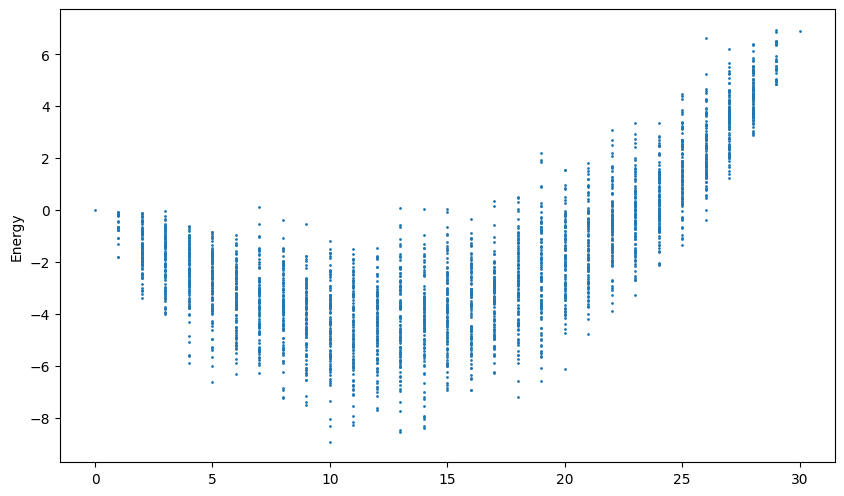

Best found: [0, 1, 5, 6, 10, 12, 14, 20, 26, 29]
count: 10
Energy: -8.9079
Solutions Sampled: 2762


In [51]:
sup_list=ProbabilisticSampler(Ms,100)

In [52]:
print(sup_list[0])
print('count', len(sup_list[0]))
print('energy', sup_list[1])

[0, 1, 5, 6, 10, 12, 14, 20, 26, 29]
count 10
energy -8.9079


In [53]:
# find products available at the suppliers
a=availability(sup_list[0],Ma)


In [54]:
print(len(a),a)

43 [ 0  1  2  3  5  9 14 16 17 22 24 25 28 29 32 35 36 38 39 41 42 44 45 46
 47 48 50 51 52 53 54 55 57 58 60 63 65 66 69 70 74 76 77]


In [55]:
m_i=item_m(a, Mi)

In [56]:
print(np.shape(m_i))
print(m_i)

(43, 43)
[[-0.6   0.7   0.03 ...  0.    0.02  0.02]
 [ 0.   -0.91  0.02 ...  0.04  0.    0.03]
 [ 0.    0.   -0.92 ...  0.03  0.02  0.01]
 ...
 [ 0.    0.    0.   ... -0.93  0.03  0.02]
 [ 0.    0.    0.   ...  0.    0.02 -0.9 ]
 [ 0.    0.    0.   ...  0.    0.   -0.39]]


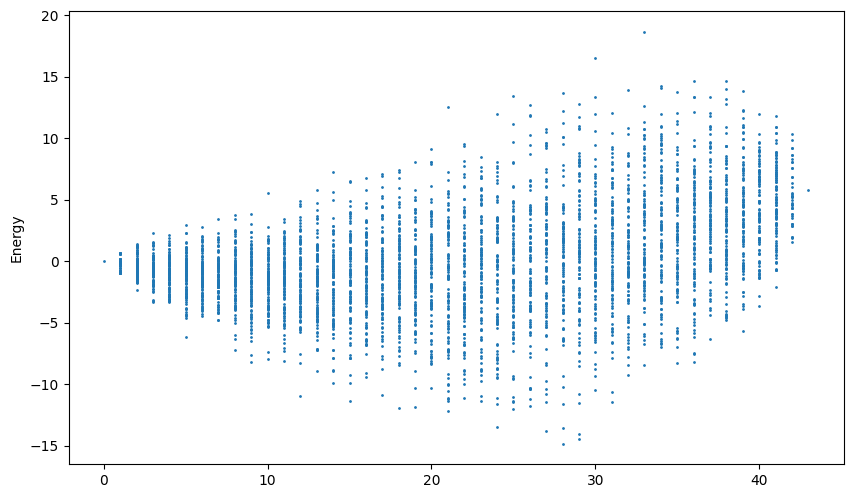

Best found: [1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15, 16, 18, 20, 21, 23, 28, 29, 31, 32, 33, 35, 36, 37, 38, 39, 40]
count: 28
Energy: -14.850000000000051
Solutions Sampled: 4088


In [57]:
p_items=ProbabilisticSampler(m_i,100)

In [58]:
print(p_items[0])
print('count', len(p_items[0]))
print('energy', p_items[1])

[1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15, 16, 18, 20, 21, 23, 28, 29, 31, 32, 33, 35, 36, 37, 38, 39, 40]
count 28
energy -14.850000000000051


## Determine the conflict based on the opposing objectives

### Evaluate results with the probabilistic solver

Collecting Plotting data for Scenario A

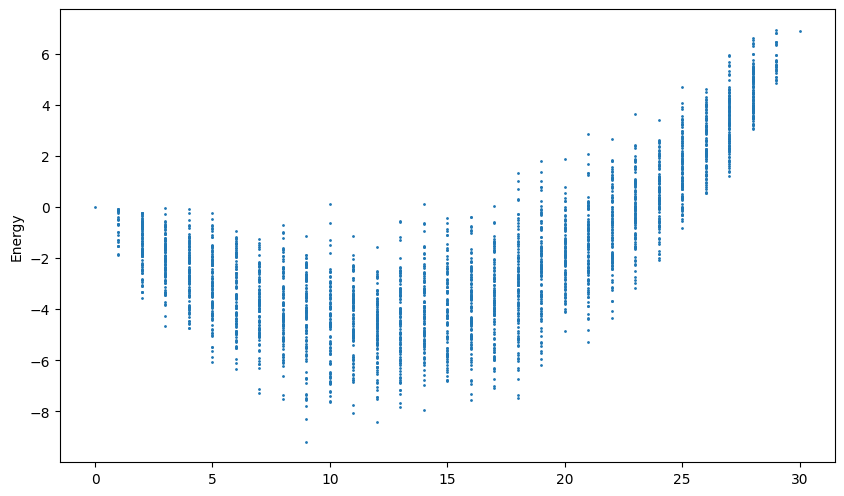

Best found: [0, 5, 10, 11, 12, 14, 15, 20, 21]
count: 9
Energy: -9.184190000000001
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 10, 11, 12, 14, 15, 20, 21]
Supplier energy -9.184190000000001
Items available: 40 [ 0  2  3  5  8  9 13 15 18 20 22 23 24 25 27 29 32 35 36 38 39 41 42 44
 45 46 47 48 50 51 52 53 54 55 66 69 70 74 77 79]
(40, 40)


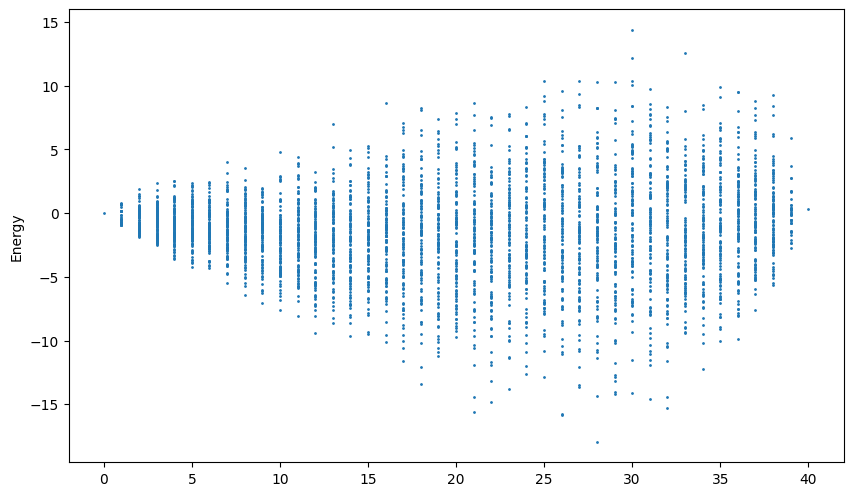

Best found: [1, 2, 3, 5, 6, 7, 9, 10, 11, 12, 13, 14, 19, 20, 23, 25, 27, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39]
count: 28
Energy: -17.940000000000083
Solutions Sampled: 3781
Items in solution: [ 2.  3.  5.  9. 13. 15. 20. 22. 23. 24. 25. 27. 38. 39. 44. 46. 48. 51.
 52. 53. 54. 55. 66. 69. 70. 74. 77. 79.]
Item Energy -17.940000000000083


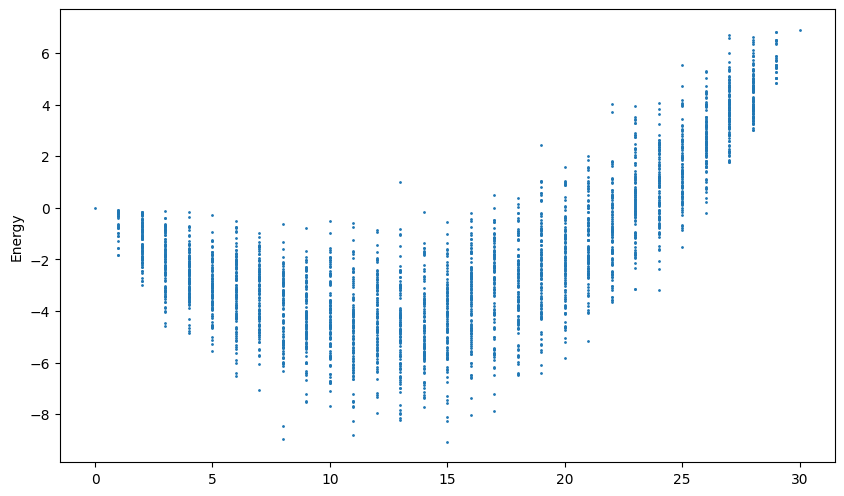

Best found: [0, 1, 4, 5, 6, 7, 8, 9, 10, 12, 14, 19, 20, 26, 27]
count: 15
Energy: -9.065069999999999
Solutions Sampled: 2762
Ideal suppliers: [0, 1, 4, 5, 6, 7, 8, 9, 10, 12, 14, 19, 20, 26, 27]
Supplier energy -9.065069999999999
Items available: 52 [ 0  1  2  3  5  9 11 14 16 17 22 24 25 28 29 30 32 33 34 35 36 37 38 39
 40 41 42 44 45 46 47 48 50 51 52 53 54 55 57 58 59 62 63 66 69 70 74 75
 76 77 78 79]
(52, 52)


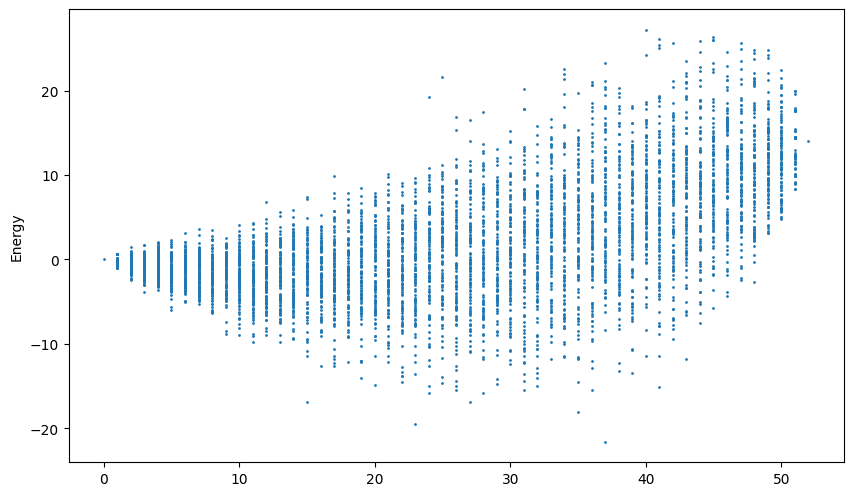

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 12, 15, 16, 18, 21, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 37, 38, 39, 41, 42, 43, 44, 45, 46, 47, 48, 50]
count: 37
Energy: -21.580000000000048
Solutions Sampled: 5006
Items in solution: [ 0.  1.  2.  3.  5.  9. 11. 14. 16. 25. 30. 32. 34. 37. 39. 40. 41. 42.
 44. 46. 47. 48. 50. 51. 52. 55. 57. 58. 62. 63. 66. 69. 70. 74. 75. 76.
 78.]
Item Energy -21.580000000000048


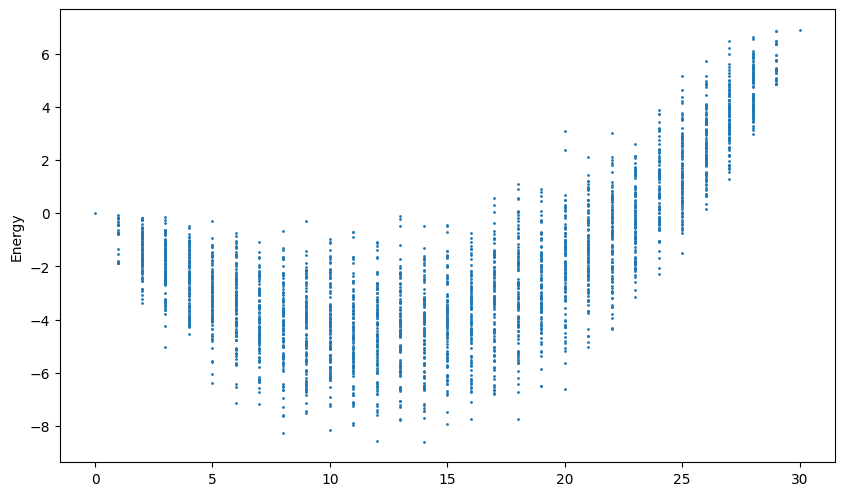

Best found: [0, 4, 5, 6, 9, 10, 12, 13, 14, 19, 20, 21, 24, 28]
count: 14
Energy: -8.596149999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 5, 6, 9, 10, 12, 13, 14, 19, 20, 21, 24, 28]
Supplier energy -8.596149999999998
Items available: 52 [ 0  1  2  3  5  8  9 13 15 17 18 20 22 23 25 27 29 30 31 32 35 36 38 39
 40 41 42 44 45 46 47 48 49 50 51 52 53 54 55 57 58 59 62 66 69 70 73 74
 75 76 77 79]
(52, 52)


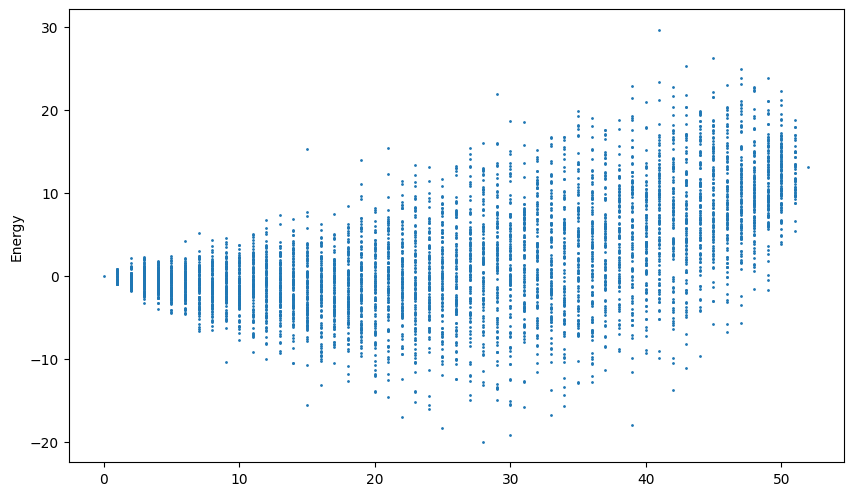

Best found: [1, 2, 3, 5, 6, 7, 10, 11, 12, 14, 17, 22, 24, 25, 28, 34, 35, 36, 38, 39, 40, 41, 44, 45, 46, 47, 49, 50]
count: 28
Energy: -19.940000000000076
Solutions Sampled: 5006
Items in solution: [ 1.  2.  3.  8.  9. 13. 18. 20. 22. 25. 30. 38. 40. 41. 45. 51. 52. 53.
 55. 57. 58. 59. 69. 70. 73. 74. 76. 77.]
Item Energy -19.940000000000076


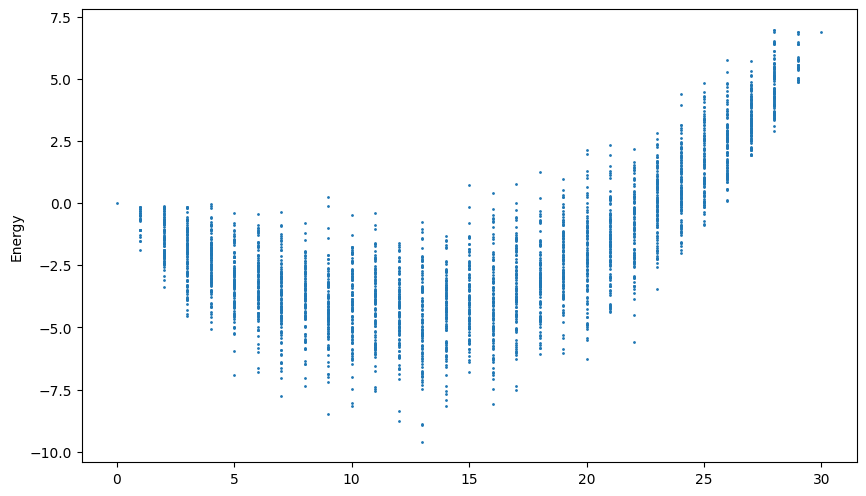

Best found: [0, 5, 7, 8, 10, 11, 13, 14, 16, 20, 23, 26, 28]
count: 13
Energy: -9.597689999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 7, 8, 10, 11, 13, 14, 16, 20, 23, 26, 28]
Supplier energy -9.597689999999998
Items available: 55 [ 0  2  3  5  6  8  9 13 16 17 18 19 20 22 24 25 28 29 30 31 32 33 34 35
 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 63 66 68 69
 70 72 74 76 77 78 79]
(55, 55)


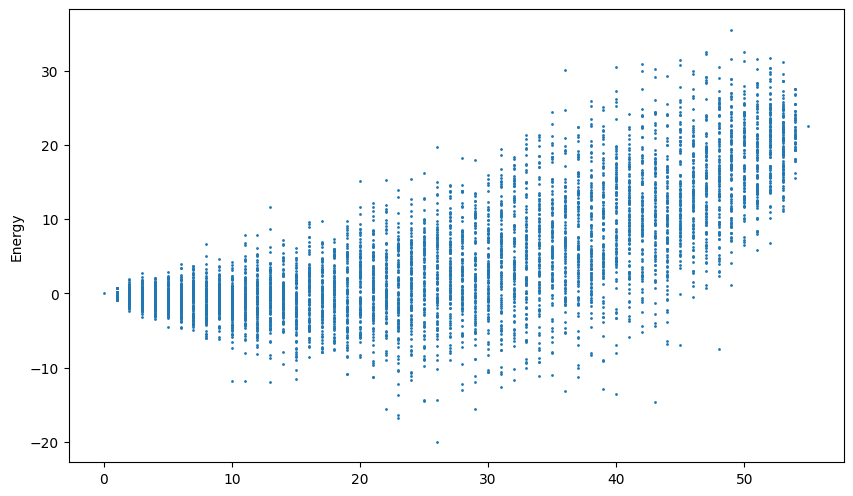

Best found: [1, 2, 3, 4, 6, 7, 13, 15, 20, 21, 22, 25, 26, 28, 31, 35, 38, 39, 41, 42, 43, 44, 47, 48, 50, 52]
count: 26
Energy: -19.96000000000007
Solutions Sampled: 5312
Items in solution: [ 2.  3.  5.  6.  9. 13. 22. 25. 32. 33. 34. 37. 38. 40. 44. 48. 51. 52.
 55. 57. 58. 63. 69. 70. 74. 77.]
Item Energy -19.96000000000007


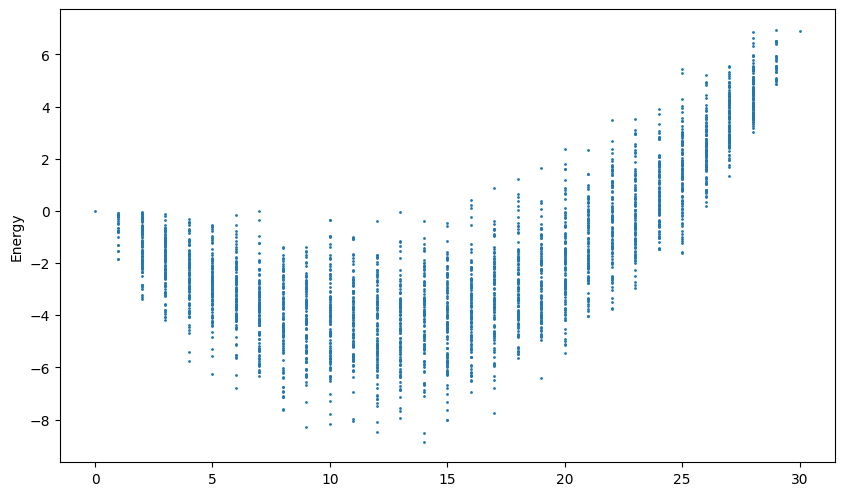

Best found: [0, 3, 5, 6, 7, 8, 11, 13, 14, 15, 20, 21, 22, 26]
count: 14
Energy: -8.849801
Solutions Sampled: 2762
Ideal suppliers: [0, 3, 5, 6, 7, 8, 11, 13, 14, 15, 20, 21, 22, 26]
Supplier energy -8.849801
Items available: 54 [ 0  1  2  5  8  9 13 15 16 17 18 20 22 23 24 25 27 28 29 30 32 33 34 35
 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 59 61 63 69
 70 74 76 77 78 79]
(54, 54)


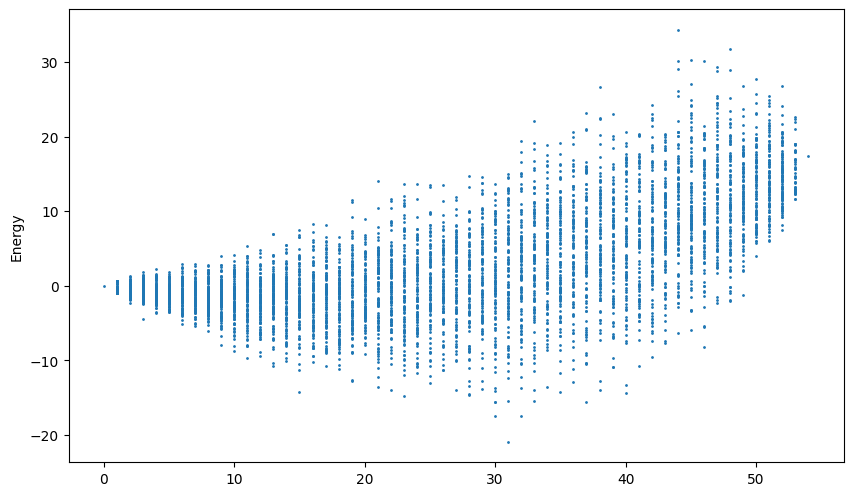

Best found: [0, 3, 4, 5, 6, 11, 13, 14, 16, 20, 21, 22, 24, 25, 27, 30, 31, 32, 33, 35, 36, 37, 40, 41, 42, 43, 46, 47, 48, 49, 50]
count: 31
Energy: -20.910000000000114
Solutions Sampled: 5210
Items in solution: [ 0.  5.  8.  9. 13. 20. 23. 24. 27. 32. 33. 34. 36. 37. 39. 42. 44. 45.
 46. 48. 49. 50. 53. 55. 57. 58. 63. 69. 70. 74. 76.]
Item Energy -20.910000000000114


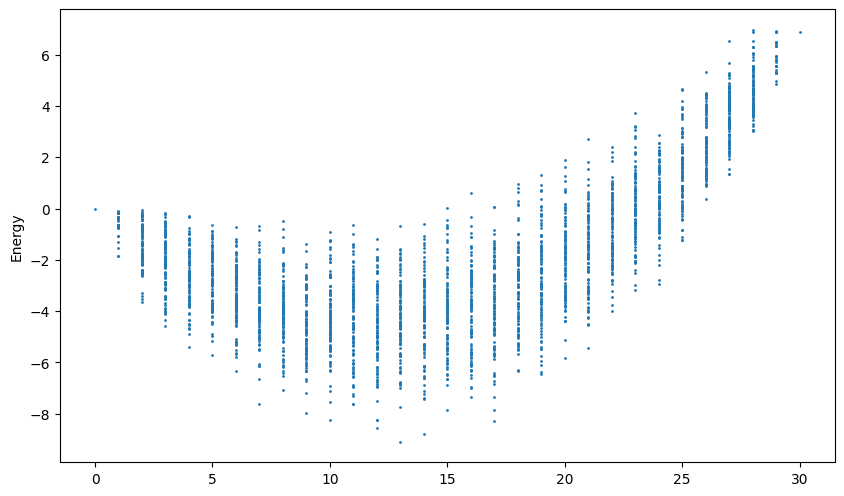

Best found: [0, 2, 4, 5, 7, 10, 11, 14, 18, 20, 21, 28, 29]
count: 13
Energy: -9.09422
Solutions Sampled: 2762
Ideal suppliers: [0, 2, 4, 5, 7, 10, 11, 14, 18, 20, 21, 28, 29]
Supplier energy -9.09422
Items available: 58 [ 0  2  3  5  6  8  9 10 12 13 14 15 16 17 18 20 21 22 23 25 26 27 29 31
 32 35 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 58 59 60 62
 64 65 66 69 70 71 74 76 77 79]
(58, 58)


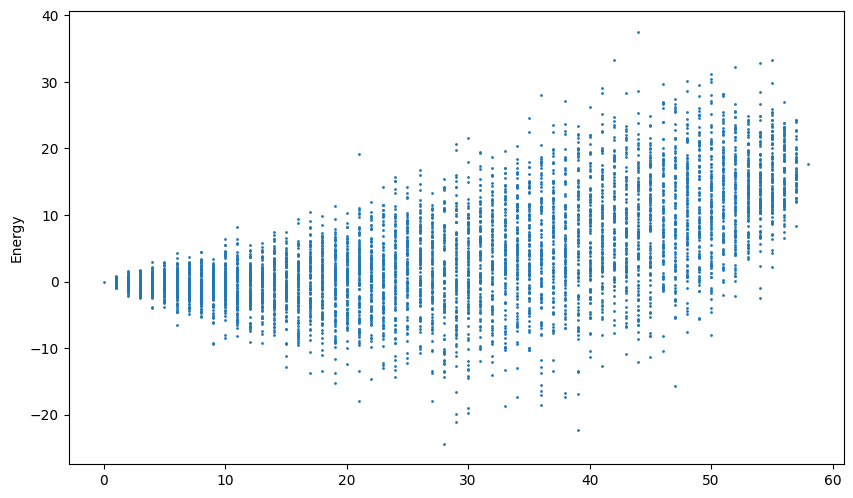

Best found: [0, 2, 3, 6, 7, 8, 10, 11, 18, 19, 20, 21, 22, 25, 27, 28, 29, 30, 33, 34, 39, 44, 46, 47, 51, 52, 53, 54]
count: 28
Energy: -24.37000000000001
Solutions Sampled: 5618
Items in solution: [ 0.  3.  5.  9. 10. 12. 14. 15. 23. 25. 26. 27. 29. 35. 37. 38. 39. 40.
 44. 45. 50. 58. 60. 62. 69. 70. 71. 74.]
Item Energy -24.37000000000001


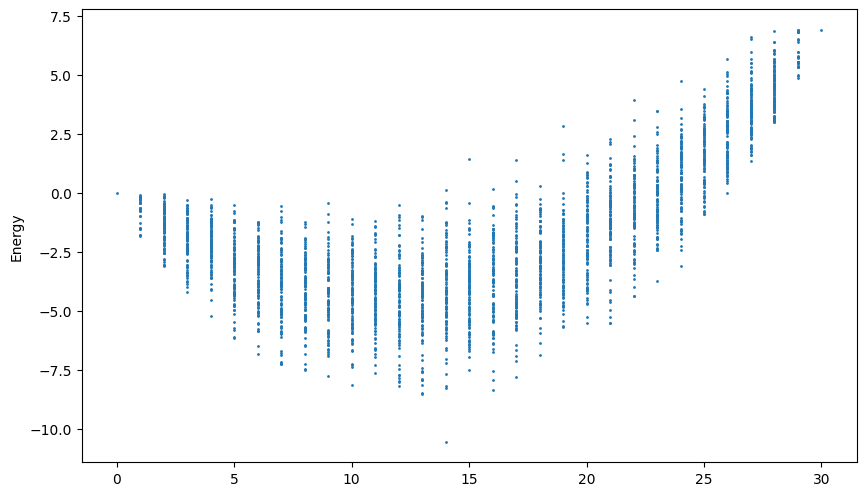

Best found: [0, 4, 5, 6, 7, 8, 10, 11, 13, 14, 20, 21, 24, 26]
count: 14
Energy: -10.55856
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 5, 6, 7, 8, 10, 11, 13, 14, 20, 21, 24, 26]
Supplier energy -10.55856
Items available: 56 [ 0  1  2  3  5  8  9 13 15 16 17 18 20 22 23 24 25 27 28 29 30 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47 48 50 51 52 53 55 57 58 59 62 63 66
 69 70 73 74 76 77 78 79]
(56, 56)


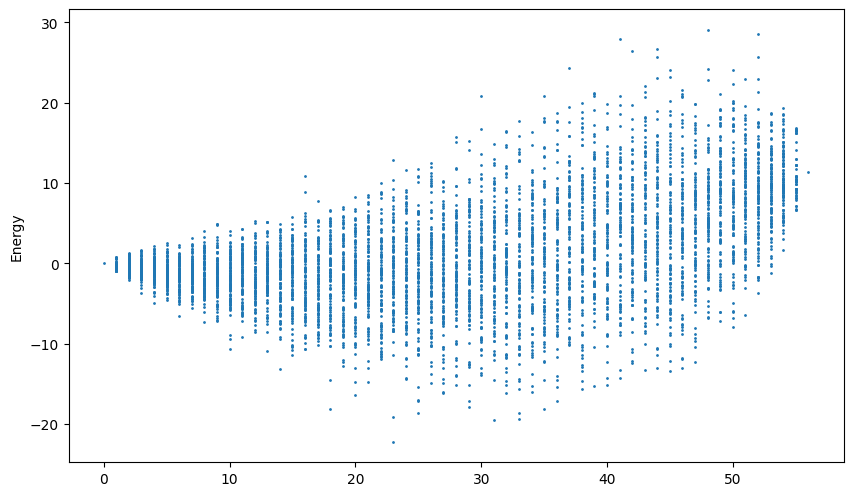

Best found: [2, 3, 4, 6, 7, 8, 9, 10, 12, 14, 16, 22, 25, 28, 29, 30, 32, 41, 42, 43, 44, 46, 50]
count: 23
Energy: -22.200000000000042
Solutions Sampled: 5414
Items in solution: [ 2.  3.  5.  9. 13. 15. 16. 17. 20. 23. 25. 33. 36. 39. 40. 41. 44. 55.
 57. 58. 59. 63. 73.]
Item Energy -22.200000000000042


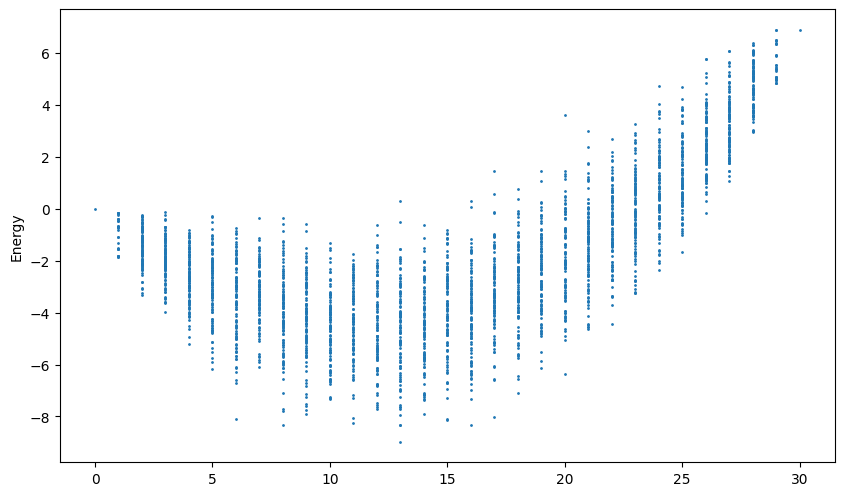

Best found: [0, 5, 7, 9, 10, 14, 20, 21, 22, 23, 24, 27, 28]
count: 13
Energy: -8.973319999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 7, 9, 10, 14, 20, 21, 22, 23, 24, 27, 28]
Supplier energy -8.973319999999998
Items available: 54 [ 0  2  3  5  6  8  9 11 13 15 16 17 18 20 22 23 25 27 29 30 31 32 35 36
 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 66 68 69 70 72
 73 74 75 76 77 79]
(54, 54)


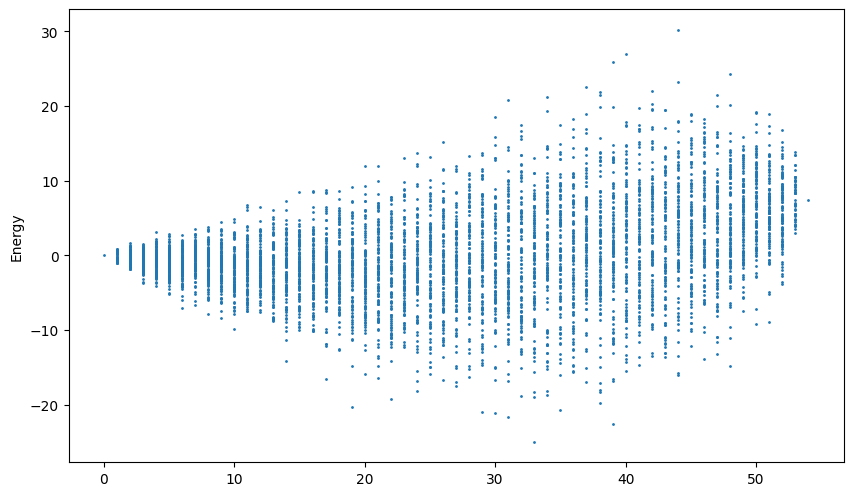

Best found: [0, 1, 2, 5, 7, 8, 9, 13, 15, 16, 17, 23, 24, 25, 26, 27, 28, 30, 37, 38, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52]
count: 33
Energy: -24.920000000000012
Solutions Sampled: 5210
Items in solution: [ 0.  2.  3.  8. 11. 13. 15. 20. 23. 25. 27. 36. 37. 38. 39. 40. 41. 44.
 51. 52. 53. 57. 58. 66. 68. 69. 70. 72. 73. 74. 75. 76. 77.]
Item Energy -24.920000000000012


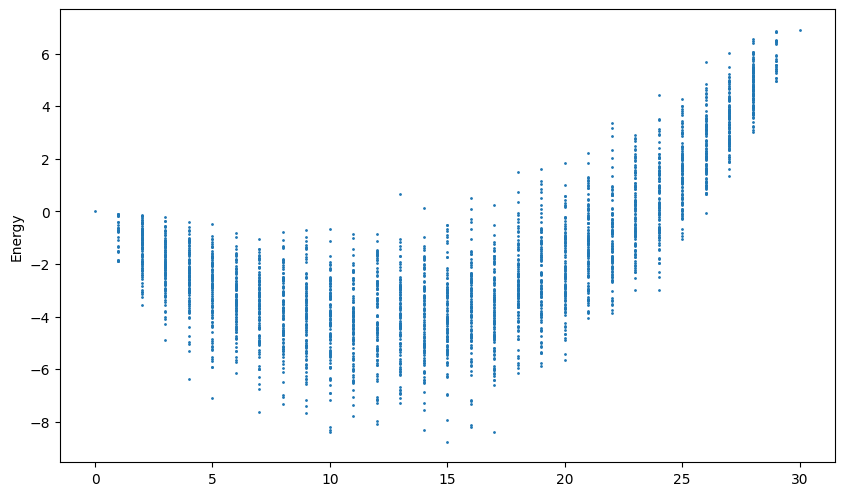

Best found: [0, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15, 18, 20, 26, 27]
count: 15
Energy: -8.75394
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15, 18, 20, 26, 27]
Supplier energy -8.75394
Items available: 56 [ 0  1  2  3  5  6  9 10 11 12 16 18 20 21 22 24 25 28 29 30 32 33 34 35
 36 37 38 39 40 41 42 44 45 46 47 48 50 51 52 53 55 57 58 59 62 63 64 66
 69 70 71 74 75 76 77 78]
(56, 56)


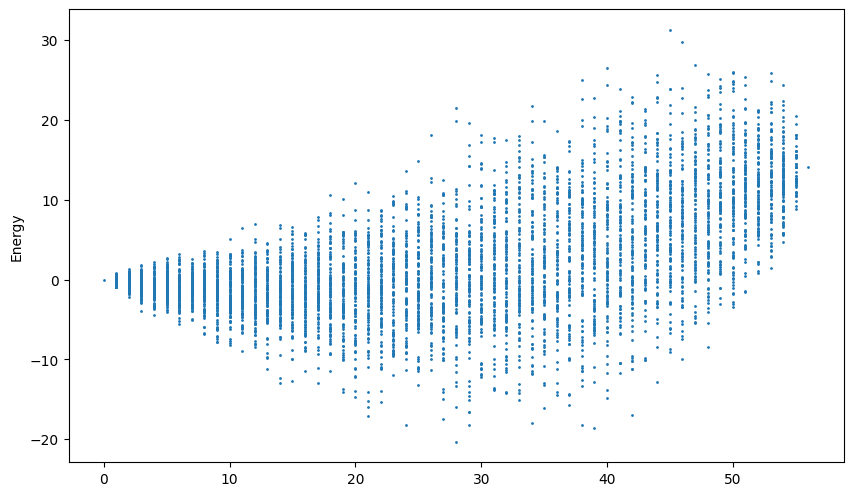

Best found: [2, 3, 4, 6, 8, 9, 14, 21, 22, 25, 26, 27, 28, 29, 31, 32, 33, 36, 37, 40, 41, 42, 45, 47, 49, 51, 52, 53]
count: 28
Energy: -20.320000000000046
Solutions Sampled: 5414
Items in solution: [ 2.  3.  5.  9. 11. 12. 22. 33. 34. 37. 38. 39. 40. 41. 44. 45. 46. 50.
 51. 55. 57. 58. 63. 66. 70. 74. 75. 76.]
Item Energy -20.320000000000046


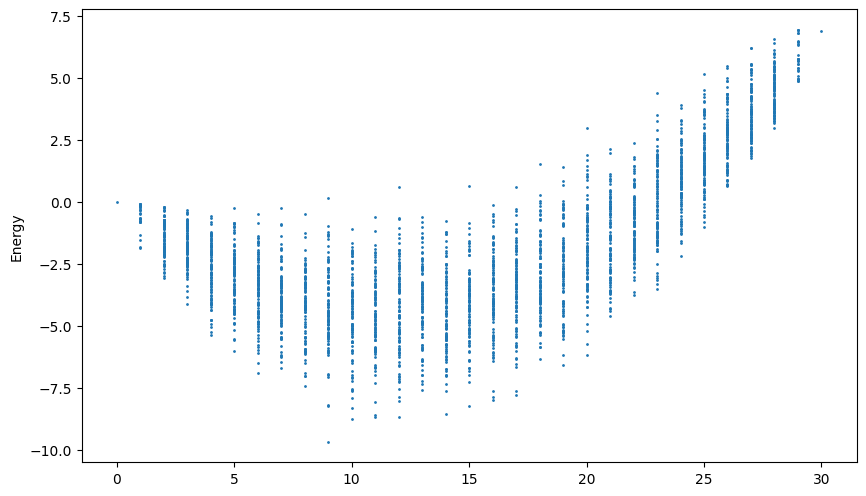

Best found: [5, 6, 7, 8, 10, 13, 14, 20, 27]
count: 9
Energy: -9.66553
Solutions Sampled: 2762
Ideal suppliers: [5, 6, 7, 8, 10, 13, 14, 20, 27]
Supplier energy -9.66553
Items available: 34 [ 0  1  2  3  5  9 11 16 17 22 24 25 29 30 32 33 34 35 37 39 40 42 44 45
 46 48 50 51 66 74 76 77 78 79]
(34, 34)


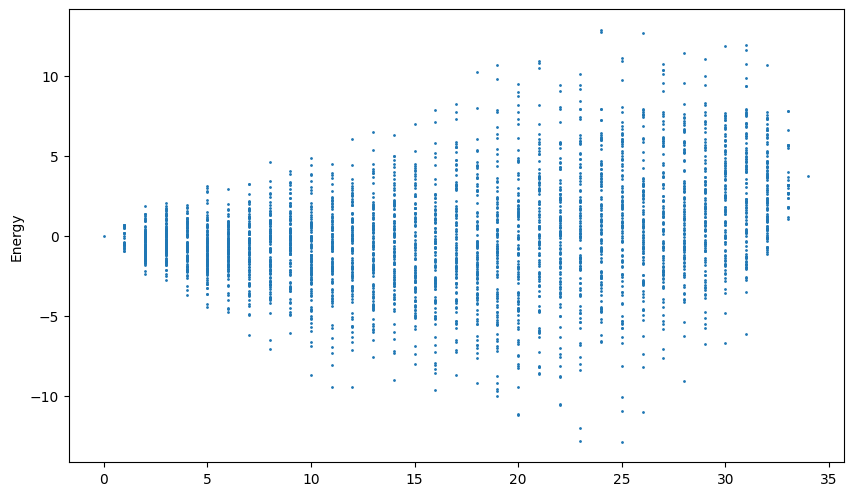

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 10, 14, 15, 18, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 31, 32, 33]
count: 25
Energy: -12.850000000000076
Solutions Sampled: 3170
Items in solution: [ 0.  1.  2.  3.  5.  9. 11. 16. 24. 32. 33. 37. 39. 40. 42. 44. 46. 48.
 51. 66. 74. 76. 77. 78. 79.]
Item Energy -12.850000000000076


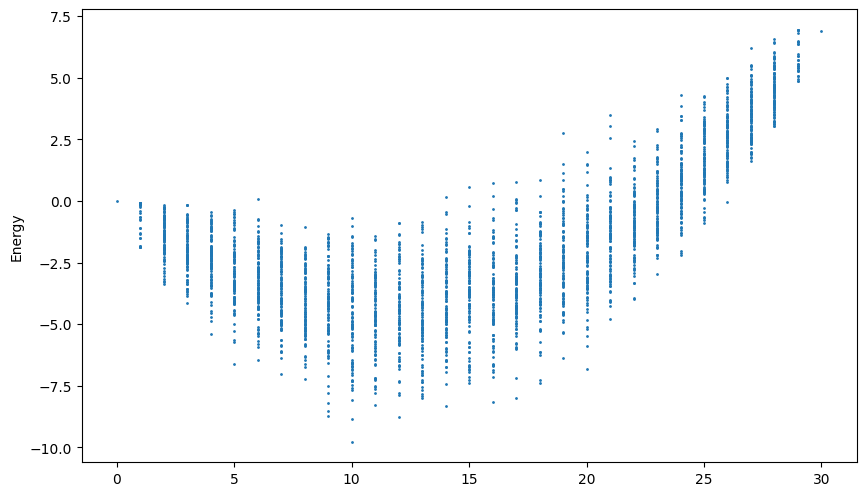

Best found: [0, 2, 5, 6, 7, 9, 14, 20, 21, 28]
count: 10
Energy: -9.769360000000002
Solutions Sampled: 2762
Ideal suppliers: [0, 2, 5, 6, 7, 9, 14, 20, 21, 28]
Supplier energy -9.769360000000002
Items available: 51 [ 0  1  2  3  5  8  9 13 14 15 16 17 18 20 22 23 25 26 27 29 30 31 32 35
 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 69 70 74 75
 76 77 79]
(51, 51)


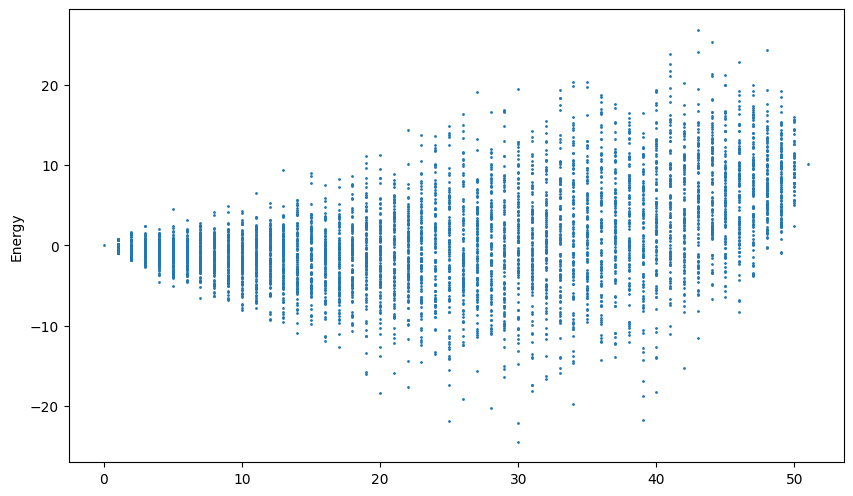

Best found: [0, 2, 3, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19, 25, 27, 28, 29, 31, 32, 33, 38, 40, 42, 43, 44, 45, 48, 49, 50]
count: 30
Energy: -24.469999999999956
Solutions Sampled: 4904
Items in solution: [ 0.  2.  3.  8.  9. 13. 14. 15. 20. 23. 25. 26. 27. 29. 37. 39. 40. 41.
 44. 45. 46. 51. 53. 57. 58. 69. 70. 76. 77. 79.]
Item Energy -24.469999999999956


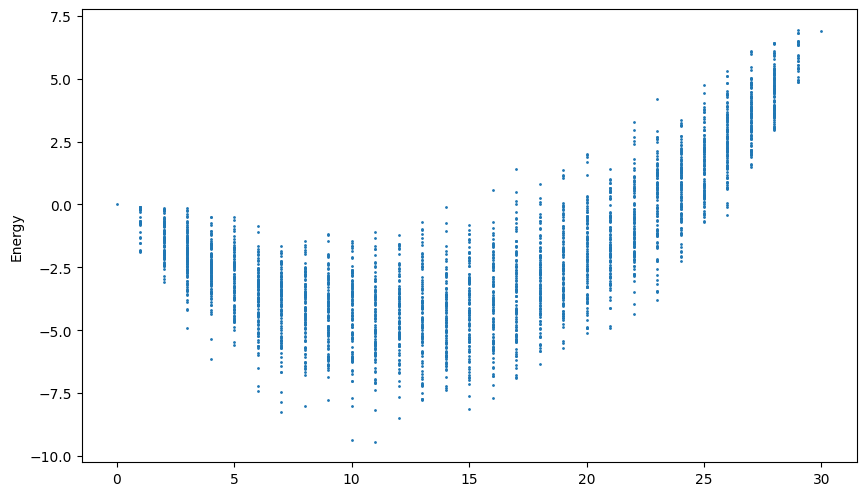

Best found: [5, 6, 7, 9, 11, 13, 14, 19, 20, 21, 26]
count: 11
Energy: -9.425300000000002
Solutions Sampled: 2762
Ideal suppliers: [5, 6, 7, 9, 11, 13, 14, 19, 20, 21, 26]
Supplier energy -9.425300000000002
Items available: 40 [ 0  1  2  5  8  9 13 15 16 17 18 20 22 23 24 25 27 28 30 32 35 38 39 40
 42 44 45 46 48 50 51 55 57 58 63 74 75 76 77 79]
(40, 40)


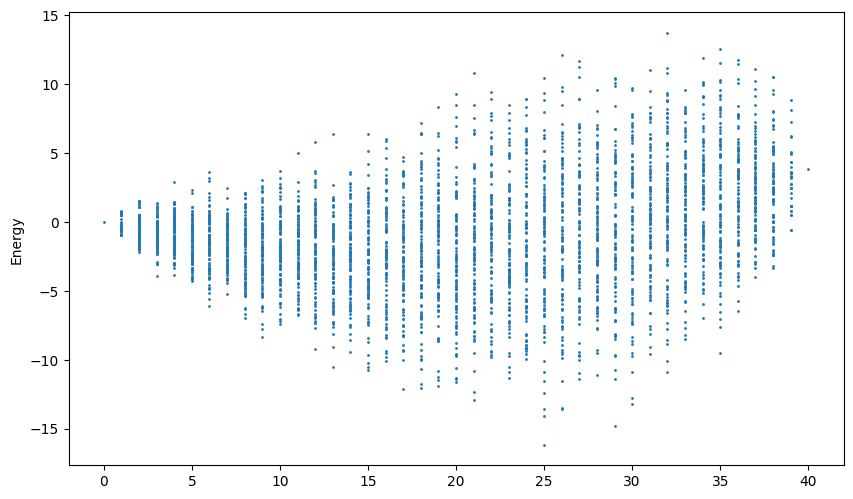

Best found: [1, 2, 3, 4, 5, 6, 10, 11, 12, 13, 14, 15, 21, 23, 26, 28, 29, 30, 31, 32, 33, 35, 36, 38, 39]
count: 25
Energy: -16.170000000000066
Solutions Sampled: 3781
Items in solution: [ 1.  2.  5.  8.  9. 13. 18. 20. 22. 23. 24. 25. 38. 40. 45. 48. 50. 51.
 55. 57. 58. 74. 75. 77. 79.]
Item Energy -16.170000000000066


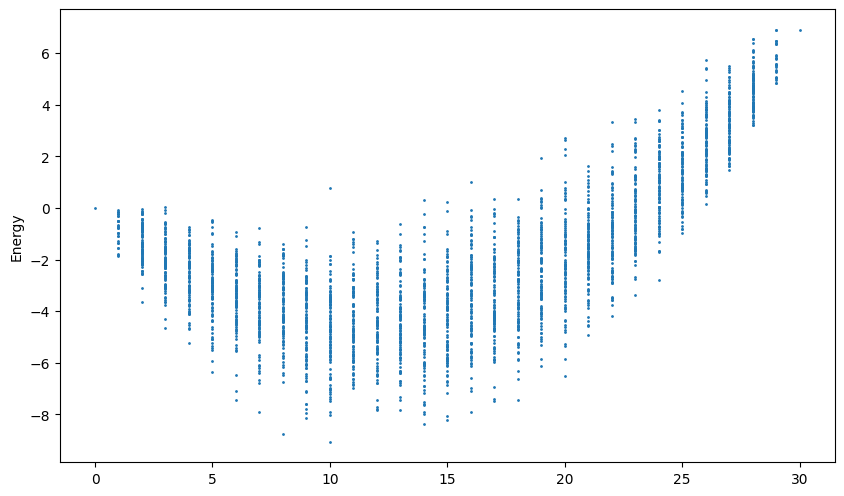

Best found: [4, 5, 7, 10, 12, 14, 20, 21, 27, 28]
count: 10
Energy: -9.06008
Solutions Sampled: 2762
Ideal suppliers: [4, 5, 7, 10, 12, 14, 20, 21, 27, 28]
Supplier energy -9.06008
Items available: 38 [ 0  2  3  5  8  9 11 13 15 16 17 18 20 22 23 25 27 31 32 35 38 40 42 44
 45 46 48 49 50 51 54 59 62 66 74 76 77 79]
(38, 38)


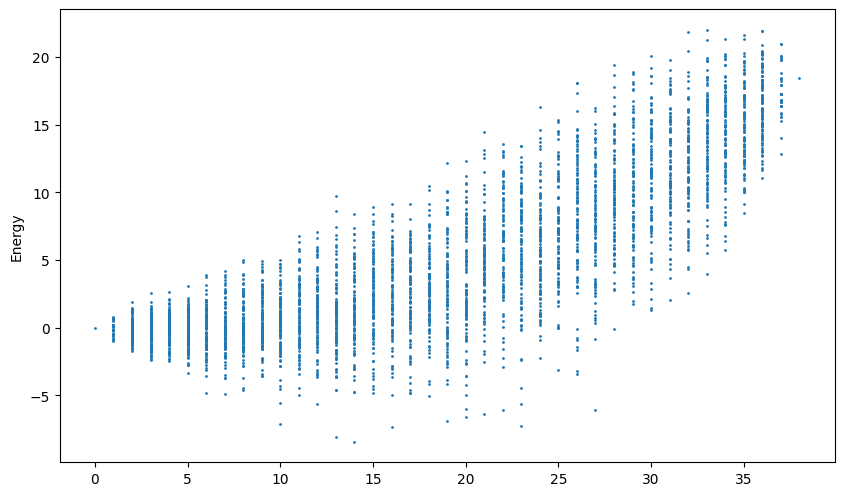

Best found: [1, 2, 4, 5, 6, 8, 9, 12, 15, 20, 21, 26, 33, 35]
count: 14
Energy: -8.420000000000009
Solutions Sampled: 3578
Items in solution: [ 2.  3.  8.  9. 11. 15. 16. 20. 25. 38. 40. 48. 66. 76.]
Item Energy -8.420000000000009


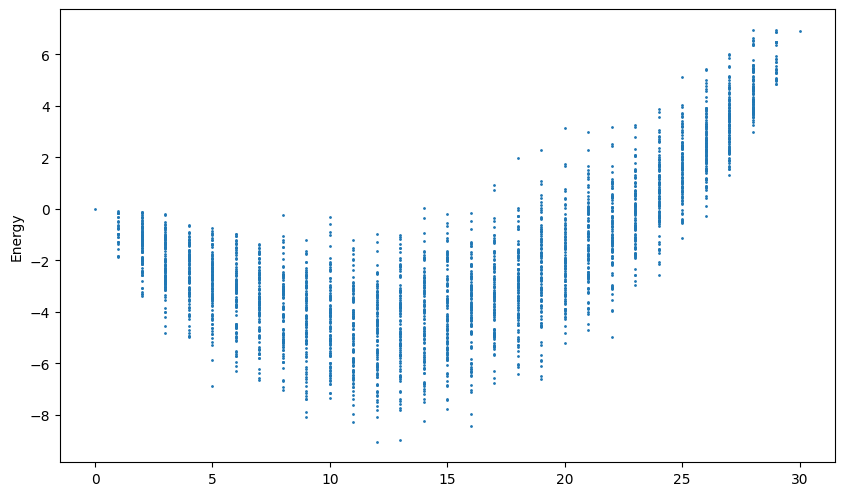

Best found: [0, 5, 6, 7, 11, 14, 15, 20, 22, 23, 24, 26]
count: 12
Energy: -9.041599999999999
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 7, 11, 14, 15, 20, 22, 23, 24, 26]
Supplier energy -9.041599999999999
Items available: 50 [ 0  1  2  3  5  6  8  9 13 16 17 18 20 22 24 25 28 29 32 35 36 37 38 39
 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 63 68 69 70 72 73 74 76
 77 79]
(50, 50)


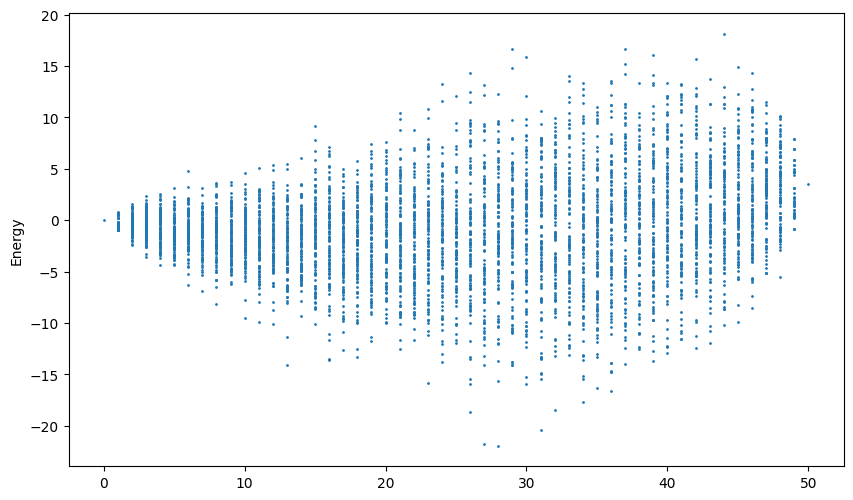

Best found: [0, 3, 4, 5, 6, 7, 8, 11, 14, 19, 22, 23, 24, 26, 28, 31, 33, 34, 35, 36, 37, 38, 39, 40, 42, 43, 44, 45]
count: 28
Energy: -21.950000000000014
Solutions Sampled: 4802
Items in solution: [ 0.  3.  5.  6.  8.  9. 13. 18. 24. 35. 38. 39. 40. 42. 45. 48. 50. 51.
 52. 53. 55. 57. 58. 63. 69. 70. 72. 73.]
Item Energy -21.950000000000014


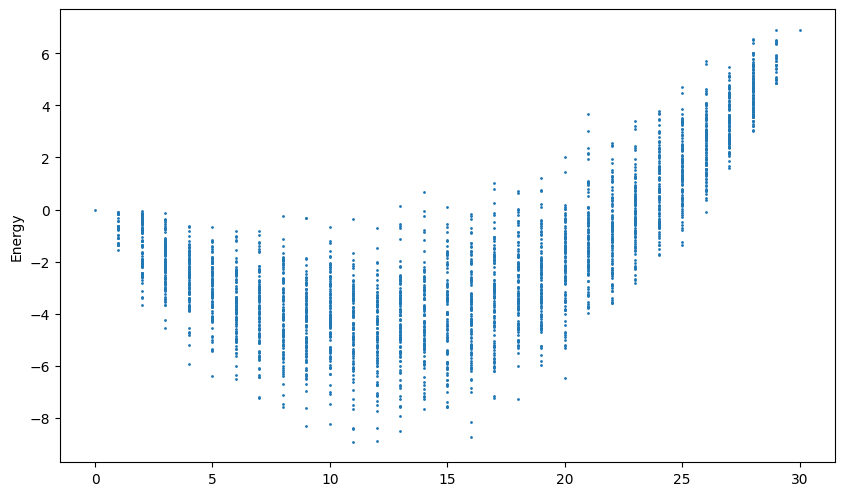

Best found: [0, 5, 6, 7, 8, 10, 12, 13, 14, 19, 23]
count: 11
Energy: -8.91544
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 7, 8, 10, 12, 13, 14, 19, 23]
Supplier energy -8.91544
Items available: 48 [ 0  1  2  3  5  6  8 13 16 17 18 20 22 24 25 29 30 32 33 34 36 37 38 39
 40 41 42 44 45 46 47 48 50 51 52 53 54 55 66 68 69 70 72 74 76 77 78 79]
(48, 48)


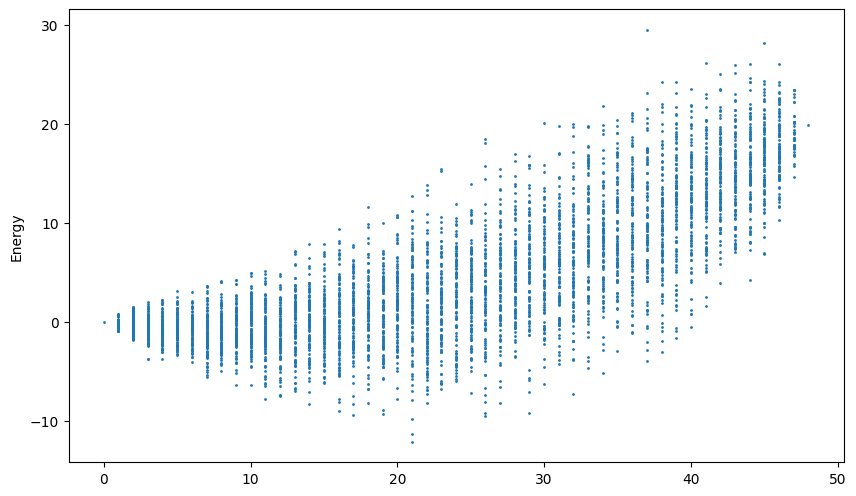

Best found: [2, 4, 5, 6, 7, 9, 11, 12, 13, 14, 19, 21, 23, 24, 27, 33, 35, 36, 37, 41, 42]
count: 21
Energy: -12.120000000000022
Solutions Sampled: 4598
Items in solution: [ 2.  5.  6.  8. 13. 17. 20. 22. 24. 25. 34. 37. 39. 40. 44. 51. 53. 54.
 55. 70. 72.]
Item Energy -12.120000000000022


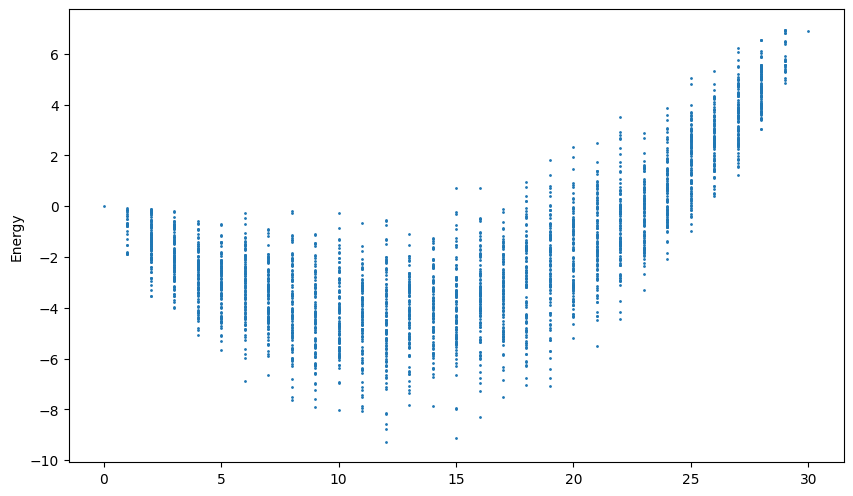

Best found: [0, 5, 6, 10, 11, 14, 15, 20, 23, 24, 27, 28]
count: 12
Energy: -9.27155
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 10, 11, 14, 15, 20, 23, 24, 27, 28]
Supplier energy -9.27155
Items available: 45 [ 0  1  2  3  5  6  8  9 11 13 17 18 20 22 24 25 29 31 32 35 36 38 39 41
 42 44 45 46 47 48 49 50 51 52 53 55 66 68 69 70 72 73 74 76 77]
(45, 45)


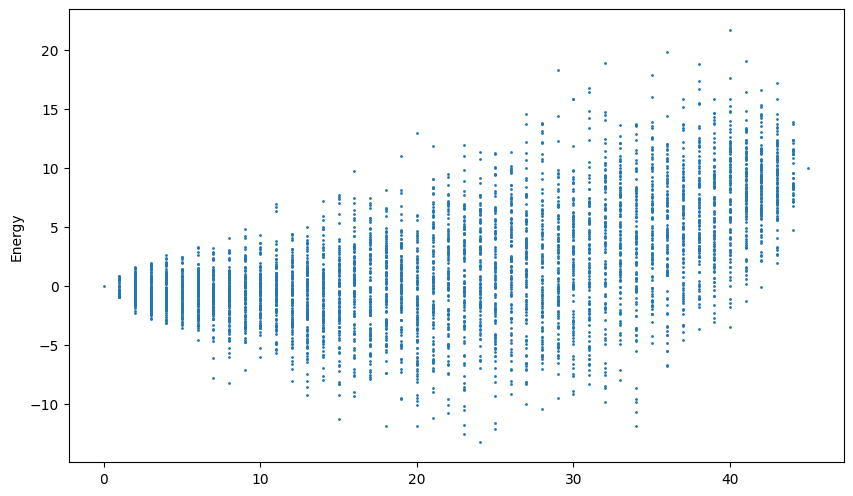

Best found: [2, 3, 5, 7, 8, 12, 13, 14, 15, 18, 19, 22, 23, 26, 28, 29, 33, 34, 35, 38, 39, 40, 42, 44]
count: 24
Energy: -13.200000000000026
Solutions Sampled: 4291
Items in solution: [ 2.  3.  6.  9. 11. 20. 22. 24. 25. 32. 35. 39. 41. 45. 47. 48. 52. 53.
 55. 69. 70. 72. 74. 77.]
Item Energy -13.200000000000026


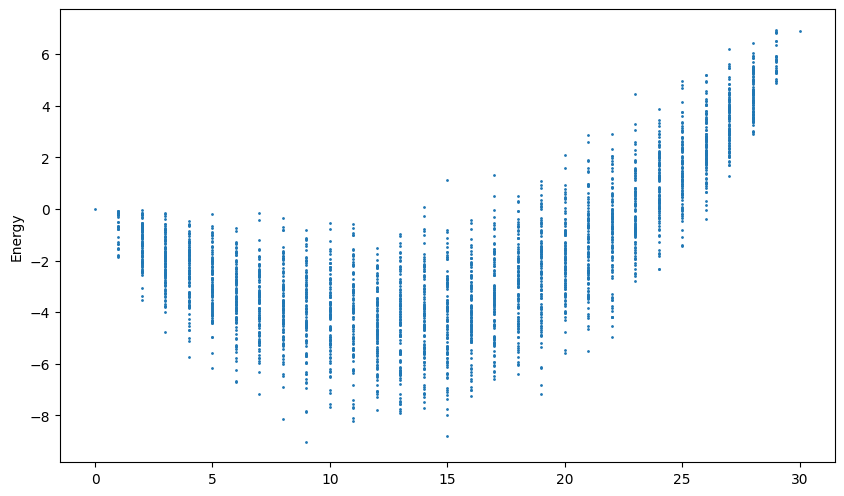

Best found: [0, 6, 7, 10, 14, 15, 19, 20, 26]
count: 9
Energy: -9.021589999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 6, 7, 10, 14, 15, 19, 20, 26]
Supplier energy -9.021589999999998
Items available: 41 [ 0  1  2  3  5  9 16 17 22 24 25 28 29 32 35 36 38 39 40 41 42 44 45 46
 47 48 50 51 52 53 55 57 58 63 66 69 70 74 76 77 79]
(41, 41)


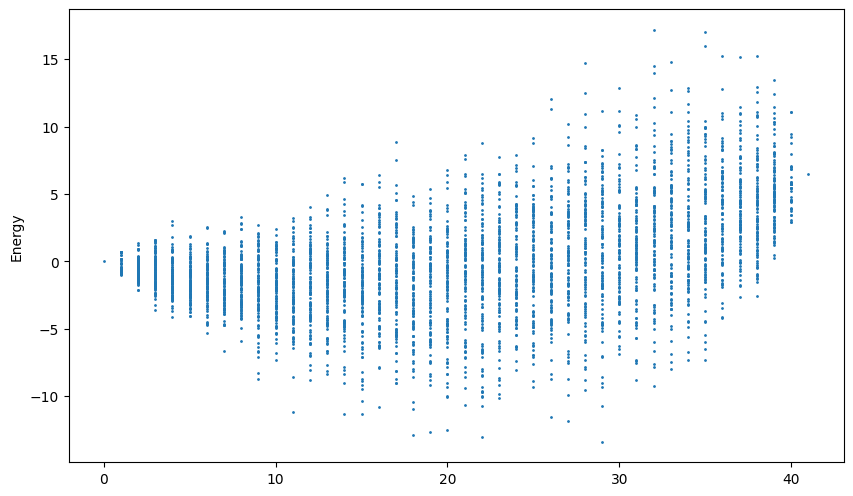

Best found: [1, 2, 3, 4, 5, 8, 10, 13, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33, 35, 36, 37, 38, 39]
count: 29
Energy: -13.39000000000006
Solutions Sampled: 3884
Items in solution: [ 1.  2.  3.  5.  9. 22. 25. 32. 36. 38. 39. 40. 41. 42. 45. 46. 47. 48.
 50. 51. 55. 57. 58. 63. 69. 70. 74. 76. 77.]
Item Energy -13.39000000000006


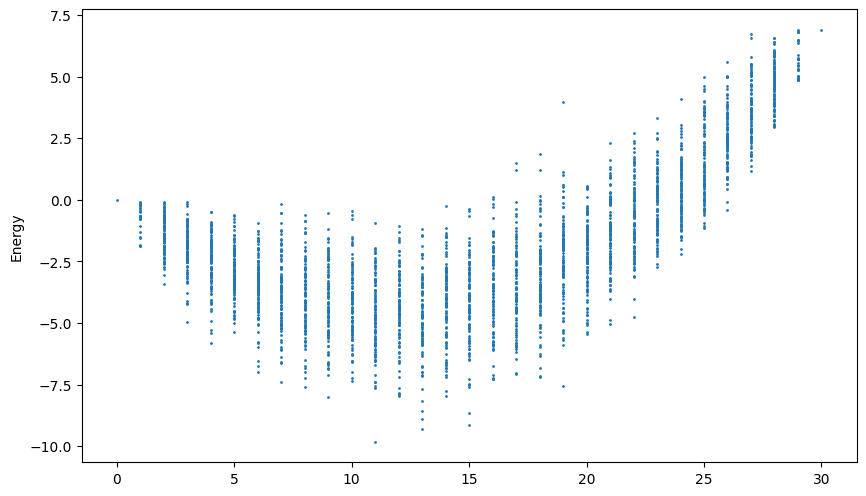

Best found: [0, 5, 6, 7, 10, 12, 14, 15, 19, 20, 27]
count: 11
Energy: -9.81487
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 7, 10, 12, 14, 15, 19, 20, 27]
Supplier energy -9.81487
Items available: 39 [ 0  1  2  3  5  9 11 16 17 22 24 25 29 32 35 36 38 39 40 41 42 44 45 46
 47 48 50 51 52 53 54 55 66 69 70 74 76 77 79]
(39, 39)


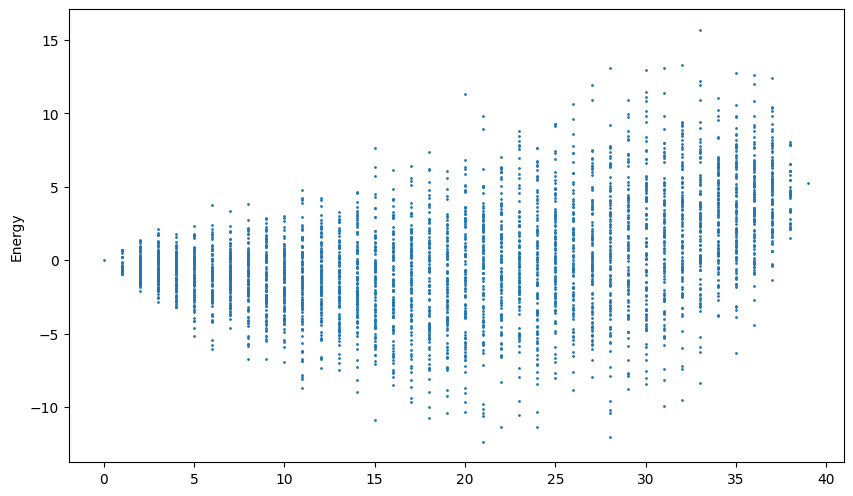

Best found: [0, 2, 3, 4, 5, 6, 9, 10, 11, 13, 17, 18, 19, 20, 23, 25, 26, 28, 33, 34, 37]
count: 21
Energy: -12.360000000000046
Solutions Sampled: 3680
Items in solution: [ 0.  2.  3.  5.  9. 11. 22. 24. 25. 32. 39. 40. 41. 42. 46. 48. 50. 52.
 69. 70. 77.]
Item Energy -12.360000000000046


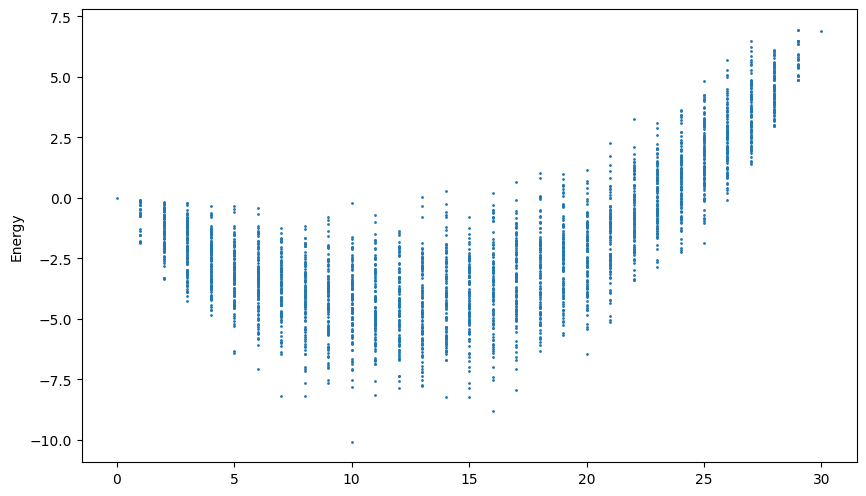

Best found: [0, 5, 7, 8, 10, 12, 14, 20, 26, 28]
count: 10
Energy: -10.07442
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 7, 8, 10, 12, 14, 20, 26, 28]
Supplier energy -10.07442
Items available: 48 [ 0  2  3  5  9 16 17 22 24 25 28 29 30 31 32 33 34 35 36 37 38 39 40 41
 42 44 45 46 47 48 49 50 51 52 53 54 55 57 58 63 66 69 70 74 76 77 78 79]
(48, 48)


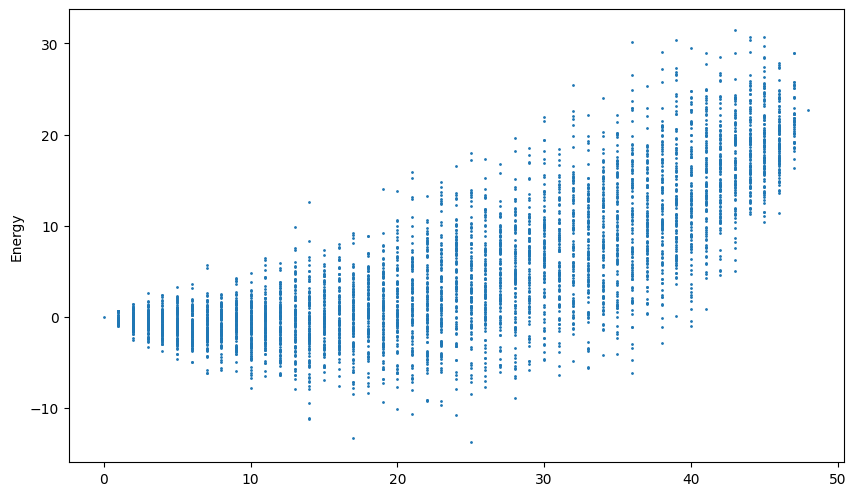

Best found: [0, 1, 2, 3, 4, 9, 12, 19, 20, 21, 22, 23, 25, 26, 29, 30, 34, 35, 36, 37, 41, 42, 45, 46, 47]
count: 25
Energy: -13.680000000000073
Solutions Sampled: 4598
Items in solution: [ 0.  2.  3.  5.  9. 25. 30. 37. 38. 39. 40. 41. 44. 45. 48. 49. 53. 54.
 55. 57. 69. 70. 77. 78. 79.]
Item Energy -13.680000000000073


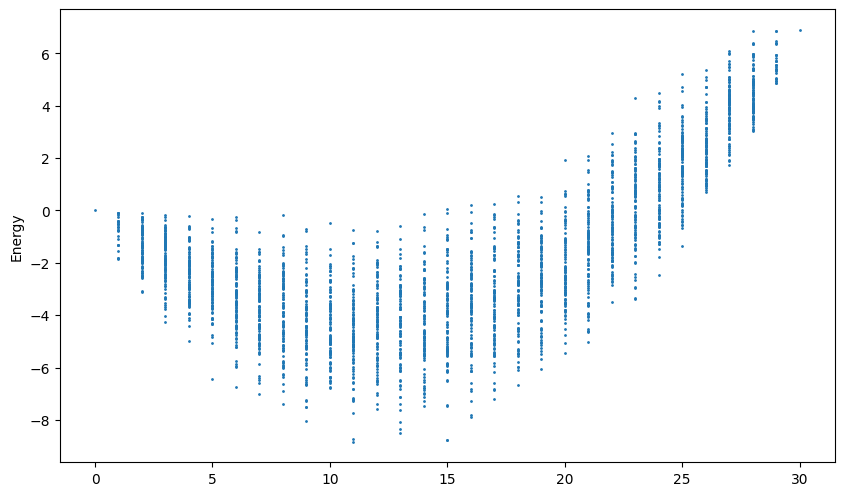

Best found: [2, 5, 6, 7, 8, 10, 11, 13, 14, 27, 28]
count: 11
Energy: -8.833169999999999
Solutions Sampled: 2762
Ideal suppliers: [2, 5, 6, 7, 8, 10, 11, 13, 14, 27, 28]
Supplier energy -8.833169999999999
Items available: 36 [ 0  1  2  3  5 11 14 16 17 22 24 25 26 29 30 31 32 33 34 36 37 38 39 40
 42 45 48 49 50 51 66 74 76 77 78 79]
(36, 36)


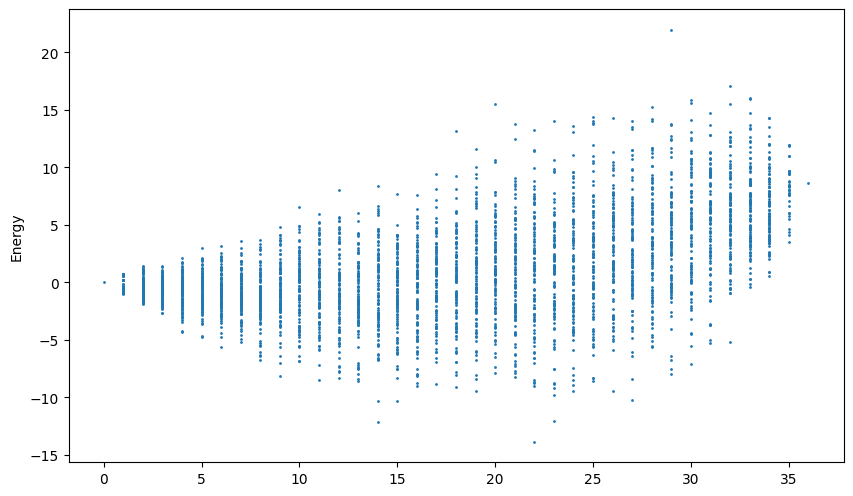

Best found: [0, 2, 3, 4, 5, 6, 7, 9, 10, 14, 18, 19, 20, 21, 22, 23, 24, 27, 31, 32, 34, 35]
count: 22
Energy: -13.850000000000058
Solutions Sampled: 3374
Items in solution: [ 0.  2.  3.  5. 11. 14. 16. 22. 24. 30. 34. 36. 37. 38. 39. 40. 42. 49.
 74. 76. 78. 79.]
Item Energy -13.850000000000058


In [59]:

plot_sup1=[]
plot_prod1=[]

total=20
for trials in range(total):

    sup_list=ProbabilisticSampler(Ms,100)
    print('Ideal suppliers:',sup_list[0])
    #print('count', len(sup_list[0]))
    print('Supplier energy', sup_list[1])
    plot_sup1.append(sup_list[1])
    a=availability(sup_list[0],Ma)
    print('Items available:',len(a),a)
    m_i=item_m(a, Mi)
    print(np.shape(m_i))
    p_items=ProbabilisticSampler(m_i,100)
    i_item=np.zeros(len(p_items[0]))
    for i in range(len(p_items[0])):
        i_item[i]=a[p_items[0][i]]
    print('Items in solution:',i_item)
    #print('count', len(p_items[0]))
    print('Item Energy', p_items[1])
    plot_prod1.append(p_items[1])
    


Collecting Plotting data for Scenario B

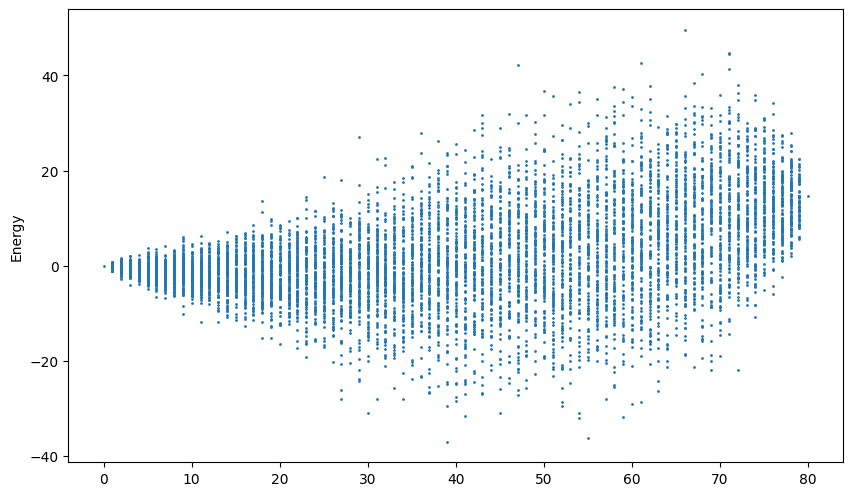

Best found: [1, 4, 5, 7, 9, 10, 11, 13, 15, 24, 26, 27, 33, 34, 37, 38, 39, 40, 44, 45, 47, 49, 50, 52, 56, 57, 58, 63, 64, 65, 66, 69, 71, 72, 73, 75, 77, 78, 79]
count: 39
Energy: -36.94999999999979
Solutions Sampled: 7862
Ideal items: [1, 4, 5, 7, 9, 10, 11, 13, 15, 24, 26, 27, 33, 34, 37, 38, 39, 40, 44, 45, 47, 49, 50, 52, 56, 57, 58, 63, 64, 65, 66, 69, 71, 72, 73, 75, 77, 78, 79]
Items energy: -36.94999999999979
max random 30


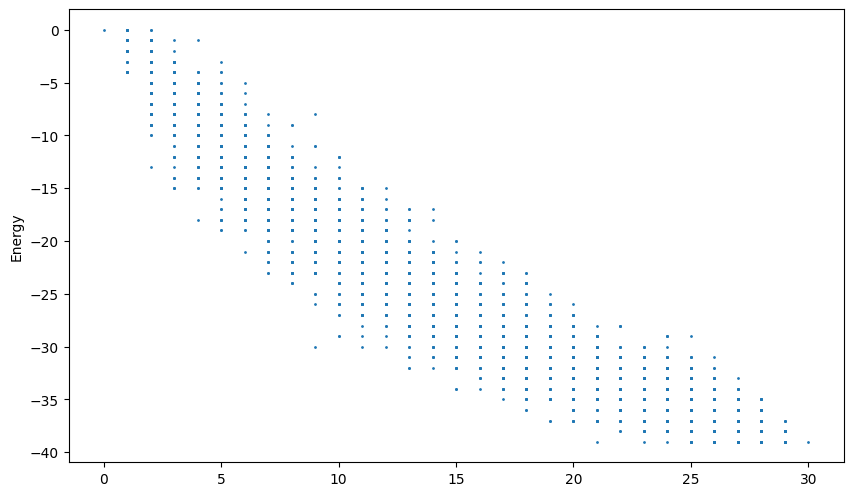

Best found: [0, 1, 2, 4, 8, 9, 10, 12, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28]
count: 21
Energy: -39.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 4, 8, 9, 10, 12, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28]
Supplier Energy -0.3361099999999987


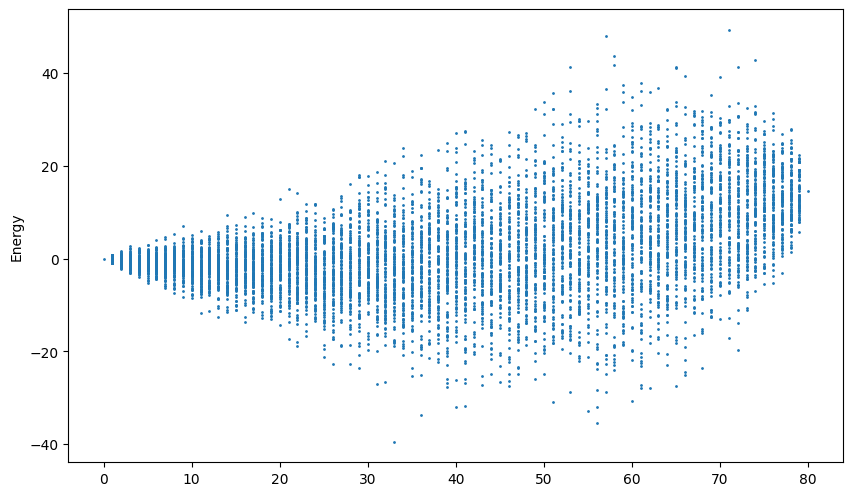

Best found: [1, 3, 4, 6, 7, 8, 10, 11, 13, 15, 23, 24, 26, 31, 34, 37, 38, 39, 40, 42, 43, 44, 45, 55, 57, 58, 59, 64, 69, 71, 74, 78, 79]
count: 33
Energy: -39.489999999999824
Solutions Sampled: 7862
Ideal items: [1, 3, 4, 6, 7, 8, 10, 11, 13, 15, 23, 24, 26, 31, 34, 37, 38, 39, 40, 42, 43, 44, 45, 55, 57, 58, 59, 64, 69, 71, 74, 78, 79]
Items energy: -39.489999999999824
max random 30


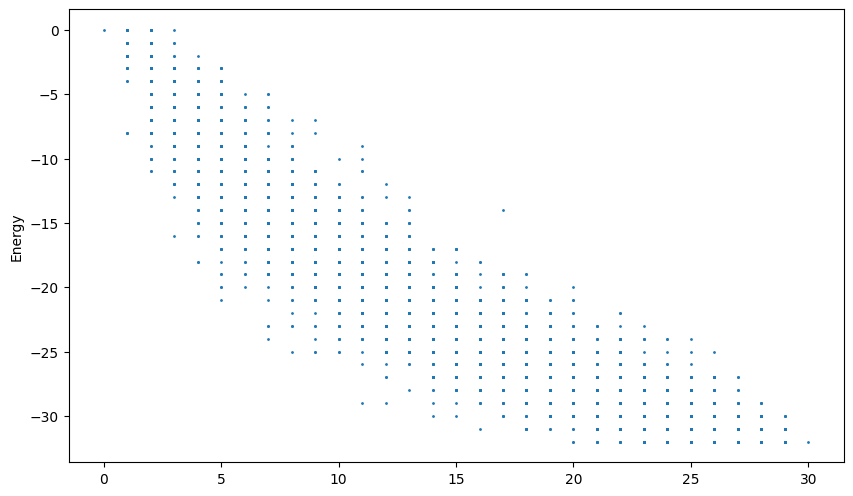

Best found: [0, 2, 4, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 27, 28, 29]
count: 20
Energy: -32.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 4, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 27, 28, 29]
Supplier Energy -2.936526000000001


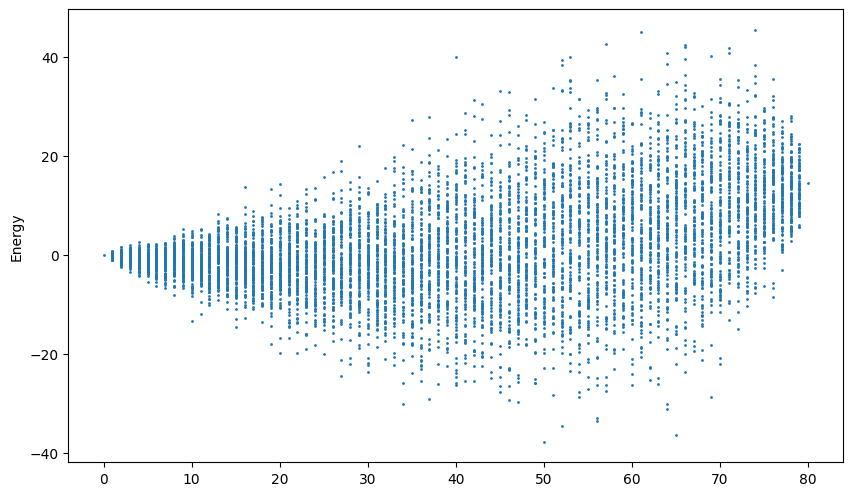

Best found: [3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 19, 20, 21, 22, 24, 25, 26, 27, 30, 33, 38, 39, 41, 43, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 59, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
count: 50
Energy: -37.7499999999997
Solutions Sampled: 7862
Ideal items: [3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 19, 20, 21, 22, 24, 25, 26, 27, 30, 33, 38, 39, 41, 43, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 59, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Items energy: -37.7499999999997
max random 30


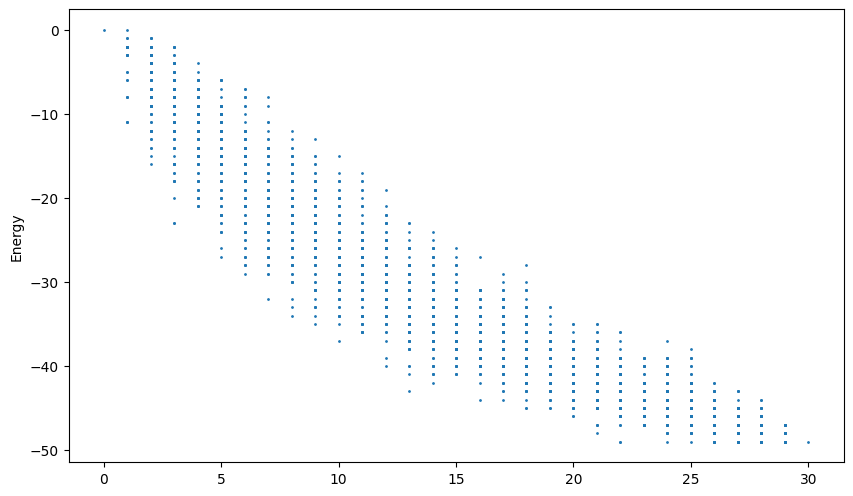

Best found: [0, 2, 4, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 20, 21, 23, 24, 25, 27, 28, 29]
count: 22
Energy: -49.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 4, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 20, 21, 23, 24, 25, 27, 28, 29]
Supplier Energy -1.1687399999999988


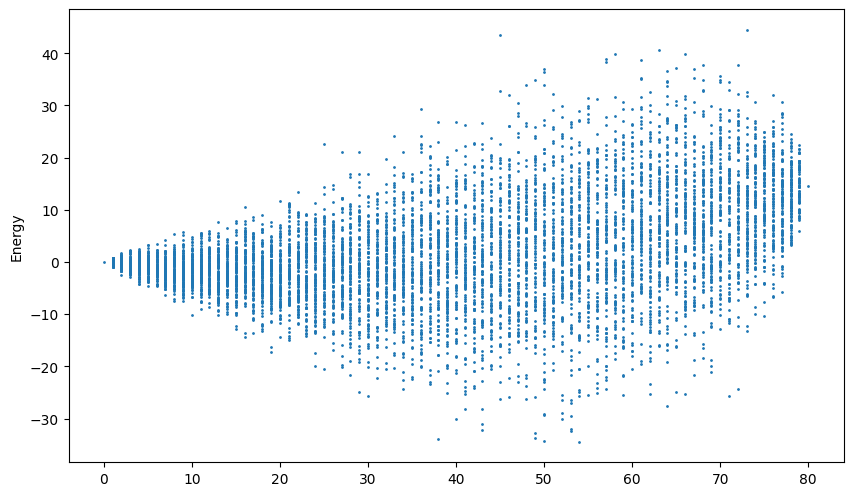

Best found: [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 19, 20, 21, 23, 24, 25, 26, 27, 30, 32, 34, 35, 36, 40, 42, 43, 44, 46, 48, 49, 50, 52, 55, 56, 57, 58, 59, 60, 63, 65, 67, 68, 69, 70, 71, 72, 73, 74, 76, 78, 79]
count: 54
Energy: -34.43999999999963
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 19, 20, 21, 23, 24, 25, 26, 27, 30, 32, 34, 35, 36, 40, 42, 43, 44, 46, 48, 49, 50, 52, 55, 56, 57, 58, 59, 60, 63, 65, 67, 68, 69, 70, 71, 72, 73, 74, 76, 78, 79]
Items energy: -34.43999999999963
max random 30


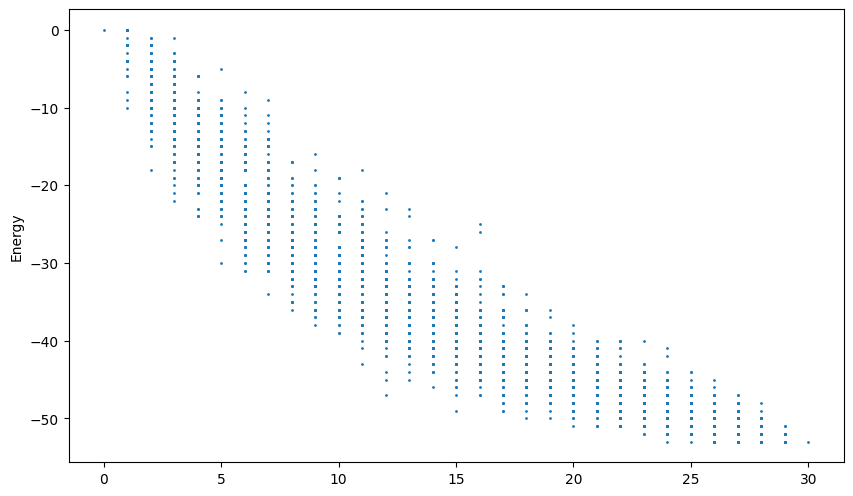

Best found: [0, 2, 3, 4, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
count: 24
Energy: -53.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy 1.0252590000000001


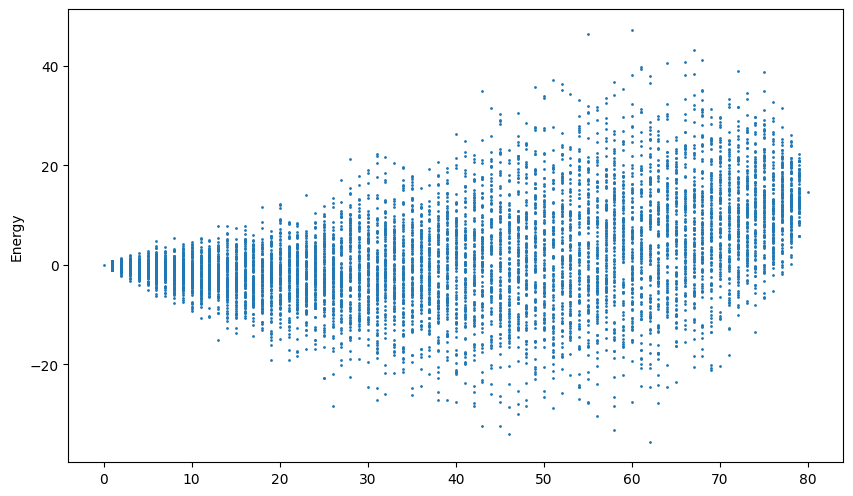

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 23, 24, 25, 26, 30, 33, 36, 37, 38, 39, 40, 41, 43, 44, 45, 46, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76]
count: 62
Energy: -35.549999999999436
Solutions Sampled: 7862
Ideal items: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 23, 24, 25, 26, 30, 33, 36, 37, 38, 39, 40, 41, 43, 44, 45, 46, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76]
Items energy: -35.549999999999436
max random 30


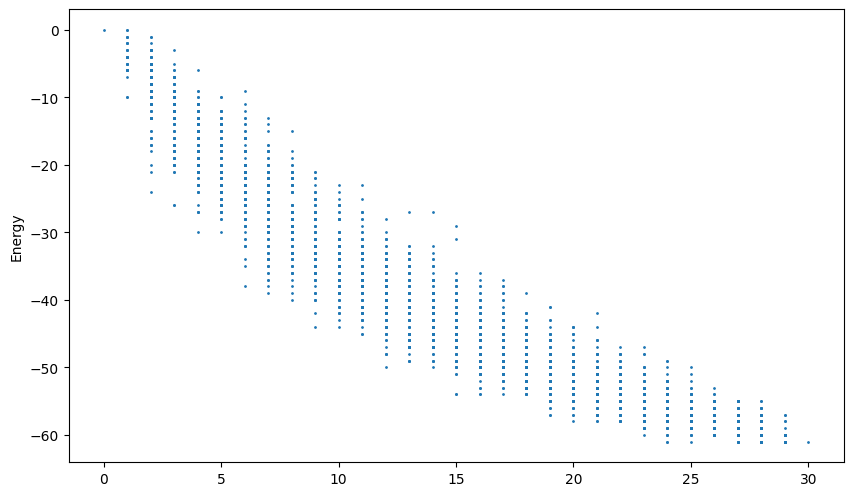

Best found: [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 28]
count: 24
Energy: -61.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 28]
Supplier Energy 1.8617730000000035


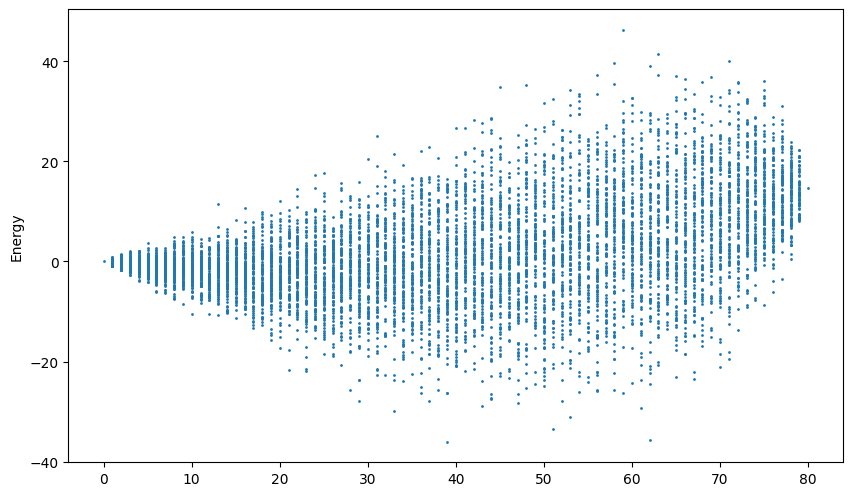

Best found: [2, 3, 5, 6, 7, 8, 10, 12, 14, 15, 22, 23, 26, 35, 38, 39, 40, 41, 43, 44, 46, 49, 51, 53, 55, 56, 57, 58, 59, 60, 61, 63, 69, 71, 73, 74, 76, 78, 79]
count: 39
Energy: -36.00999999999993
Solutions Sampled: 7862
Ideal items: [2, 3, 5, 6, 7, 8, 10, 12, 14, 15, 22, 23, 26, 35, 38, 39, 40, 41, 43, 44, 46, 49, 51, 53, 55, 56, 57, 58, 59, 60, 61, 63, 69, 71, 73, 74, 76, 78, 79]
Items energy: -36.00999999999993
max random 30


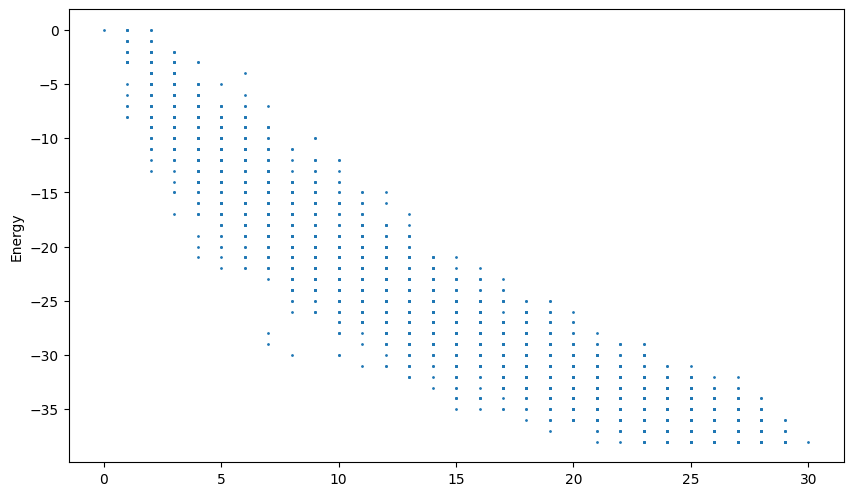

Best found: [0, 1, 2, 3, 4, 6, 8, 9, 11, 12, 13, 14, 17, 18, 20, 21, 22, 24, 26, 27, 29]
count: 21
Energy: -38.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 8, 9, 11, 12, 13, 14, 17, 18, 20, 21, 22, 24, 26, 27, 29]
Supplier Energy -0.608580999999997


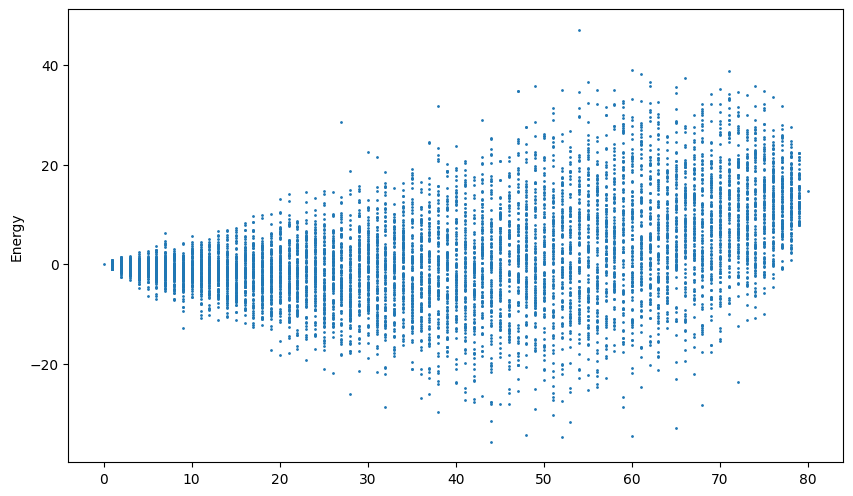

Best found: [4, 5, 8, 10, 11, 12, 13, 14, 17, 18, 19, 20, 23, 24, 25, 26, 27, 30, 35, 37, 38, 39, 41, 45, 48, 50, 51, 53, 54, 55, 56, 57, 61, 62, 63, 65, 68, 69, 70, 71, 72, 73, 74, 79]
count: 44
Energy: -35.599999999999866
Solutions Sampled: 7862
Ideal items: [4, 5, 8, 10, 11, 12, 13, 14, 17, 18, 19, 20, 23, 24, 25, 26, 27, 30, 35, 37, 38, 39, 41, 45, 48, 50, 51, 53, 54, 55, 56, 57, 61, 62, 63, 65, 68, 69, 70, 71, 72, 73, 74, 79]
Items energy: -35.599999999999866
max random 30


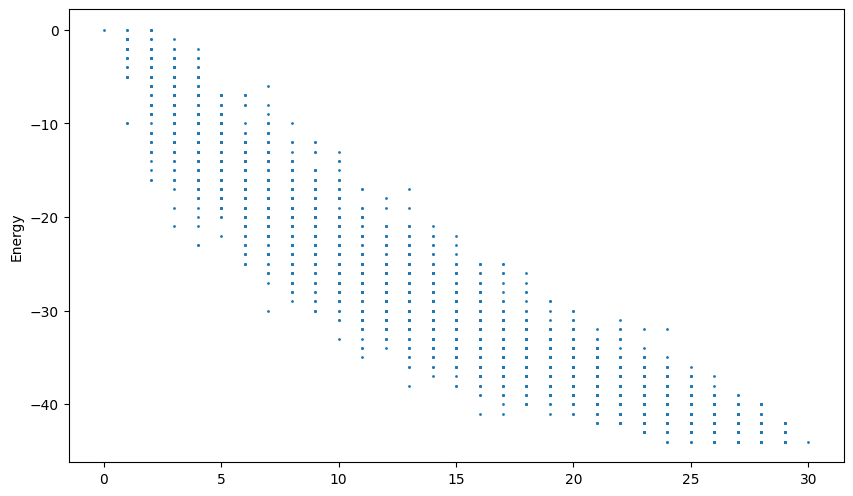

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27]
count: 24
Energy: -44.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27]
Supplier Energy 1.7653700000000052


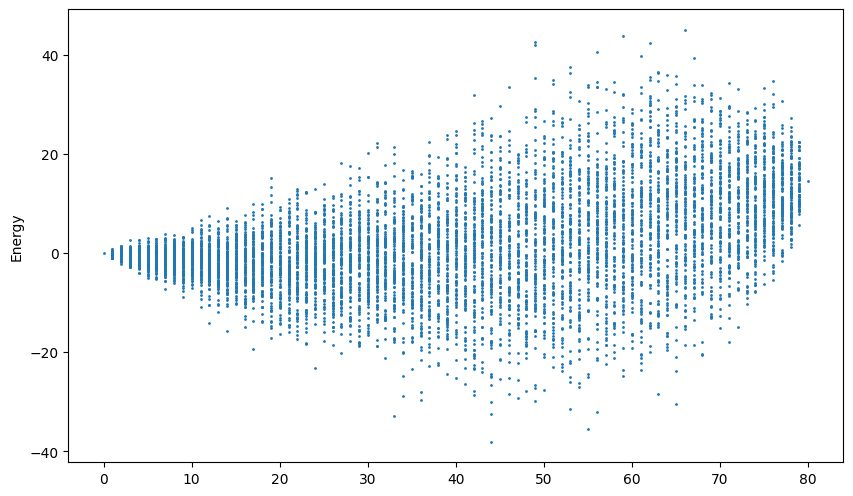

Best found: [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 19, 20, 25, 26, 32, 35, 37, 42, 45, 46, 47, 48, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 66, 70, 71, 72, 73, 74, 78]
count: 44
Energy: -38.0599999999999
Solutions Sampled: 7862
Ideal items: [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 19, 20, 25, 26, 32, 35, 37, 42, 45, 46, 47, 48, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 66, 70, 71, 72, 73, 74, 78]
Items energy: -38.0599999999999
max random 30


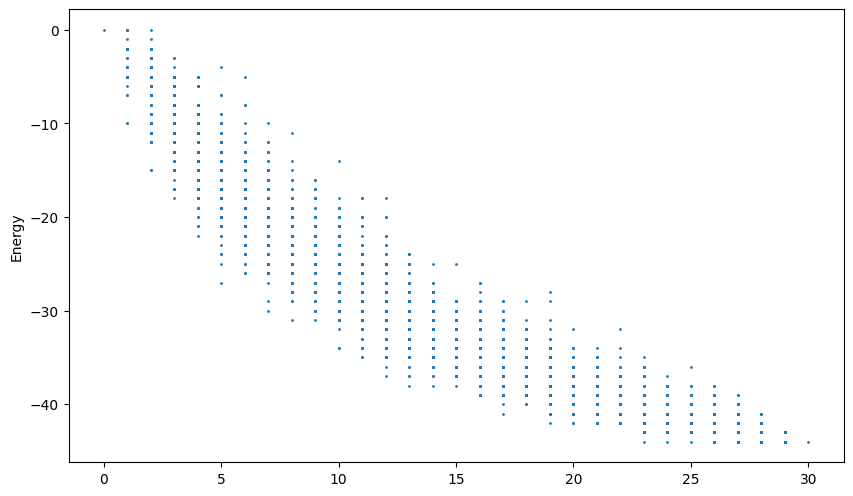

Best found: [0, 1, 2, 3, 8, 9, 10, 11, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29]
count: 23
Energy: -44.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 8, 9, 10, 11, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29]
Supplier Energy 2.2148230000000027


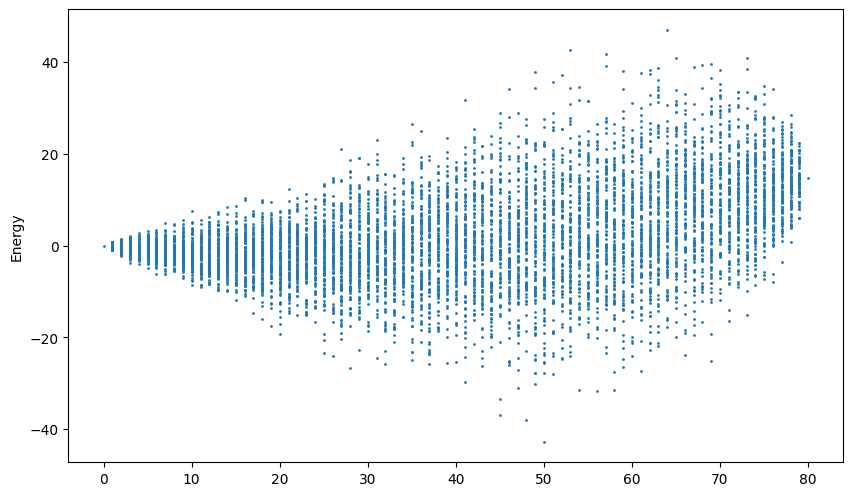

Best found: [2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 15, 19, 21, 23, 27, 32, 33, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 49, 50, 52, 53, 54, 55, 56, 57, 58, 61, 63, 64, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
count: 50
Energy: -42.759999999999614
Solutions Sampled: 7862
Ideal items: [2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 15, 19, 21, 23, 27, 32, 33, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 49, 50, 52, 53, 54, 55, 56, 57, 58, 61, 63, 64, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Items energy: -42.759999999999614
max random 30


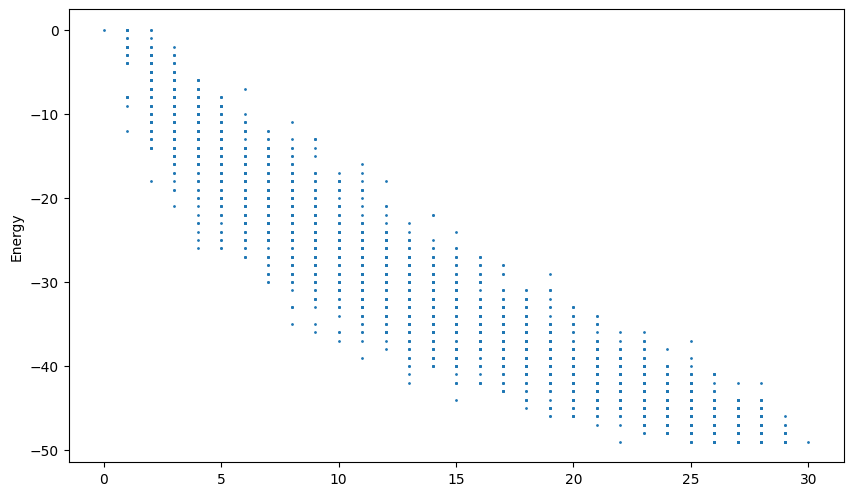

Best found: [0, 2, 3, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28]
count: 22
Energy: -49.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28]
Supplier Energy -0.646937


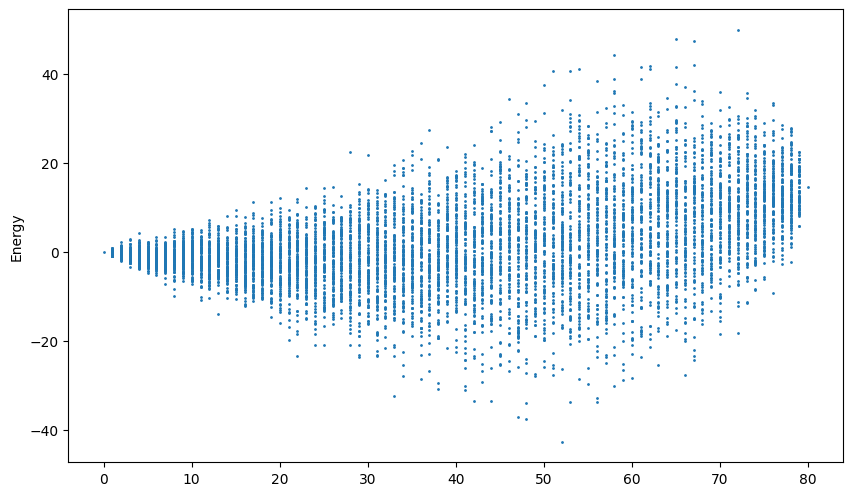

Best found: [0, 1, 2, 3, 4, 6, 7, 9, 10, 12, 13, 14, 15, 19, 21, 23, 24, 26, 27, 31, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 50, 52, 55, 56, 57, 58, 63, 64, 65, 66, 69, 70, 72, 74, 75, 78, 79]
count: 52
Energy: -42.6099999999998
Solutions Sampled: 7862
Ideal items: [0, 1, 2, 3, 4, 6, 7, 9, 10, 12, 13, 14, 15, 19, 21, 23, 24, 26, 27, 31, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 50, 52, 55, 56, 57, 58, 63, 64, 65, 66, 69, 70, 72, 74, 75, 78, 79]
Items energy: -42.6099999999998
max random 30


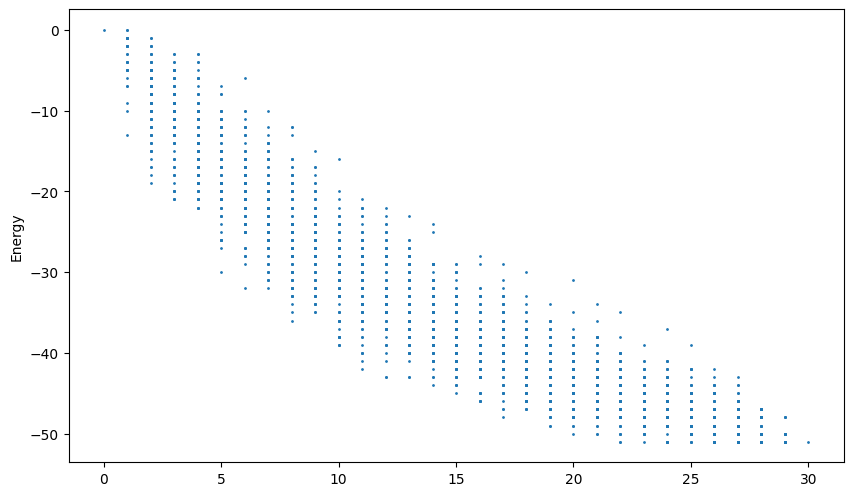

Best found: [0, 2, 3, 5, 8, 9, 10, 11, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29]
count: 22
Energy: -51.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 5, 8, 9, 10, 11, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29]
Supplier Energy 0.657782999999999


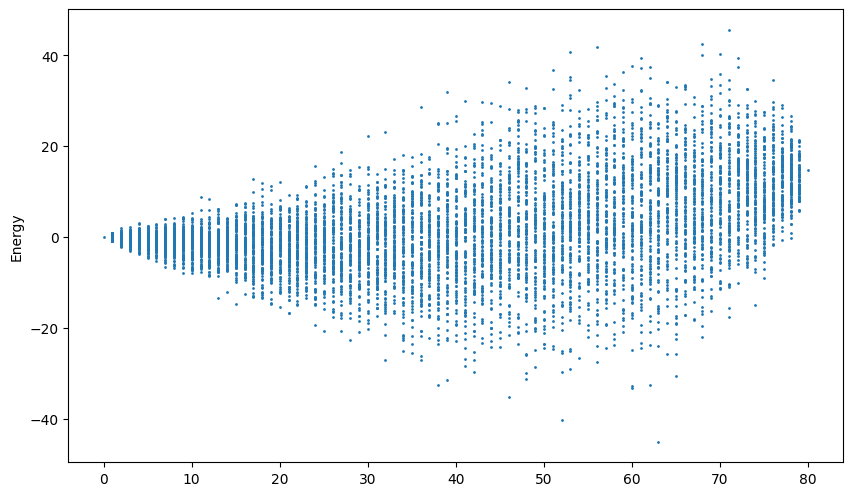

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 34, 35, 37, 38, 39, 40, 42, 43, 44, 46, 47, 48, 50, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 66, 68, 69, 70, 71, 72, 73, 74, 78, 79]
count: 63
Energy: -45.089999999999286
Solutions Sampled: 7862
Ideal items: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 34, 35, 37, 38, 39, 40, 42, 43, 44, 46, 47, 48, 50, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 66, 68, 69, 70, 71, 72, 73, 74, 78, 79]
Items energy: -45.089999999999286
max random 30


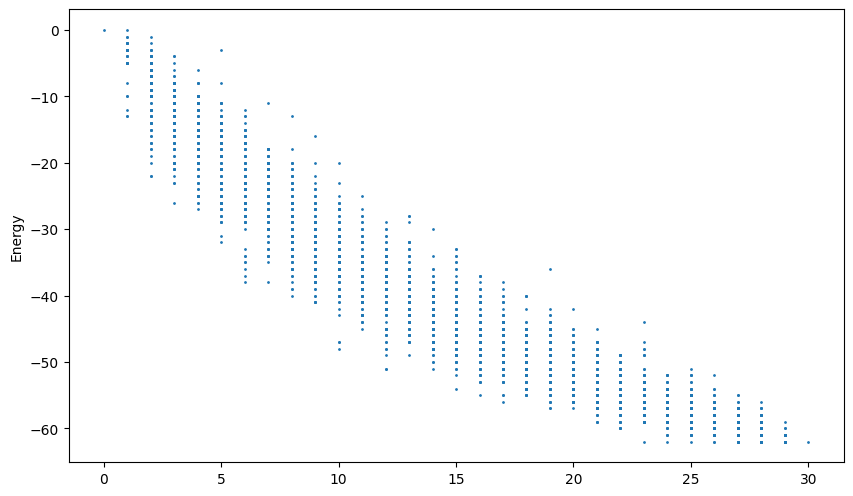

Best found: [0, 2, 3, 4, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
count: 23
Energy: -62.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy -0.755560999999999


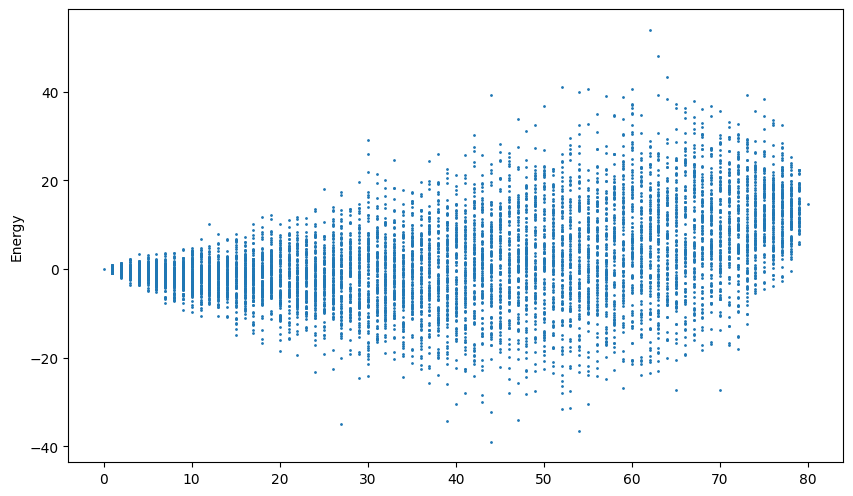

Best found: [0, 2, 5, 6, 8, 9, 10, 11, 13, 18, 19, 20, 22, 23, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 42, 43, 46, 49, 51, 52, 53, 56, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 78]
count: 44
Energy: -38.949999999999925
Solutions Sampled: 7862
Ideal items: [0, 2, 5, 6, 8, 9, 10, 11, 13, 18, 19, 20, 22, 23, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 42, 43, 46, 49, 51, 52, 53, 56, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 78]
Items energy: -38.949999999999925
max random 30


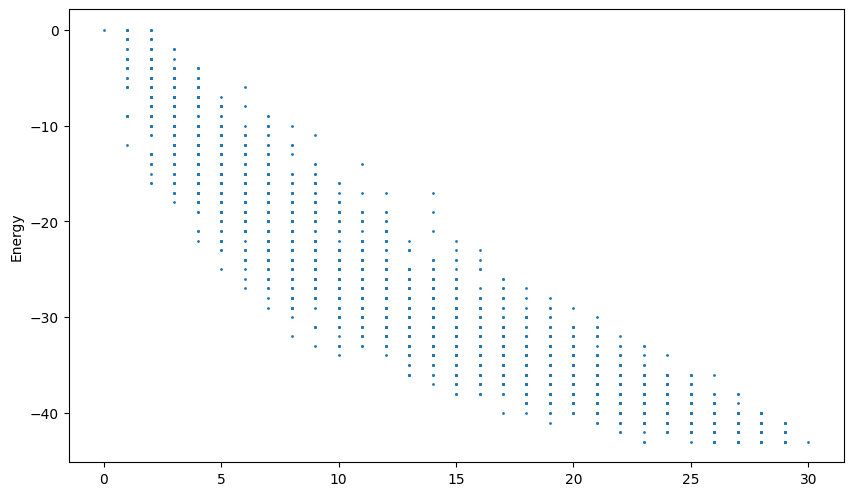

Best found: [0, 1, 2, 3, 5, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28]
count: 23
Energy: -43.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 5, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28]
Supplier Energy 1.4411240000000007


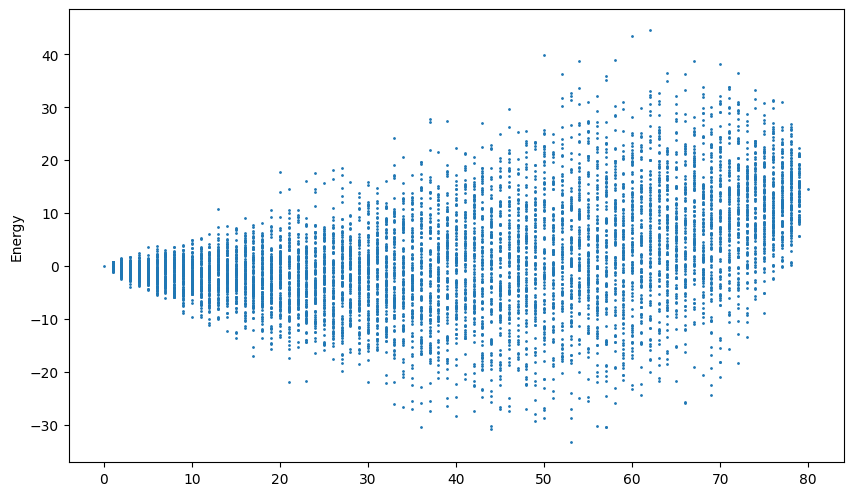

Best found: [1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 15, 20, 22, 23, 25, 26, 28, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 49, 51, 54, 55, 56, 57, 58, 59, 60, 62, 63, 66, 67, 69, 70, 71, 72, 73, 75, 76, 77, 79]
count: 53
Energy: -33.129999999999704
Solutions Sampled: 7862
Ideal items: [1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 15, 20, 22, 23, 25, 26, 28, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 49, 51, 54, 55, 56, 57, 58, 59, 60, 62, 63, 66, 67, 69, 70, 71, 72, 73, 75, 76, 77, 79]
Items energy: -33.129999999999704
max random 30


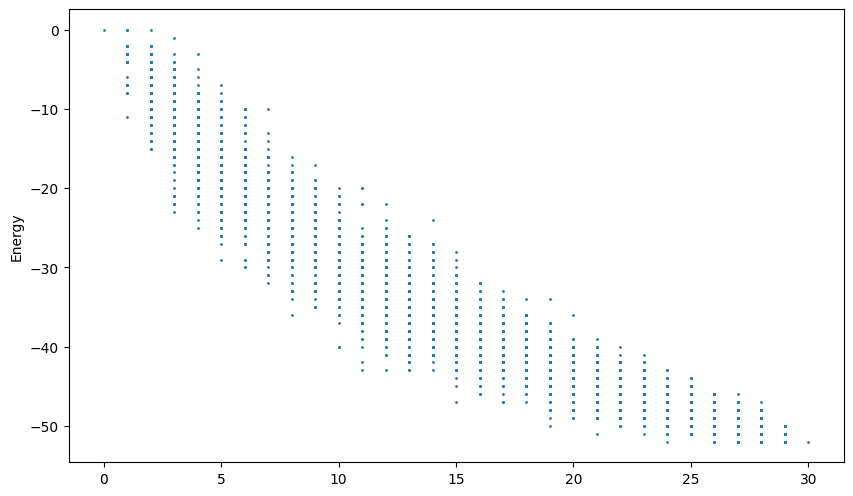

Best found: [0, 1, 2, 3, 4, 7, 8, 10, 12, 13, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
count: 24
Energy: -52.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 7, 8, 10, 12, 13, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy 3.8483440000000066


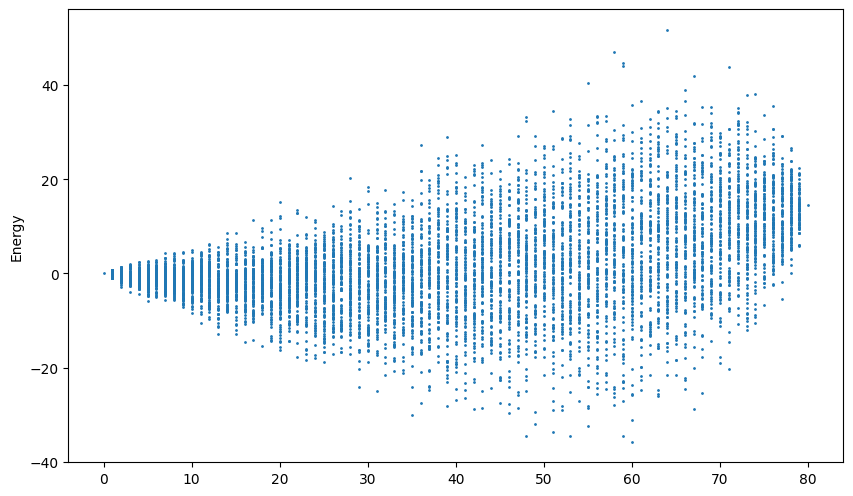

Best found: [0, 1, 2, 3, 4, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 26, 27, 28, 29, 30, 33, 34, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 48, 49, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 76, 78, 79]
count: 60
Energy: -35.729999999999656
Solutions Sampled: 7862
Ideal items: [0, 1, 2, 3, 4, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 26, 27, 28, 29, 30, 33, 34, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 48, 49, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 76, 78, 79]
Items energy: -35.729999999999656
max random 30


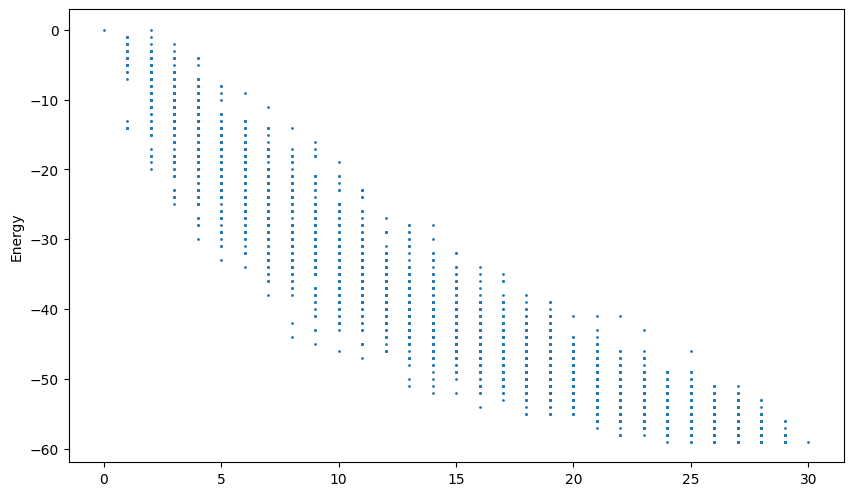

Best found: [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
count: 24
Energy: -59.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy 0.8512290000000001


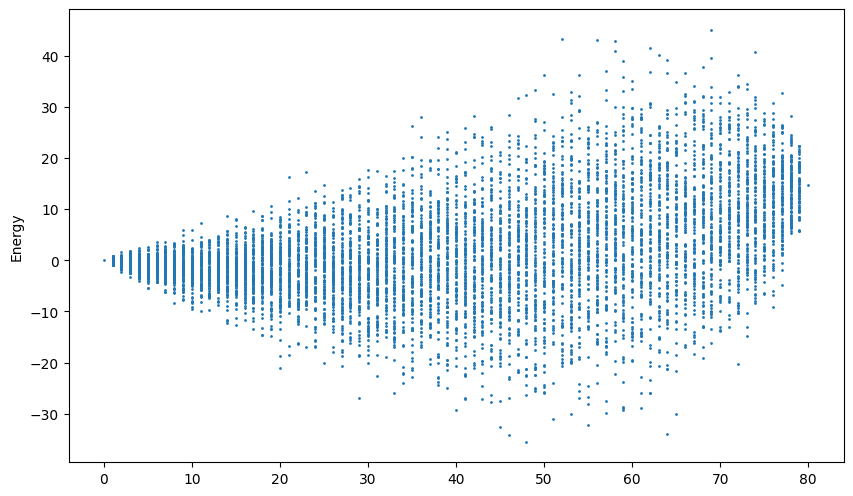

Best found: [0, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 24, 25, 26, 30, 32, 33, 34, 37, 38, 39, 41, 42, 43, 45, 48, 51, 52, 54, 55, 56, 57, 59, 61, 62, 64, 65, 67, 68, 69, 70, 71, 72, 76]
count: 48
Energy: -35.45999999999947
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 24, 25, 26, 30, 32, 33, 34, 37, 38, 39, 41, 42, 43, 45, 48, 51, 52, 54, 55, 56, 57, 59, 61, 62, 64, 65, 67, 68, 69, 70, 71, 72, 76]
Items energy: -35.45999999999947
max random 30


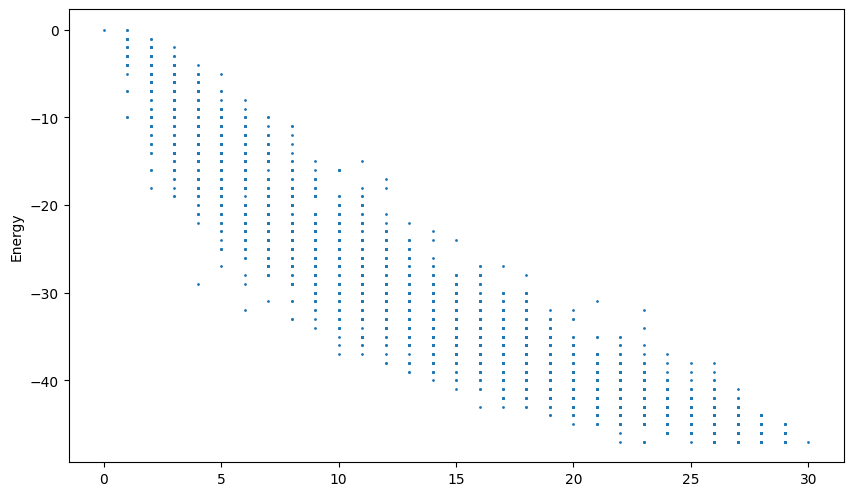

Best found: [0, 1, 2, 3, 4, 6, 8, 9, 11, 12, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29]
count: 22
Energy: -47.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 8, 9, 11, 12, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29]
Supplier Energy 2.3515430000000057


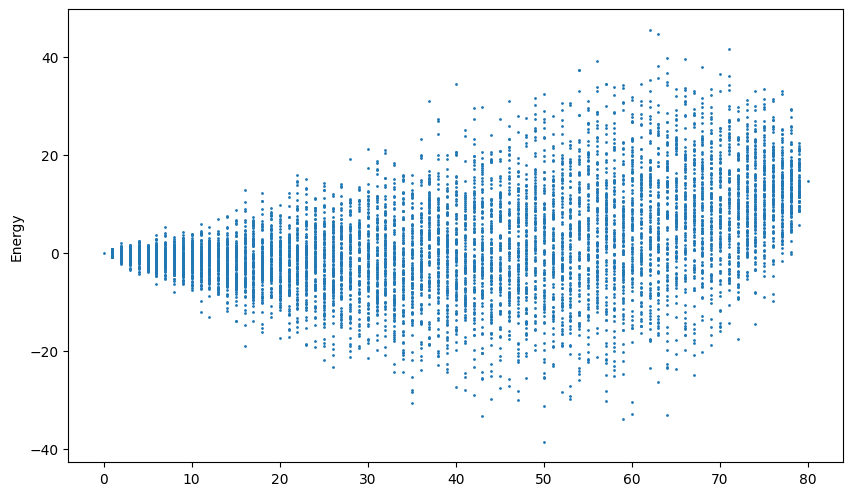

Best found: [3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 18, 20, 22, 23, 24, 25, 26, 31, 32, 33, 34, 37, 38, 39, 40, 41, 43, 44, 46, 47, 48, 50, 54, 55, 56, 57, 61, 62, 63, 64, 65, 67, 69, 70, 71, 73, 79]
count: 50
Energy: -38.579999999999764
Solutions Sampled: 7862
Ideal items: [3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 18, 20, 22, 23, 24, 25, 26, 31, 32, 33, 34, 37, 38, 39, 40, 41, 43, 44, 46, 47, 48, 50, 54, 55, 56, 57, 61, 62, 63, 64, 65, 67, 69, 70, 71, 73, 79]
Items energy: -38.579999999999764
max random 30


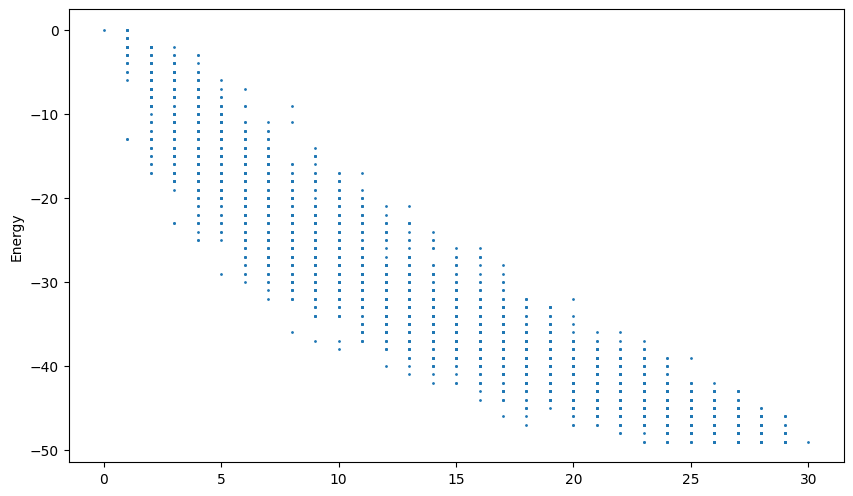

Best found: [0, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 17, 18, 20, 21, 23, 24, 25, 27, 28, 29]
count: 23
Energy: -49.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 17, 18, 20, 21, 23, 24, 25, 27, 28, 29]
Supplier Energy -1.2595799999999995


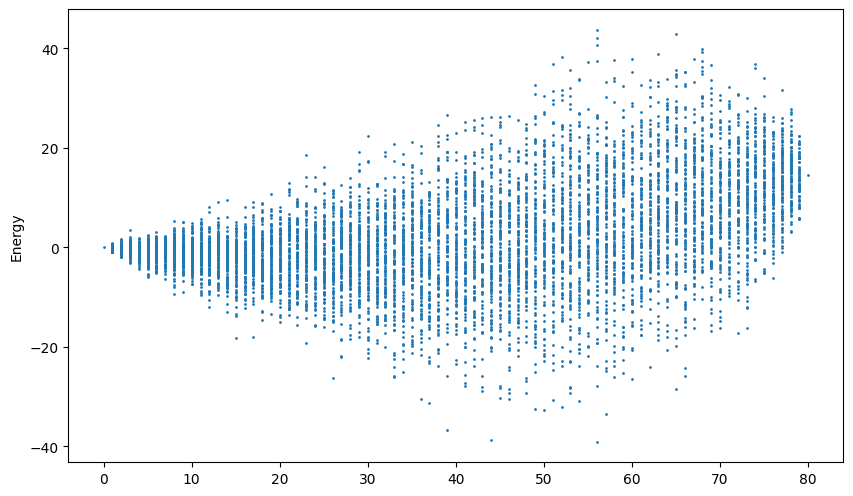

Best found: [1, 2, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 25, 26, 27, 30, 33, 34, 35, 36, 37, 38, 39, 40, 42, 43, 44, 48, 49, 50, 53, 54, 55, 56, 57, 58, 61, 63, 64, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78]
count: 56
Energy: -39.04999999999926
Solutions Sampled: 7862
Ideal items: [1, 2, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 25, 26, 27, 30, 33, 34, 35, 36, 37, 38, 39, 40, 42, 43, 44, 48, 49, 50, 53, 54, 55, 56, 57, 58, 61, 63, 64, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78]
Items energy: -39.04999999999926
max random 30


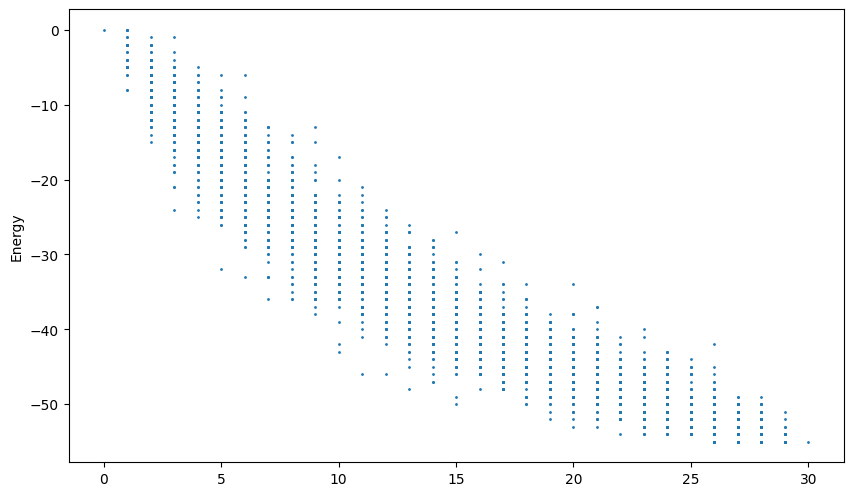

Best found: [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29]
count: 26
Energy: -55.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29]
Supplier Energy 3.8429030000000073


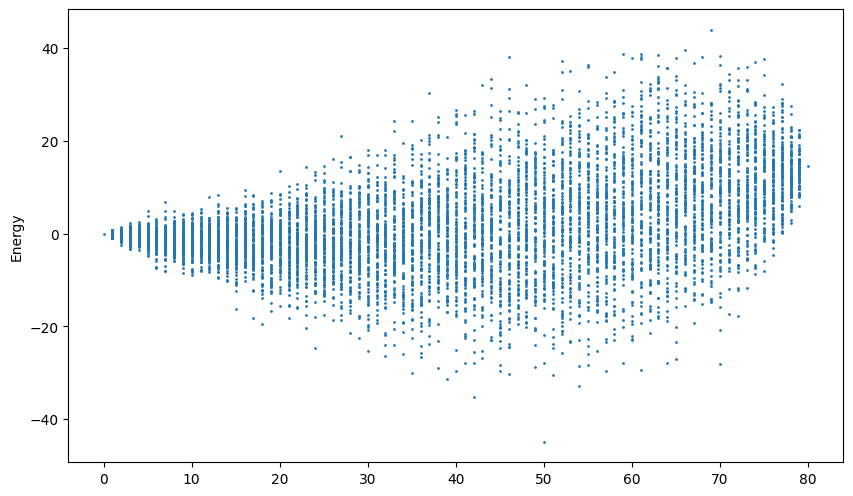

Best found: [0, 1, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 23, 26, 28, 32, 34, 35, 37, 38, 39, 41, 42, 43, 44, 46, 47, 49, 52, 53, 54, 55, 56, 57, 58, 61, 63, 65, 67, 69, 70, 71, 72, 78]
count: 50
Energy: -44.839999999999584
Solutions Sampled: 7862
Ideal items: [0, 1, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 23, 26, 28, 32, 34, 35, 37, 38, 39, 41, 42, 43, 44, 46, 47, 49, 52, 53, 54, 55, 56, 57, 58, 61, 63, 65, 67, 69, 70, 71, 72, 78]
Items energy: -44.839999999999584
max random 30


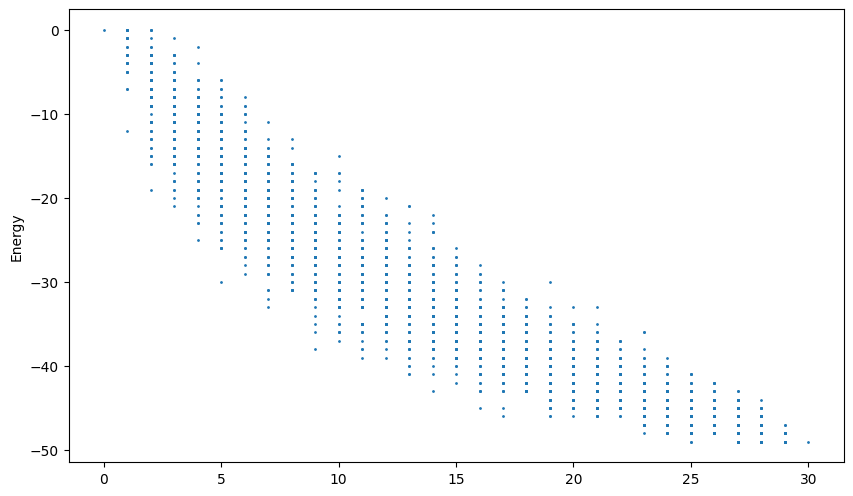

Best found: [0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
count: 25
Energy: -49.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy 2.439394000000006


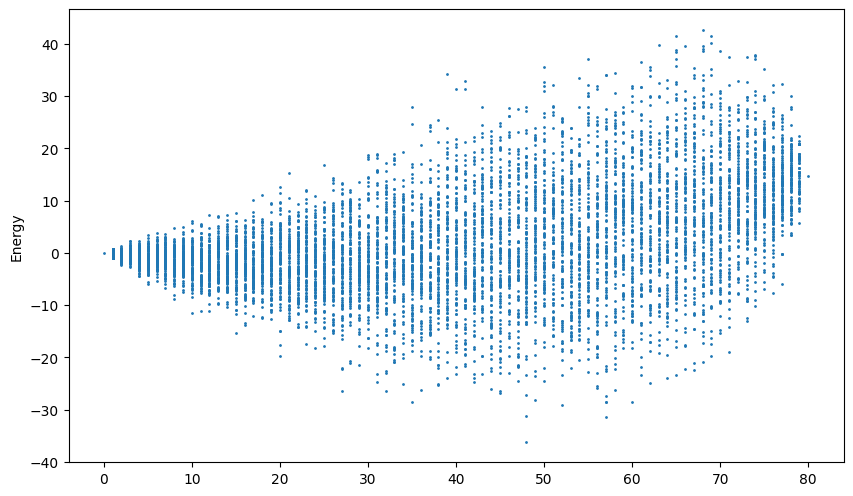

Best found: [1, 2, 5, 7, 8, 9, 10, 11, 13, 15, 19, 21, 23, 24, 25, 26, 29, 32, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 49, 50, 54, 55, 56, 57, 58, 59, 60, 61, 64, 66, 67, 69, 70, 71, 73, 77, 79]
count: 48
Energy: -36.119999999999436
Solutions Sampled: 7862
Ideal items: [1, 2, 5, 7, 8, 9, 10, 11, 13, 15, 19, 21, 23, 24, 25, 26, 29, 32, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 46, 49, 50, 54, 55, 56, 57, 58, 59, 60, 61, 64, 66, 67, 69, 70, 71, 73, 77, 79]
Items energy: -36.119999999999436
max random 30


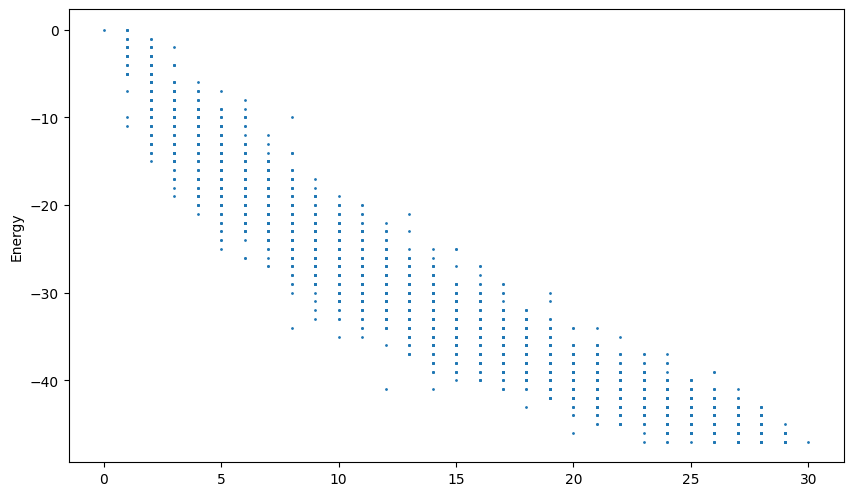

Best found: [0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28]
count: 23
Energy: -47.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28]
Supplier Energy 1.04528


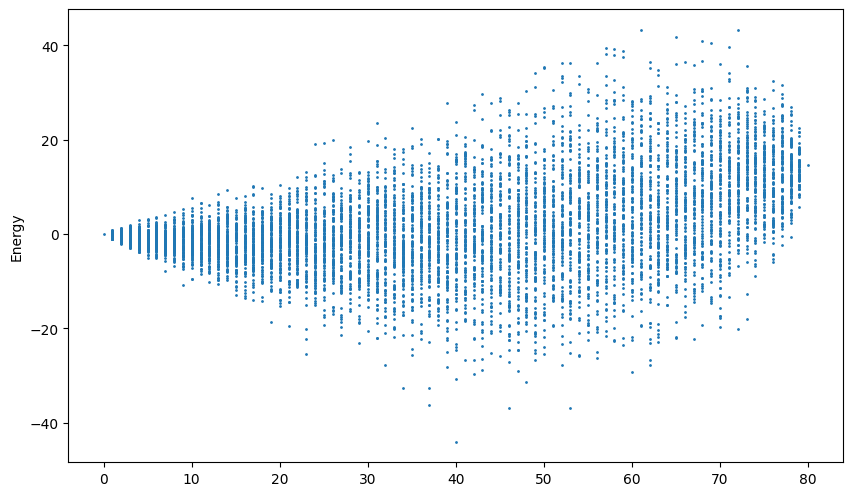

Best found: [0, 2, 3, 4, 7, 8, 9, 10, 11, 14, 15, 19, 23, 24, 26, 27, 28, 29, 34, 36, 39, 40, 43, 45, 48, 49, 50, 52, 55, 56, 57, 58, 61, 63, 65, 66, 69, 70, 73, 74]
count: 40
Energy: -44.009999999999884
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 4, 7, 8, 9, 10, 11, 14, 15, 19, 23, 24, 26, 27, 28, 29, 34, 36, 39, 40, 43, 45, 48, 49, 50, 52, 55, 56, 57, 58, 61, 63, 65, 66, 69, 70, 73, 74]
Items energy: -44.009999999999884
max random 30


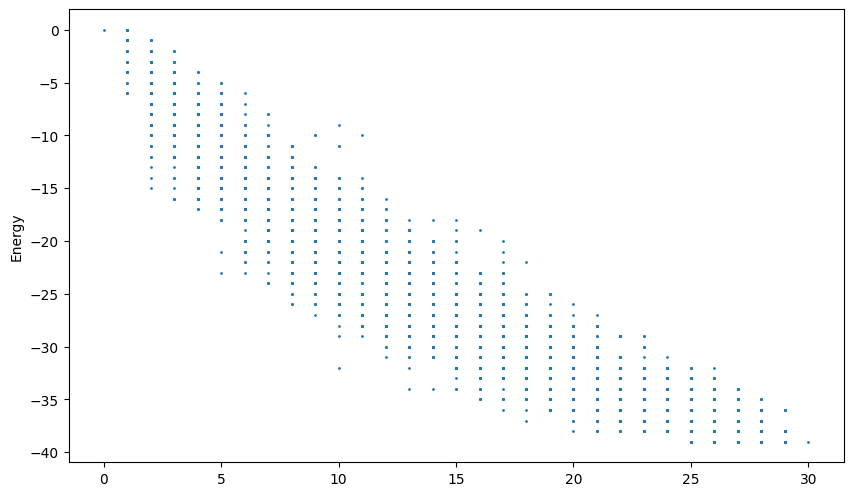

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 20, 21, 22, 24, 25, 26, 27, 29]
count: 25
Energy: -39.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 20, 21, 22, 24, 25, 26, 27, 29]
Supplier Energy 1.8051800000000027


In [60]:

plot_sup2=[]
plot_prod2=[]
total=20
for trials in range(total):
    #ideal items from Mi
    p_items=ProbabilisticSampler(Mi,100)
    print('Ideal items:', p_items[0])
    print('Items energy:', p_items[1])
    plot_prod2.append(p_items[1])
    # now find suppliers that cover these items:
    # this is a set cover problem
    
    sup_list=SetCoverSampler(Ma,p_items[0],100)
    print('Min Suppliers to cover items:',sup_list[0])
    sup_energy=0
    for i in sup_list[0]:
        for j in sup_list[0]:
            if i<=j:
                sup_energy+=Ms[i,j]
    print('Supplier Energy',sup_energy)
    
    plot_sup2.append(sup_energy)

Text(0.5, 1.0, 'Find optimal supplier and product')

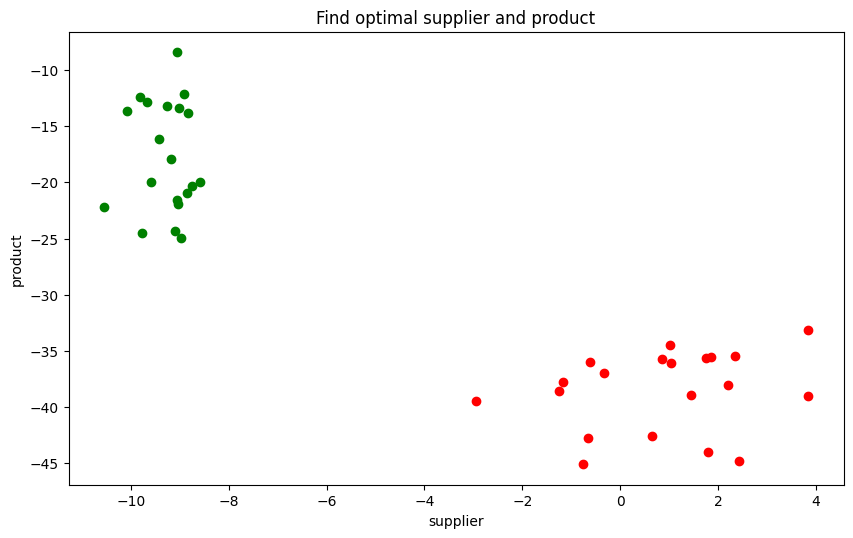

In [61]:
# now plot
figure(figsize=(10, 6), dpi=100)
plt.scatter(plot_sup1,plot_prod1,color='green')
plt.scatter(plot_sup2,plot_prod2,color='red')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

## Evaluate the optimal values using D-Wave annealer

In [ ]:
# Optimizing for Scenario A

In [62]:
dwave_plot_sup1=[]
dwave_plot_prod1=[]

sup_result=run_dwave(Ms,0.5)

Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
26843545600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 ... 29     energy num_oc. ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.68817      68 ...
2138  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.68817       1 ...
3281  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.68817       1 ...
1     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515      40 ...
3367  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515       1 ...
3402  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515       1 ...
4755  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515       1 ...
2     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314      32 ...
3     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  1  -11.54137      38 ...
3299  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  1  -11.54137       1 .

In [63]:
i=sup_result.first
print(i)
print(i.sample[0])

Sample(sample={0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 0, 13: 0, 14: 1, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0, 20: 1, 21: 1, 22: 0, 23: 0, 24: 0, 25: 0, 26: 0, 27: 0, 28: 1, 29: 0}, energy=-11.688170000000003, num_occurrences=68, chain_break_fraction=0.0)
1


In [64]:
first_sup=sup_result.first    
sup_list=[]
for s in range(len(Ms)):
    if first_sup.sample[s]==1:
        sup_list.append(s)
print(sup_list)
print('Supplier energy', first_sup[1])
dwave_plot_sup1.append(first_sup[1])    
a=availability(sup_list,Ma)
print('Items available:',len(a),a)   
m_i=item_m(a, Mi)
print(np.shape(m_i))
item_result=run_dwave(m_i,0.5)

[0, 5, 6, 7, 8, 9, 10, 11, 14, 20, 21, 28]
Supplier energy -11.688170000000003
Items available: 54 [ 0  1  2  3  5  8  9 13 15 16 17 18 20 22 23 24 25 27 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 66 69 70
 74 75 76 77 78 79]
(54, 54)
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
450359962737049600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 ... 53 energy num_oc. ...
6     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97       5 ...
272   0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97       1 ...
543   0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97       1 ...
1242  0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97       1 ...
3028  0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97       1 ...
9     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.94      12 ...
239   0  1  1  1  1  1  1  1  1  0  0  0  0

In [65]:
print(item_result.first)

Sample(sample={0: 0, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 1, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0, 20: 0, 21: 0, 22: 0, 23: 1, 24: 0, 25: 0, 26: 1, 27: 1, 28: 1, 29: 1, 30: 0, 31: 1, 32: 1, 33: 0, 34: 0, 35: 0, 36: 0, 37: 0, 38: 0, 39: 0, 40: 0, 41: 1, 42: 0, 43: 1, 44: 1, 45: 0, 46: 1, 47: 1, 48: 1, 49: 1, 50: 0, 51: 1, 52: 1, 53: 1}, energy=-38.969999999999885, num_occurrences=1, chain_break_fraction=0.037037037037037035)


In [66]:
first_item=item_result.first
itm_list=[]
for s in range(len(m_i)):
    if first_item.sample[s]==1:
        itm_list.append(s)
print('items:',itm_list)
i_item=np.zeros(len(itm_list))
for i in range(len(itm_list)):
    i_item[i]=a[itm_list[i]]
print('Items in solution:',i_item)
#print('count', len(p_items[0]))
print('Item Energy:', first_item[1])
dwave_plot_prod1.append(first_item[1])

items: [1, 2, 3, 4, 5, 6, 7, 8, 14, 16, 23, 26, 27, 28, 29, 31, 32, 41, 43, 44, 46, 47, 48, 49, 51, 52, 53]
Items in solution: [ 1.  2.  3.  5.  8.  9. 13. 15. 23. 25. 34. 37. 38. 39. 40. 42. 44. 53.
 57. 58. 69. 70. 74. 75. 77. 78. 79.]
Item Energy: -38.969999999999885


Text(0.5, 1.0, 'Find optimal supplier and product')

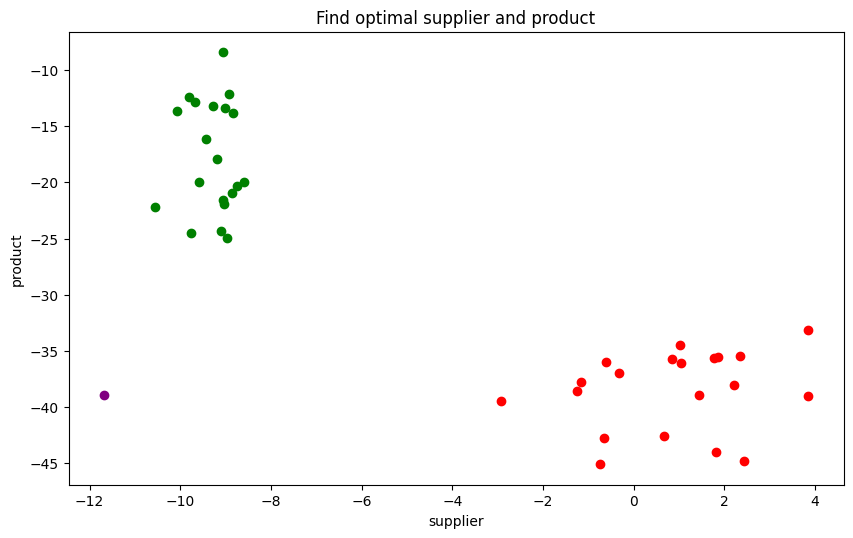

In [67]:
# now plot
figure(figsize=(10, 6), dpi=100)
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='purple')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='green')
plt.scatter(plot_sup2,plot_prod2,color='red')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

In [68]:
# Optimizing for Scenario B

In [69]:
dwave_plot_sup2=[]
dwave_plot_prod2=[]

In [70]:
#ideal items from Mi
item_results=run_dwave(Mi,0.5)

Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
30223145490365729367654400
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 ... 79 energy num_oc. ...
8     0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
9     0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
14    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       2 ...
68    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
176   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       2 ...
213   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
244   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
310   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
317   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
632   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39      

In [71]:
first_item=item_results.first
itm_list=[]
for s in range(len(Mi)):
    if first_item.sample[s]==1:
        itm_list.append(s)
print('items:',itm_list)
print('Supplier energy', first_item[1])
dwave_plot_prod2.append(first_item[1])

items: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 19, 25, 26, 34, 37, 38, 39, 40, 41, 42, 43, 44, 46, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Supplier energy -90.38999999999956


max random 30


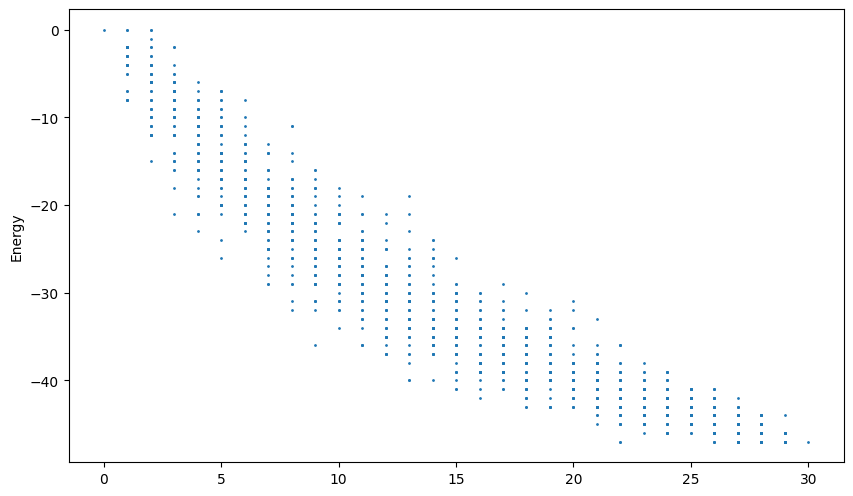

Best found: [0, 1, 2, 3, 4, 6, 7, 8, 9, 13, 14, 15, 16, 17, 18, 20, 21, 23, 24, 26, 27, 29]
count: 22
Energy: -47.0
Solutions Sampled: 1412


In [72]:
sup_list=SetCoverSampler(Ma,itm_list,50)

In [73]:
print('Min Suppliers to cover items:',sup_list[0])
sup_energy=0
for i in sup_list[0]:
    for j in sup_list[0]:
        if i<=j:
            sup_energy+=Ms[i,j]
print('Supplier Energy',sup_energy)

dwave_plot_sup2.append(sup_energy)

Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 7, 8, 9, 13, 14, 15, 16, 17, 18, 20, 21, 23, 24, 26, 27, 29]
Supplier Energy -0.16731999999999692


Text(0.5, 1.0, 'Find optimal supplier and product')

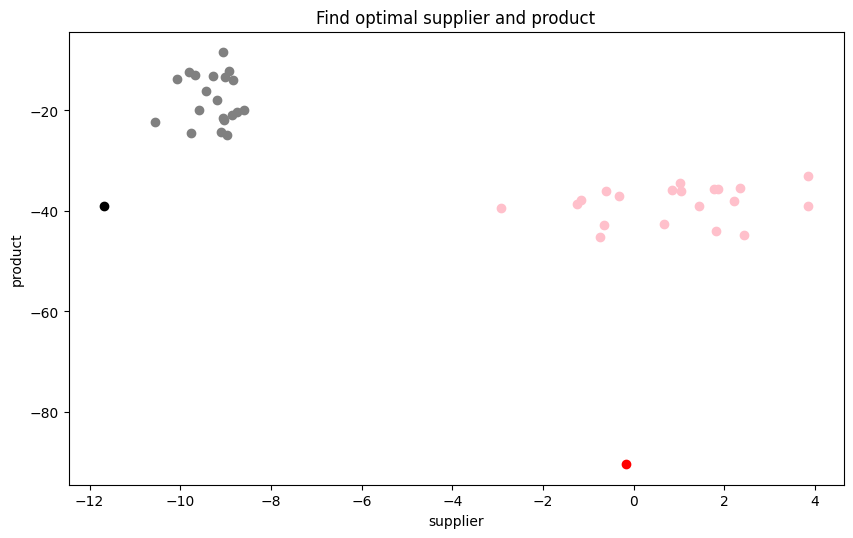

In [74]:
# now plot
figure(figsize=(10, 6), dpi=100)
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

## Determine a better global solution

### Evaluate with the classical probabilistic solver

In [75]:
A=0.5
S=2.5
I=0.5

Ma2=Ma.copy()
Ma2 = np.where(Ma2==1, -A, 0)
print(Ma2)
print(np.shape(Ma2))

[[ 0.   0.   0.  ...  0.   0.   0. ]
 [ 0.  -0.5  0.  ... -0.5  0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]
 ...
 [-0.5  0.   0.  ...  0.   0.   0. ]
 [-0.5  0.  -0.5 ...  0.   0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]]
(30, 80)


In [76]:
Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
print('Mz',np.shape(Mz))
Msz=np.append(S*Ms, Mz, axis=0)
print('Msz',np.shape(Msz))

Mai=np.append(Ma2, I*Mi, axis=0)
print('Mai',np.shape(Mai))

Mf=np.append(Msz,Mai, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')

Mz (80, 30)
Msz (110, 30)
Mai (110, 80)
Mf (110, 110)
[[-3.25     0.08375  0.12275 ...  0.       0.       0.     ]
 [ 0.      -0.415    0.23575 ... -0.5      0.       0.     ]
 [ 0.       0.      -0.365   ...  0.       0.       0.     ]
 ...
 [ 0.       0.       0.      ... -0.195    0.35     0.01   ]
 [ 0.       0.       0.      ...  0.       0.1     -0.45   ]
 [ 0.       0.       0.      ...  0.       0.      -0.17   ]]


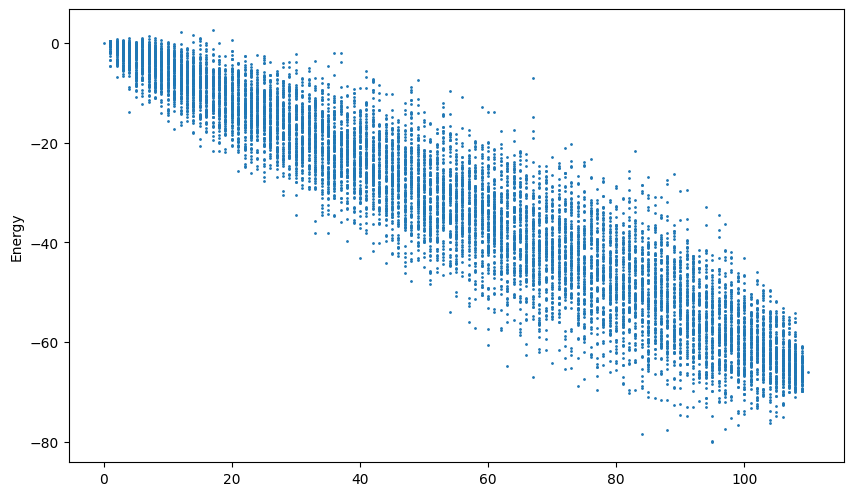

Best found: [0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 47, 48, 49, 50, 51, 52, 53, 54, 55, 58, 60, 61, 62, 63, 64, 66, 67, 68, 69, 70, 71, 72, 73, 75, 76, 77, 78, 79, 80, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 97, 98, 99, 100, 101, 103, 104, 105, 106, 107, 108, 109]
count: 95
Energy: -80.00992500000018
Solutions Sampled: 10902


In [77]:
result=ProbabilisticSampler(Mf,100)

In [78]:
sup_list=[]
item_list=[]
for i in (result[0]):
    if i<len(Ms):
        sup_list.append(i)
    else:
        item_list.append(i-len(Ms))

print(sup_list)

sup_energy=0
for i in sup_list:
    for j in sup_list:
        if i<=j:
            sup_energy+=Ms[i,j]
print('Supplier Energy',sup_energy)

print(item_list)

item_energy=0
for i in item_list:
    for j in item_list:
        if i<=j:
            item_energy+=Mi[i,j]
print('Item Energy',item_energy)

a=availability(sup_list,Ma)
print('all items available',a)

# Is this feasible:
if(np.isin(False,(np.isin(item_list,a)))):
    print('Not feasible')
    print(np.isin(item_list,a))
else:
    print('Feasible')
    

[0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
Supplier Energy -1.1539699999999968
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28, 30, 31, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 48, 49, 50, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 67, 68, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Item Energy -10.249999999999492
all items available [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47 48 49
 50 51 52 53 55 56 57 58 59 60 62 63 64 65 66 68 69 70 71 72 73 74 75 76
 77 78 79]
Not feasible
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True False  True  True  True  True  True  True  True  True False  True
  True  True

### Evaluate the best solution using D-Wave

In [79]:
A=0.5
S=2.5
I=0.5

Ma2=Ma.copy()
Ma2 = np.where(Ma2==1, -A, 0)
print(Ma2)
print(np.shape(Ma2))

Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
print('Mz',np.shape(Mz))
Msz=np.append(S*Ms, Mz, axis=0)
print('Msz',np.shape(Msz))

Mai=np.append(Ma2, I*Mi, axis=0)
print('Mai',np.shape(Mai))

Mf=np.append(Msz,Mai, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')


result=run_dwave(Mf,0.5)


[[ 0.   0.   0.  ...  0.   0.   0. ]
 [ 0.  -0.5  0.  ... -0.5  0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]
 ...
 [-0.5  0.   0.  ...  0.   0.   0. ]
 [-0.5  0.  -0.5 ...  0.   0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]]
(30, 80)
Mz (80, 30)
Msz (110, 30)
Mai (110, 80)
Mf (110, 110)
[[-3.25     0.08375  0.12275 ...  0.       0.       0.     ]
 [ 0.      -0.415    0.23575 ... -0.5      0.       0.     ]
 [ 0.       0.      -0.365   ...  0.       0.       0.     ]
 ...
 [ 0.       0.       0.      ... -0.195    0.35     0.01   ]
 [ 0.       0.       0.      ...  0.       0.1     -0.45   ]
 [ 0.       0.       0.      ...  0.       0.      -0.17   ]]
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
327   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1 -113.747975       1 ...
43    1  1  1  0  0  1  1  1  1 

In [80]:
dwave_plot_sup3=[]
dwave_plot_prod3=[]
dwave_plot_sup4=[]
dwave_plot_prod4=[]

for datum in (result.data()):
    sup_list=[]
    item_list=[]
    for s in range(len(Ms)):
        if datum.sample[s]==1:
            sup_list.append(s)
    
    
    for i in range(len(Ms),len(Ms)+len(Mi)):
        if datum.sample[i]==1:
            item_list.append(i-len(Ms))

    #print(sup_list)

    sup_energy=0
    for i in sup_list:
        for j in sup_list:
            if i<=j:
                sup_energy+=Ms[i,j]
    #print('Supplier Energy',sup_energy)

    #print(item_list)

    item_energy=0
    for i in item_list:
        for j in item_list:
            if i<=j:
                item_energy+=Mi[i,j]
    #print('Item Energy',item_energy)

    a=availability(sup_list,Ma)
    #print('all items available',a)

    # Is this feasible:
    if(np.isin(False,(np.isin(item_list,a)))):
        #print('Not feasible')
        #print(np.isin(item_list,a))
        dwave_plot_sup3.append(sup_energy)
        dwave_plot_prod3.append(item_energy)
    else:
        print('Feasible')
        print('suppliers:',sup_energy, sup_list)
        print('products:', item_energy, item_list)
        dwave_plot_sup4.append(sup_energy)
        dwave_plot_prod4.append(item_energy)


Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -72.45999999999951 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -73.86999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.44999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74,

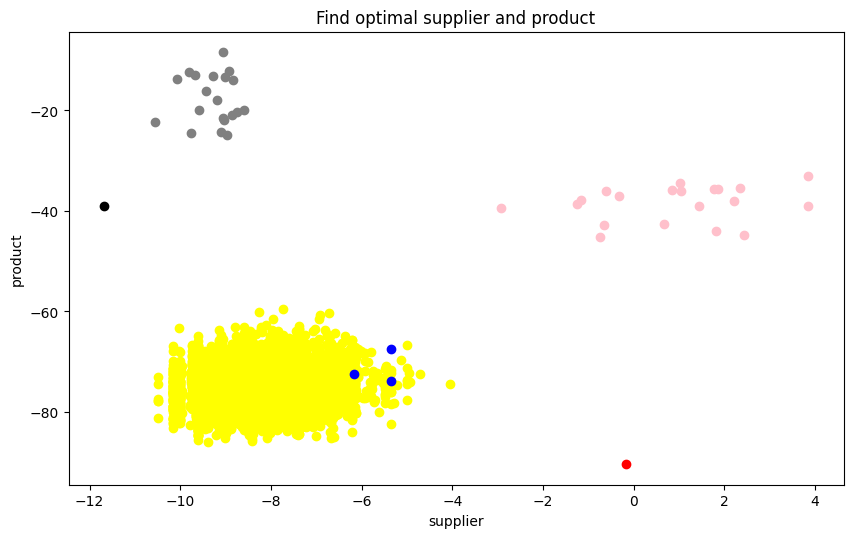

In [81]:
# now plot
figure(figsize=(10, 6), dpi=100)
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')

plt.scatter(dwave_plot_sup3,dwave_plot_prod3,color='yellow')
plt.scatter(dwave_plot_sup4,dwave_plot_prod4,color='blue')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()

In [82]:
dwave_plot_sup3=[]
dwave_plot_prod3=[]
dwave_plot_sup4=[]
dwave_plot_prod4=[]

save_sup_list=[]
save_sup_energy=[]
save_item_list=[]
save_item_energy=[]


for A in np.arange(0.5, 1.0, 0.2):
    for S in np.arange (2.0, 3.5, 0.5):
        for I in np.arange (0.5, 1.0, 0.2):
            print('Starting:',A,S,I)
            Ma2=Ma.copy()
            Ma2 = np.where(Ma2==1, -A, 0)
            Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
            Msz=np.append(S*Ms, Mz, axis=0)
            Mai=np.append(Ma2, I*Mi, axis=0)
            Mf=np.append(Msz,Mai, axis=1)

            result=run_dwave(Mf,0.5)

            for datum in (result.data()):
                sup_list=[]
                item_list=[]
                for s in range(len(Ms)):
                    if datum.sample[s]==1:
                        sup_list.append(s)


                for i in range(len(Ms),len(Ms)+len(Mi)):
                    if datum.sample[i]==1:
                        item_list.append(i-len(Ms))


                sup_energy=0
                for i in sup_list:
                    for j in sup_list:
                        if i<=j:
                            sup_energy+=Ms[i,j]


                item_energy=0
                for i in item_list:
                    for j in item_list:
                        if i<=j:
                            item_energy+=Mi[i,j]


                a=availability(sup_list,Ma)


                # Is this feasible:
                if(np.isin(False,(np.isin(item_list,a)))):

                    dwave_plot_sup3.append(sup_energy)
                    dwave_plot_prod3.append(item_energy)
                else:
                    print('Feasible')
                    print('suppliers:',sup_energy, sup_list)
                    print('products:', item_energy, item_list)
                    save_sup_energy.append(sup_energy)
                    save_sup_list.append(sup_list)
                    save_item_energy.append(item_energy)
                    save_item_list.append(item_list)
                    
                    dwave_plot_sup4.append(sup_energy)
                    dwave_plot_prod4.append(item_energy)


Starting: 0.5 2.0 0.5
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
20    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.7085       1 ...
3     1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.65112       1 ...
1632  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.5985       1 ...
261   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.4935       1 ...
7264  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.46666       1 ...
850   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.4235       1 ...
1249  1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.37112       1 ...
381   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.3585       1 ...
5717  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.3535       1 ...
357   1  1  1  0  0  1  1  1  1  1  1  1 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.67999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.29999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.17999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70

Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -75.73999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -70.71999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.23999999999948 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -66.32999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.330450000000001 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.3599999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -75.82999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.02999999999943 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.73999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.87999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 52, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 

Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -80.1499999999995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Starting: 0.5 2.0 0.8999999999999999
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
815   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -143.12838       1 ...
2406  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -143.12838       1 ...
2665  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -143.12838       1 ...
3767  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -143.12838       1 ...
46    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -143.11166       1 ...
286   1  0  0 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -81.94999999999942 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.79793 [0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -83.29999999999956 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.318259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -81.17999999999965 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 45, 46, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]

Starting: 0.5 2.5 0.7
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
134   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.314675       1 ...
1544  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.314675       1 ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.220675       1 ...
1184  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.220675       1 ...
3523  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.220675       1 ...
52    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
1732  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
2746  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
3063  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
1809  1  1  1  0  0  1  1  1  1  1  1  1 

Starting: 0.5 2.5 0.8999999999999999
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       3 ...
1     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       2 ...
38    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
68    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
130   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
175   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
226   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
280   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
498   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
576   1  0  0  0  0  1  1 

Starting: 0.5 3.0 0.5
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
7888  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.55921       1 ...
1272  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.49921       1 ...
29    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.45059       1 ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.42921       1 ...
5237  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.42421       1 ...
486   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.41421       1 ...
1508  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.35559       1 ...
3574  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.35421       1 ...
5301  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.35421       1 ...
4871  1  0  0  0  0  1  1  1  1  1  1  1 

Starting: 0.5 3.0 0.7
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
115   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.11621       1 ...
173   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.11621       1 ...
891   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.11621       1 ...
16    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
32    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
550   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
1393  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
2120  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
3816  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
39    1  0  0  0  0  1  1  1  1  1  1  1 

Starting: 0.5 3.0 0.8999999999999999
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
7     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
8     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
17    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
30    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
32    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
38    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
40    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
47    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
52    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.17621       1 ...
79    1  0  0  0  0  1  1 

Starting: 0.7 2.0 0.5
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
865   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -138.36996       1 ...
29    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
197   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
850   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
1927  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
24    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -138.26996       1 ...
3052  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -138.26996       1 ...
3586  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -138.26996       1 ...
6     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
46    1  1  1  0  0  1  1  1  1  1  1  1 

suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.80999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.19999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.19999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.05999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.01999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.58999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.92999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.529999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.1199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 

products: -64.15999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.74999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.70999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 7

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.28999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.2899999999992 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.269999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.649999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.60999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.7599999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.229999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.42999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.80999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.689999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.27999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.659999999999165 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 2

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.359999999999246 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.749999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.0499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -64.7399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.7799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.36999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.9599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.149999999999224 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.189999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.759999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.7599999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.499999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -59.969999999999274 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.64999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.649999999999345 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.279999999999276 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -59.47999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.01999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.55999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.92999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.2299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.9899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.9899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.9899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 7

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.76999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.75999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.75999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.4799999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.4799999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.47999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.39999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.39999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.39999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.65999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.21999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.21999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 6

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.51999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.51999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.51999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.3699999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.35999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.20999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.21999999999927 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.77999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.7799999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.66999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.66999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.66999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.5499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.54999999999939 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -68.42999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.86999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.41999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.84999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.28999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.28999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -71.16999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.15999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.15999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.58999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.04999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.46999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.89999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.89999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.89999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.1599999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.7199999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.7199999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.59999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.59999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.58999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.47999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.46999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.46999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 66

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.74999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.74999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.30999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.90999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.18999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.18999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58,

Feasible
suppliers: -3.50374 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 29]
products: -70.5799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.02999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.00999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.87999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.87999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.86999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.14999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.149999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 27, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.70999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46,

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.80999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.5099999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -70.37999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.67999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.23999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.23999999999944 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.0099999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.95999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.37999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.59999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.029999999999255 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.97999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -79.1699999999995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.58999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.5499999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 53, 55, 56, 57, 58, 63, 65, 66, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.67999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.6599999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.63999999999922 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 6

Feasible
suppliers: -3.8941600000000003 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.32999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.87999999999948 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.86999999999941 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 34, 36, 37, 38, 39, 40, 42, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.93999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.92999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 53, 55, 56, 57, 58, 60, 63, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.92999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.13999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.10999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.10999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.44999999999939 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.44999999999939 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.44999999999939 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -81.80999999999946 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -81.80999999999946 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.71999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.21999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.21999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.21999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53

suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.0199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.0199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.76999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.76999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.76999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.51999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.30999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.0999999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.00999999999948 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.00999999999948 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.98999999999941 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.65999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.65999999999937 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 5

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.05999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -79.08999999999943 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.3899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.7899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.8899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.76999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.35999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.35999999999945 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.23999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.35999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.35999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.00999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.63999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.52999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.5199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.8999999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.30999999999949 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.96999999999943 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.18999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.88999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.62999999999941 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.84999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.06999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.05999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.27999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.83999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -70.62999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 5

Feasible
suppliers: -4.2682400000000005 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 29]
products: -78.34999999999944 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.61999999999924 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.17999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 49, 50, 51, 

Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -75.2499999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.62999999999941 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.6899999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.20999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.96999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.18999999999926 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 49, 50, 51, 52, 53, 55, 56,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.91999999999945 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.35999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.51999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -67.82999999999939 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.53999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.64999999999951 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 42, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -57.939999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.79999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.59999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.77999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.2799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.26999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.929999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.28999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.449999999999235 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.83999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.83999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.33999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.61999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -58.21999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.62999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -61.94999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.1799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -51.75999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -55.05999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.29999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.509999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -58.259999999999295 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.939999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.719999999999274 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.43999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.43999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.27999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.97999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.7099999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -68.39999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.1599999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.849999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.0099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.59999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.379999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.30999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 5

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.3299999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.0399999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.4499999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76,

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.37999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -54.85999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Starting: 0.7 3.0 0.7
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
1670  1  1  1  0  0  

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.3199999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -6.56843 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.00999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -73.22999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 7

Starting: 0.8999999999999999 2.0 0.5
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
34    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
429   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
525   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
3378  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
9559  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
0     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.03082       1 ...
91    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.03082       1 ...
127   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.03082       1 ...
193   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.03082       1 ...
256   1  1  1  0  0  1  1 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.999999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -42.519999999999285 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -42.519999999999285 [0, 1, 2, 3, 4, 5, 6,

Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.90999999999898 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -41.55999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -41.55999999999917 [0, 1, 2, 3, 4, 5,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.53999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.33999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.33999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.20999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.39999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.39999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.919999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.689999999999024 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.489999999999085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9

Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.8199999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.8199999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.13120999999999866 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.58999999999917 [0, 1, 2, 3, 4,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.919999999999085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.39999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.689999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.43999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -38.12999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 30, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.20999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.71999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.51999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -43.209999999999155 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.7299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.8499999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -43.03999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.02999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.85999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.85999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.15999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.06999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.43999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.169999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.0299999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.14999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.5599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.64999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.23999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.709999999999056 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.509999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.689999999999095 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 1

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.33999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.97999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.79999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.509999999999124 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.10999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 29, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.7099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 1

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.60999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.38999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.68999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.13999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.23999999999903 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.86999999999897 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.169999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.46999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.33999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.19999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.73999999999903 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.96999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.55999999999899 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.609999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.17999999999907 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.2299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.119999999999074 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: 0.8029090000000033 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.25999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -42.84999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -45.09999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.53999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.39999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.01999999999903 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.21999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.86999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -43.07999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.80999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -41.41999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 27, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.89999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 32, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -37.56999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 

Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 30, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.069999999999055 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.99999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 

Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -45.95999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 29, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -41.80999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 30, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.999999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.999999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.999999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.299999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.299999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.00999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.769999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.849999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.849999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.029999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.029999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.029999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.92999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.92999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.92999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.92999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.20999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.62999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.85999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.769999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.769999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.79999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.699999999999115 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.569999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.229999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.229999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.229999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.16999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.16999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.16999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 2

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.32999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.889999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.759999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.56999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.509999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.509999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 4

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.70999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.98999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.8199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.5299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.51999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.51999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.7599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.779999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.4599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 2

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.72999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.92999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.65999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.289999999999054 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.28999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.28999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.88999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.22999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.52999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.10999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.07999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.529999999999035 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.09999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.71999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.80999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.13120999999999866 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.549999999999066 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.879999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.71999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.8699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.439999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26,

Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.94999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.93999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.99999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.46999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.709999999999056 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.21999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.75999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.46999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.2399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.23999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.52999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32,

Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.59999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.29999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 2

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.97999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.52999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.86999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22, 23, 24, 25, 26, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.27999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.68999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.68999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.459999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.709999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.13120999999999866 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.889999999999105 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24

Feasible
suppliers: -0.4839799999999996 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.80999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.62999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.62999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 

Feasible
suppliers: -2.0902859999999994 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.669999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.74999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25,

products: -65.88999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.499999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.41999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 7

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.87999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.09999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.46999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.449999999999314 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.56999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.61999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.55999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.54999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.25999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 4

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.67999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.459999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.5599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 2

Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.9599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.18999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.5532159999999978 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.849999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.71999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.34999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.06999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 

Feasible
suppliers: -0.13120999999999866 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.019999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.05999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.24999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 2

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.41999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.55999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.26999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 27, 32, 34, 36

Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -64.69999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.4839799999999996 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.26999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -58.21999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.06999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 28, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.11999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Starting: 0.8999999999999999 2.0 0.8999999999999999
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.80999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.71999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.70999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.74999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.71999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.70999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 5

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.27999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.24999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.24999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.91999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.539999999999246 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.60999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.9399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.39999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.49999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 45, 46, 47, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.7499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.19999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.19999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.8099999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.999999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.999999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.699999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.689999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.999999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.81999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.80999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.80999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.539999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.31999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.919999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.749999999999055 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.899999999999075 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.899999999999075 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.959999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.3499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.3499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.00999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.99999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.99999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.56999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -41.769999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -41.769999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.579999999999096 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.579999999999096 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.43999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.02999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.619999999999024 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.27999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.27999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.009999999999074 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.92999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.92999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.829999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.88999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.88999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.209999999999255 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.67999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.5499999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.67999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.83999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.05999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.359999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.09999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.89999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.89999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.38999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.38999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.58999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.429999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.889999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.889999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.61999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.61999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.34999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.72999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -43.44999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.30999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -42.65999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 30, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.25999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.3699999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.59999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.789999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.249999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.91999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.11999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.11999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -41.229999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.64999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.5499999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.689999999999124 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.70999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.41999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.499999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.29999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 30, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.29999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.709999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.539999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.06999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 3

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.61999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.61999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.81999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.3699999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -36.02999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 29, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.23999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.86999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.05999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.46999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.129999999999065 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.11999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.6799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 1

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.639999999999034 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.91999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 30, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.91999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.68999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.88999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.88999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.179999999999175 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.78999999999898 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.399999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.939999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.26999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.029999999999085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.51999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.16999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.29999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.059999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.039999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.42999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.409999999998995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.10999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.88999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 

products: -49.30999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.279999999999056 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.18999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.97999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.54999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.139999999999205 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -49.719999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.899999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.50999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.54999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -42.38999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.61999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.129999999999264 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -55.54999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.50999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.669999999999355 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 30, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -41.28999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.92999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.829999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.20999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.20999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.02999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.59999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.59999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.15999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.729999999999194 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.67999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 37,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.5599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.409999999999215 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.409999999999215 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.31999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.909999999999194 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.80999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.43999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.95999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.139999999999276 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.0399999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.4599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 4

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.20999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.0799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.079999999999266 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.31999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.30999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.30999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.86999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.86999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.86999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.129999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.69999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.759999999999124 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.69999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.69999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.67999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.61999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.169999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.879999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 3

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.499999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.03999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.41999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.71999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.70999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.70999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.70999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.75999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.329999999999224 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.42999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.42999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.9999999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.71999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.57999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.57999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.07999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.07999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.07999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.73999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.73999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.28999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.40999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.21999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.35999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.18999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.08999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.3299999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.17999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.98999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.41999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.01999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.92999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.99999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.33999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.33999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.33999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 3

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.19999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.26999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.26999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.58999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.56999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.12999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.88999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.0499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.75999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.96999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.96999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.96999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.57999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.26999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.769999999999236 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.91999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.91999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.91999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 3

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.0399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.10999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.24999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 4

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.93999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.50999999999917 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.95999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.95999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.95999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.099999999999305 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.099999999999284 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.90999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.91999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.91999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.91999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.37999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.9499999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.9499999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.91999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.81999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.48999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.6599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.28999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.28999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.49999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.39999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.70999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.15999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.62999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.40999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.6899999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.8599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.25999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.94999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.17999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.35999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.269999999999264 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.81999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39,

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.41999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.66999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.37999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.34999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.059999999999334 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.9899999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.75999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.80999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.74999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.54999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.49999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.4599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.4599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.23999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.67999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.81999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.98999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.78999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.35999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.99999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.28999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.84999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.88999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.11999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.88999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.22999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 32, 34, 37, 38, 39, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.61999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.61999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.01999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.62999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.63999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.37999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.20999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.91999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.80999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.229999999999315 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 4

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.22999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.14999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.54999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 25, 26, 32, 34, 36, 37, 38, 39, 40, 

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.85999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.61999999999923 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.0799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 

Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.8699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.31999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.92999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 49, 5

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.67999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.13999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.13999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.47999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.33999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.37999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.92999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.92999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.52999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.00999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.2582409999999995 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.69999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.98999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 4

Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -77.20999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 61, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.23999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -68.3999999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.57999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.57999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.7499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.54999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.54999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.54999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.40999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.99999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.38999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 1

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.40999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.40999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.38999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.759999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.759999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.759999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.99999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.99999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.589999999999115 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.13999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.269999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.269999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.269999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.49999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.67999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.15999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.20999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.30999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.989999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.21999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.429999999999126 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.13999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.339999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.839999999999165 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.919999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23

suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.0599999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.859999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.859999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.48999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.48999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.99999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -53.049999999999116 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.02999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.42999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.409999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.809999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.189999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.45999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.84999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -50.63999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -51.00999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.11999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.59999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25,

products: -47.62999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.53999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.59999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 6

Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -50.71999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -50.96999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.34999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -52.82999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.80999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.11999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35,

Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -55.99999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.729999999999215 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.10999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -58.32999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -43.7999999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -53.939999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.019999999999165 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Feasible
suppliers: -4.240449999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 25, 26, 27, 28, 29]
products: -49.86999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -57.12999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.73999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.73999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.73999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.439999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.98999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.98999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.359999999999246 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.91999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.999999999999275 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.50999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.07999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.07999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.01999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.01999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.51999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.98999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.98999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.769999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.89999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.11999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.81999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.31999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.31999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.039999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.379999999999185 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.51999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.02999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.02999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.02999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 3

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.43999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.00999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.15999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.66999999999925 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.72999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.49999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.62999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.19999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 4

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.04999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.47999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.79999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.3799999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.51999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.14999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48,

products: -61.859999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.05999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.139999999999205 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.7799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.34999999999927 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.04999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.30999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.58999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.43999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.50999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.50999999999925 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.27999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.03999999999931 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.94999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.5899999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.72999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.21999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.77999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.63999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.37999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.08999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.33999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.82999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.51999999999927 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.10999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Starting: 0.8999999999999999 3.0 0.8999999999999999
Number of qubits:  5760
Number of couplers 40135
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
1     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -196.27575       1 ...
3     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -196.27575       1 ...
10    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -196.27575       1 ...
13    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -196.27575       1 ...
32    1  1  1  0  0  1  1  1  1  1  1  1

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.38999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.37999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.37999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.10999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.10999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.10999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.88999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.86999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.85999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.42999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.42999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.42999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.20999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.87999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.87999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.87999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.62999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.61999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.61999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.72999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.70999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.32999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -76.11999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.12999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -71.08999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -73.72999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.72999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.27999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.31999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.5599999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.7699999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.00999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.92999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.48999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71

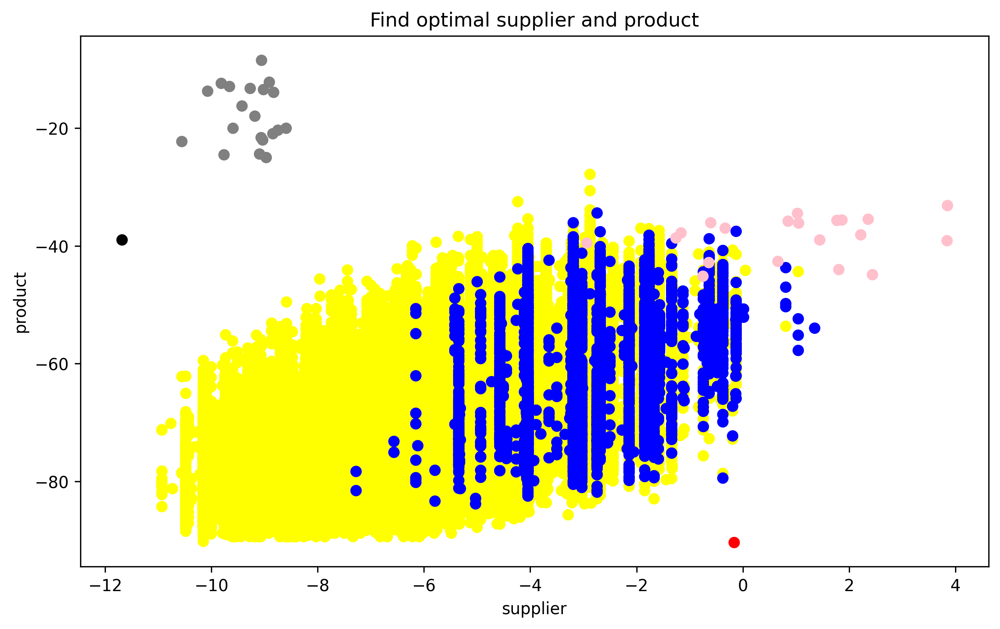

In [83]:
figure(figsize=(10, 6), dpi=300)
plt.scatter(dwave_plot_sup3,dwave_plot_prod3,color='yellow')
plt.scatter(dwave_plot_sup4,dwave_plot_prod4,color='blue')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')


# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()

In [86]:
S=10
I=1
global_score=[]
for i in range(len(save_sup_energy)):
    global_score.append(S*save_sup_energy[i]*I*save_item_energy[i])
    
index=np.argsort(global_score)
print(index,global_score[index[-1]])
print('supplier',save_sup_energy[index[-1]])
print(save_sup_list[index[-1]])
print('product',save_item_energy[index[-1]])
print(save_item_list[index[-1]])

[4408 4701 4521 ...   83   65   87] 5934.441512999961
supplier -7.280629999999997
[0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
product -81.5099999999995
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]


In [87]:
ef_sup_energy=[]
ef_item_energy=[]
N=20
n=0
for i in reversed(index):
    if n<N:
        print(global_score[i])
        print(' supplier',save_sup_energy[i])
        print('',save_sup_list[i])
        print(' product',save_item_energy[i])
        print('',save_item_list[i])
        ef_sup_energy.append(save_sup_energy[i])
        ef_item_energy.append(save_item_energy[i])
    
    n+=1
    

5934.441512999961
 supplier -7.280629999999997
 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
 product -81.5099999999995
 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
5700.733289999959
 supplier -7.280629999999997
 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
 product -78.29999999999947
 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
4936.406439999969
 supplier -6.1589599999999995
 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
 product -80.1499999999995
 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 76, 77,

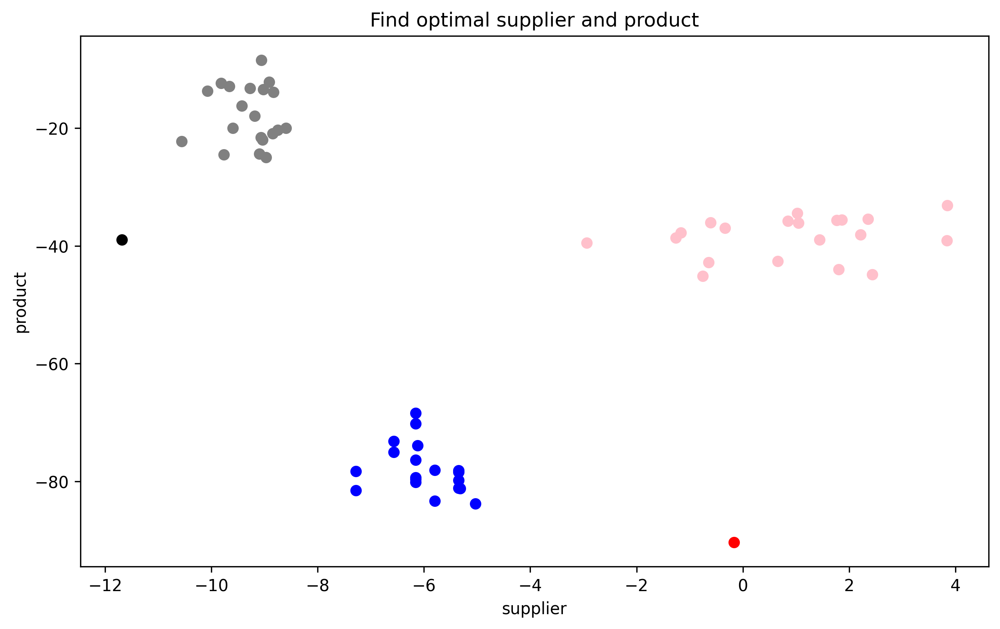

In [89]:
figure(figsize=(10, 6), dpi=300)
plt.scatter(ef_sup_energy,ef_item_energy,color='blue')

# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')


# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()